# PYMC vs traditional machine learning models for MMM

This notebook highlights how MMM can be built leveraging different modelling approaches. 

Its purpose is to show the benefits how probabilistic (bayesian) over frequencist models especially when you have some knowledge domain that you want to leverage and you start facing more complex data patterns.

The notebook is inspired from: 
  * [Juan Orduz](https://juanitorduz.github.io/)'s blog post: ["Media Effect Estimation with PyMC: Adstock, Saturation & Diminishing Returns"](https://juanitorduz.github.io/pymc_mmm/)
  * Slava Kisilevich's blog post: [Improving Marketing Mix Modeling Using Machine Learning Approaches](https://towardsdatascience.com/improving-marketing-mix-modeling-using-machine-learning-approaches-25ea4cd6994b/)
  * Anurag Pandey's article: [Explainable AI: Application of Shapely Values in Marketing Analytics](https://www.topbots.com/explainable-ai-marketing-analytics/)



Synthetic data generation is available through MMMDataGenerator class. It makes parameter recovery possible to assess modelling. 

In [ ]:
import numpy as np
import pandas as pd
import pytensor.tensor as pt
from pymc_marketing.mmm.transformers import geometric_adstock, logistic_saturation
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import shap
import optuna
from sklearn.preprocessing import StandardScaler, MaxAbsScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.model_selection import TimeSeriesSplit
from traditional_models import *
import pymc as pm
import arviz as az
import warnings
from pymc_marketing.prior import Prior
from matplotlib.ticker import FuncFormatter



import sys
import os
os.chdir('..')

from data_generator import MMMDataGenerator
from data_visualizer import MMMVisualizer
from utils import (approx_hsgp_hyperparams,
                    nrmse,
                    rssd,
                    calculate_spend_effect_share,
                    plot_spend_vs_effect_share,
                    plot_shap_vs_spend,
                    shap_feature_importance,
                    visualize_roas,
                    compare_all_models_roas
                    )




warnings.filterwarnings('ignore', category=UserWarning)
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "retina"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Synthethic Data Generation

In [124]:
countries = ['US'] # We generate data for several countries with different sparcity patterns but let's keep it simple in this article
channels = ['TV', 'Digital'] # 2 channels with different patterns.
n_dates = 53*4 # About 4 year data

# Generate data
generator = MMMDataGenerator(seed=42) # seed parameter to make data reproductible

# Let run generate_dataset method!
dataset, global_params, country_params = generator.generate_dataset(
    n_dates=n_dates,
    countries=countries,
    channels=channels)


In [125]:
dataset, global_params, country_params, _ = generator.generate_dataset_with_dynamics(n_dates=n_dates,
    countries=countries,
    channels=channels,
    apply_dynamic_effects=False # Variable that add time varying coefficients for media effects
    )

## Visualization

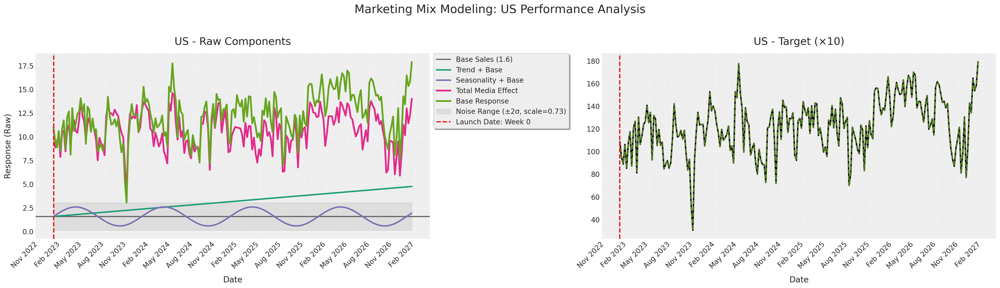

In [126]:
visualizer = MMMVisualizer()

components_basic = {
    'base_sales': True,
    'trend': True,
    'seasonality': True,
    'individual_channels': False,
    'total_media': True,
    'base_response': True,
    'noise_line': False,
    'noise_range': True,
    'target': True,
    'scaled_base': True,
    'promo_effects': False
}
fig = visualizer.plot_contributions(dataset, country_params, countries, components_basic)

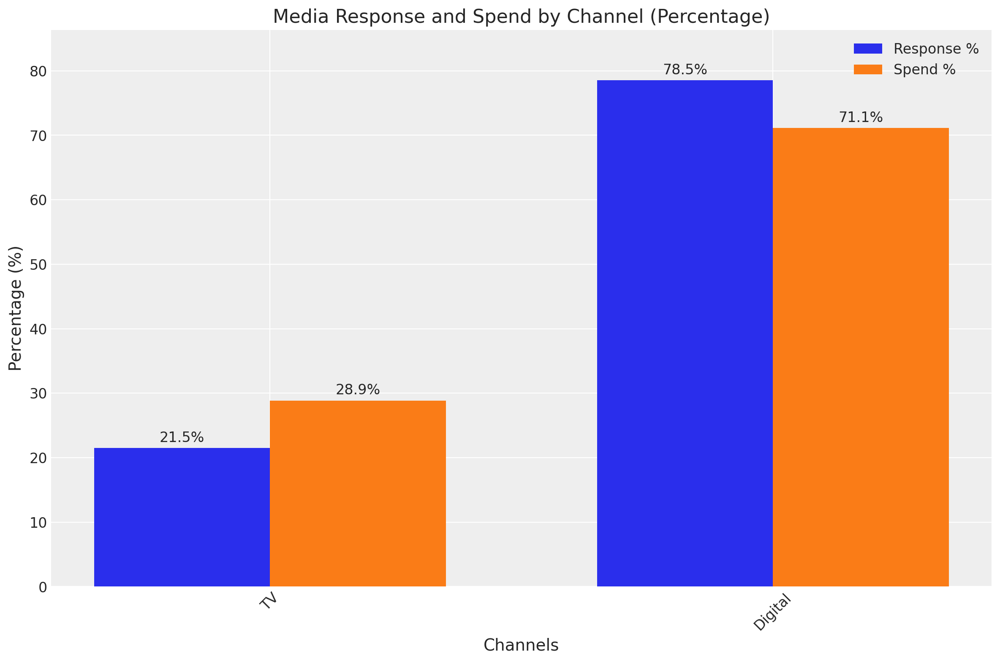

In [127]:
test_size=50

# Extract your data
values = dataset.media_response.sel(country=countries)[0][-test_size:].sum(axis=0)
costs = dataset.spends.sel(country=countries)[0][-test_size:].sum(axis=0)

# Convert to percentages
values_percent = (values / values.sum()) * 100
costs_percent = (costs / costs.sum()) * 100

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Set width of bars
bar_width = 0.35
index = np.arange(len(channels))

# Create the bars
bar1 = ax.bar(index - bar_width/2, values_percent, bar_width, label='Response %')
bar2 = ax.bar(index + bar_width/2, costs_percent, bar_width, label='Spend %')

# Add labels, title and legend
ax.set_xlabel('Channels')
ax.set_ylabel('Percentage (%)')
ax.set_title('Media Response and Spend by Channel (Percentage)')
ax.set_xticks(index)
ax.set_xticklabels(channels, rotation=45)
ax.legend()

# Add percentage labels on top of each bar
for bar in bar1:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.1f}%', ha='center', va='bottom')

for bar in bar2:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.1f}%', ha='center', va='bottom')

# Set y-axis to go from 0 to a reasonable maximum
max_percent = max(values_percent.max(), costs_percent.max())
ax.set_ylim(0, max_percent * 1.1)  # Add 10% padding at the top

# Adjust layout
plt.tight_layout()
plt.show()


## Very Basic EDA

By checking the right chart, we may notice: 
  * a positive trend
  * some seasonality with spikes around Feb-May and low momemtum between Aug-Nov 

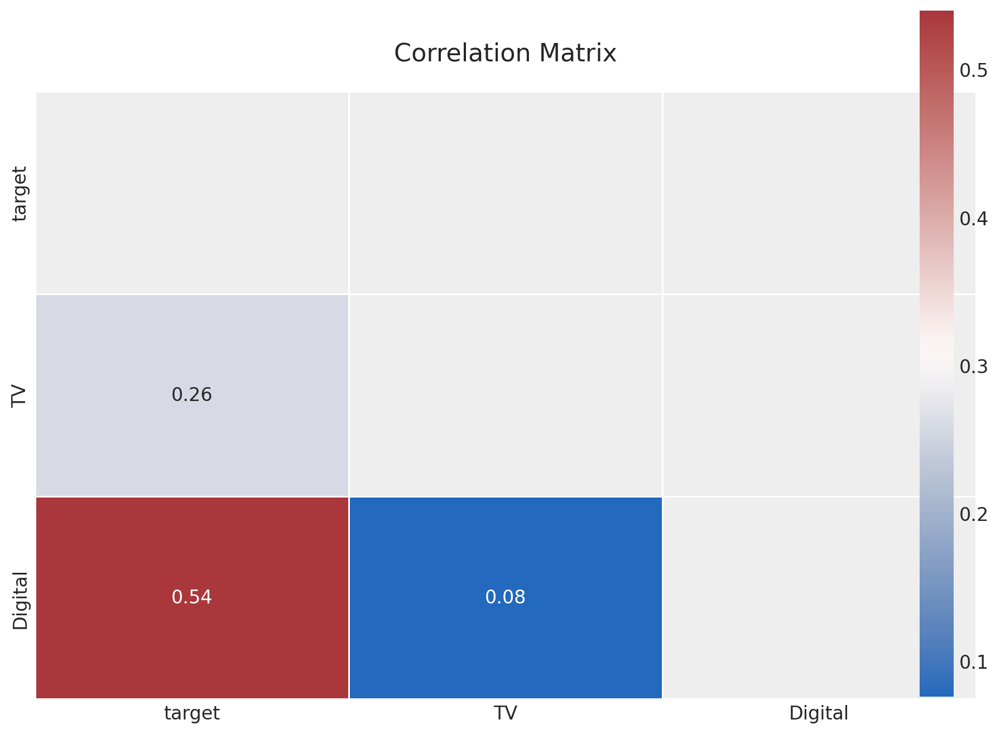

In [128]:
target = pd.DataFrame({"target": dataset.target.sel(country=countries).to_numpy().flatten()})
spends_array = dataset.spends.sel(country=countries).to_numpy().reshape(-1, 2)
spends = pd.DataFrame(spends_array, columns=channels)

# Combine for correlation matrix
combined = pd.concat([target, spends], axis=1)

plt.figure(figsize=(10, 8))
mask = np.triu(np.ones_like(combined.corr(), dtype=bool))  # Create mask for upper triangle
sns.heatmap(
    combined.corr(),
    annot=True,
    fmt=".2f",
    cmap="vlag",
    mask=mask,
    linewidths=0.5,
    cbar_kws={"shrink": .8}
)
plt.title('Correlation Matrix', fontsize=16, pad=20)
plt.tight_layout()
plt.show()

We see a weak correlation between digital spend and target and low correlation between channels

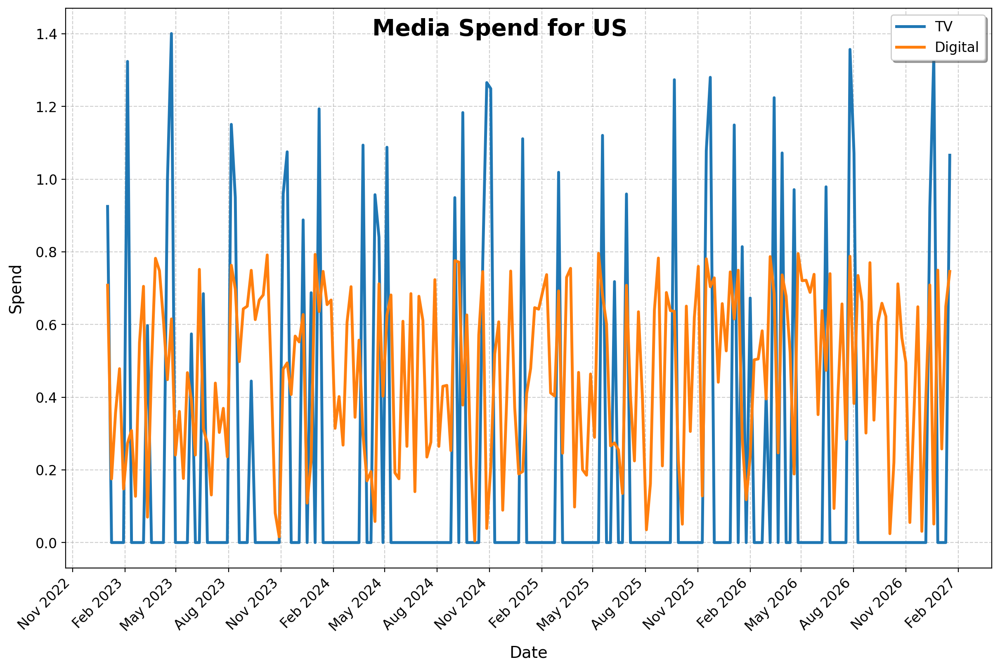

In [7]:
fig = visualizer.plot_media_spend(dataset, countries)


### Media effect visualization

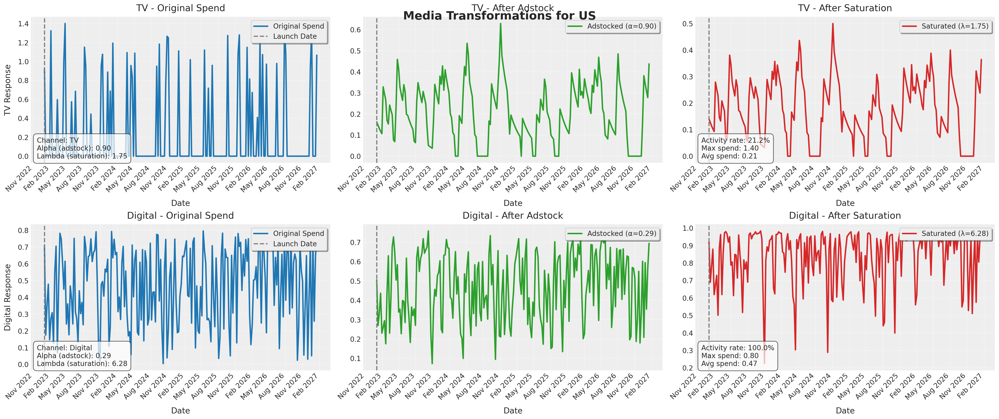

In [129]:
fig_2 = visualizer.plot_media_transformations(dataset, country_params, countries)

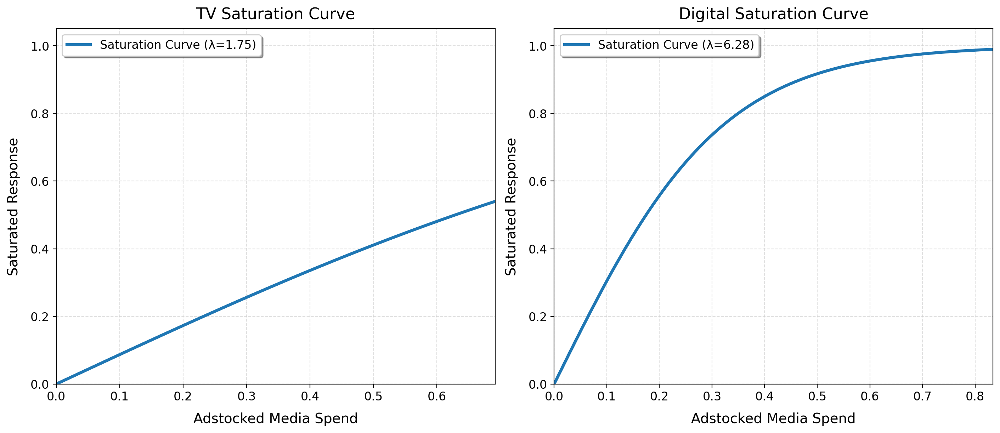

In [9]:
fig_2 = visualizer.plot_saturation_curves(
    dataset,
    country_params,
    countries=countries,
    show_raw_data=False
)

In [130]:
# Compute ROAS on training set
roas_results = visualizer.calculate_simple_roas(
    dataset=dataset,
    countries=countries,
    channels=channels,
    time_constraint=dataset.sel(date=dataset.coords['date'].values[:-test_size]).date.values
)

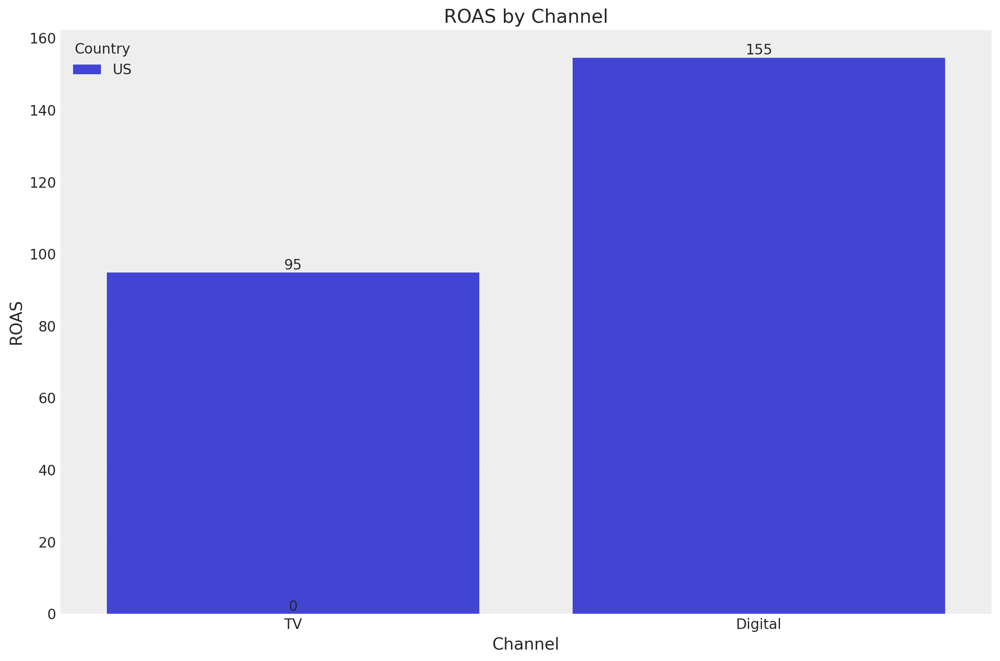

In [131]:
# Visualize results
fig = visualize_roas(
    roas_results,
    plot_type='bar'
)

This is unobserved data but it helps understand the true concepts of carryover and channel saturation as explained in the following paper [Jin, Yuxue, et al. “Bayesian methods for media mix modeling with carryover and shape effects.” (2017)](https://research.google/pubs/pub46001/)

## Media transformation functions

In [12]:
def geometric_adstock(x, alpha, l_max, normalize):
    """Vectorized geometric adstock transformation."""
    # Make sure x is treated as a vector if it's 1D
    x = pt.as_tensor_variable(x)

    # Create shifted versions of x
    cycles = [
        pt.concatenate(tensor_list=[pt.zeros(shape=x.shape)[:i], x[: x.shape[0] - i]])
        for i in range(l_max)
    ]

    # Stack the cycles into a single tensor
    x_cycle = pt.stack(cycles)

    # For 1D input, the shape is now (l_max, len(x))
    if x.ndim == 1:  # If x is a vector
        x_cycle = pt.transpose(x_cycle, axes=[1, 0])

        # Create decay weights
        w = pt.as_tensor_variable([pt.power(alpha, i) for i in range(l_max)])

        # Reshape for broadcasting
        w = w.reshape([1, l_max])

        if normalize:
            w = w / pt.sum(w, axis=1, keepdims=True)

        # Sum along the last dimension (axis=1)
        return pt.sum(x_cycle * w, axis=1)

    else:
        # We want (x.shape[0], x.shape[1], l_max)
        x_cycle = pt.transpose(x_cycle, axes=[1, 2, 0])

        # Create decay weights
        w = pt.as_tensor_variable([pt.power(alpha, i) for i in range(l_max)])

        # Reshape for broadcasting
        w = w.reshape([1, 1, l_max])

        if normalize:
            # Normalize the weights
            w = w / pt.sum(w, axis=2, keepdims=True)

        # Sum along the last dimension (axis=2)
        return pt.sum(x_cycle * w, axis=2)



def logistic_saturation(x, lam):
    """Logistic saturation transformation."""
    return (1 - pt.exp(-lam * x)) / (1 + pt.exp(-lam * x))

### Adstock function

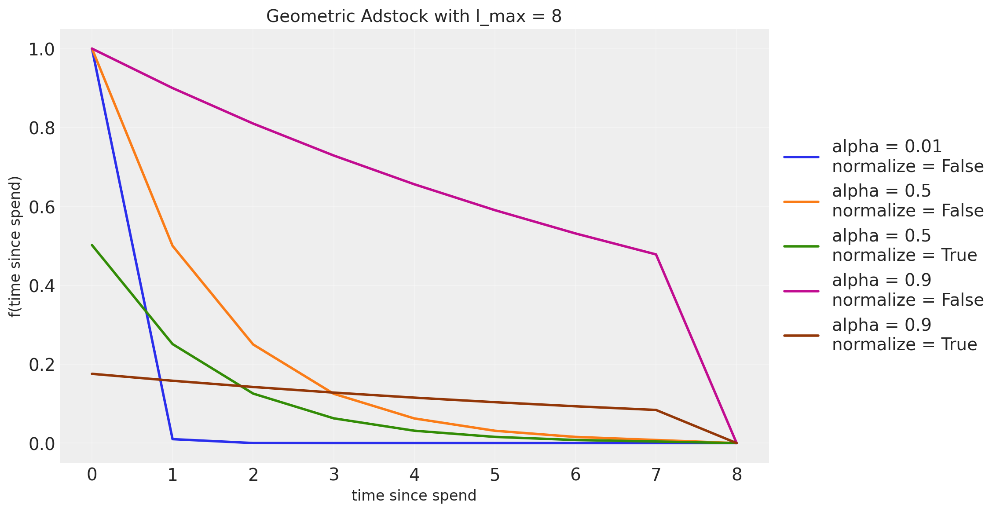

In [13]:
# Set up the plot style
plt.style.use('arviz-darkgrid')
plt.figure(figsize=(10, 6))

# Create a spike input (impulse) to see the decay pattern
# This simulates a single advertising event at time 0
t_max = 8
x = np.zeros(t_max + 1)
x[0] = 1.0  # Single unit of spend at time 0

# Try different alpha values
alphas = [0.01, 0.5, 0.9]
normalize_options = [False, True]

# Plot each combination
for alpha in alphas:
    for normalize in normalize_options:
        # Skip some combinations to avoid too many lines
        if alpha == 0.01 and normalize:
            continue

        # Apply geometric adstock to the impulse
        y = geometric_adstock(x, alpha=alpha, l_max=t_max, normalize=normalize)

        # Create label with parameter values
        label = f"alpha = {alpha}\nnormalize = {normalize}"

        # Plot the decay curve
        plt.plot(range(t_max +1), y.eval(), linewidth=2, label=label)

# Add labels and title
plt.xlabel('time since spend', fontsize=12)
plt.ylabel('f(time since spend)', fontsize=12)
plt.title(f'Geometric Adstock with l_max = {t_max}', fontsize=14)

# Adjust legend position
ax = plt.gca()
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

We see that:
* **Alpha parameter effect:** The bigger the alpha value, the bigger the carryover effect
  * α = 0.01: Effects disappear almost immediately
  * α = 0.5: Effects persist for a moderate amount of time
  * α = 0.9: Effects persist for a long time
* **Normalize parameter effect:** When normalize is set to True:
  * The curves are scaled so the area under the curve equals 1
  * This creates a less dramatic initial descent compared to non-normalized curves
  * Normalization makes it easier to compare relative shapes of different alpha values

### Saturation function

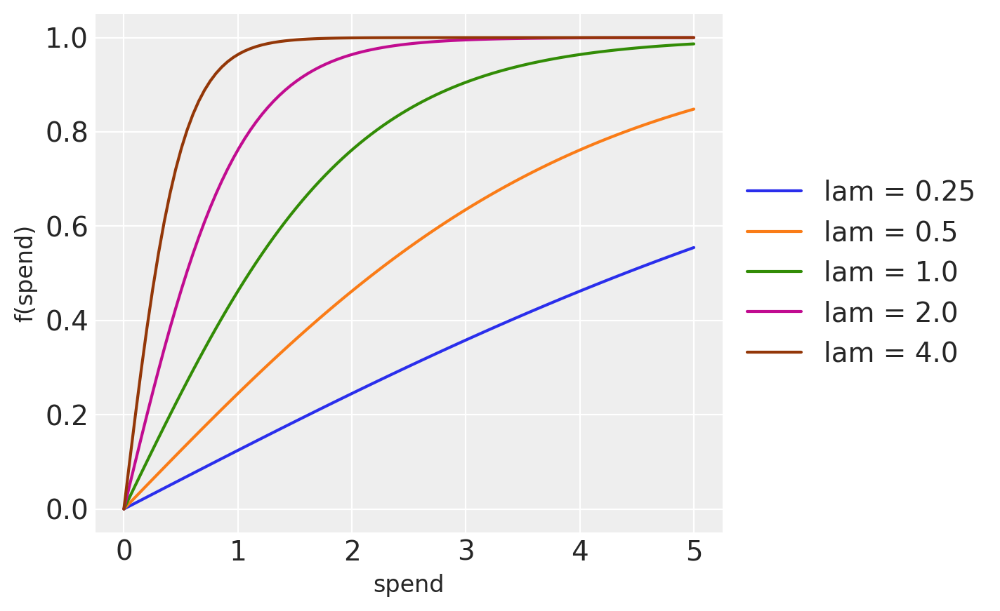

In [14]:
plt.style.use('arviz-darkgrid')
lam = np.array([0.25, 0.5, 1, 2, 4])
x = np.linspace(0, 5, 100)
ax = plt.subplot(111)
for l in lam:
    y = logistic_saturation(x, lam=l).eval()
    plt.plot(x, y, label=f'lam = {l}')
plt.xlabel('spend', fontsize=12)
plt.ylabel('f(spend)', fontsize=12)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()



We see that:
* **Lambda parameter effect:** The lambda value controls the saturation rate
  * λ = 0.5: Very gradual saturation (almost linear for small input values)
  * λ = 2.0: Moderate saturation effect with diminishing returns beginning earlier
  * λ = 4.0: Aggressive saturation with strong diminishing returns at lower spend levels
* **Key characteristics:**
  * The function is monotonically increasing (more input always yields more output)
  * As input increases, the marginal effect decreases (diminishing returns)
  * Higher lambda values cause the curve to "bend" more quickly, indicating earlier diminishing returns
  * The function approaches an asymptotic maximum value as input increases
* **Marketing interpretation:**
  * Captures the concept that there is a limit to advertising effectiveness
  * Reflects how additional media spending yields less incremental response after a certain point
  * Can be used to identify the "efficient frontier" of advertising spend

## Modelling

We want to compare two modelling techniques trying to fit the sales pattern in the US: 
  * a **traditional frequencist models** (GBM, linear regression and ensemble) 
  * a **bayesian model** (pymc)
    
For both models, we assume: 
  * there is a positive trend 
  * there is first an adstock transformation and then a saturation transformation applied to the media spends. However, we don't know the parameters. This is what we are trying to estimate. 
  * there is a seasonality with an order 2 (we estimate 2 cycles max per year)

## Dataset prep

In [15]:
# Media features
media_columns = ["TV_spend", "Digital_spend"]
spend_df = pd.DataFrame(dataset.sel(country="US").spends, columns=media_columns)

# Trend features
trend = pd.DataFrame({"trend": np.arange(0, len(spend_df)) })


In [16]:
# Fourier features
n_order = 2
periods = dataset.date.dt.dayofyear / 365.25
fourier_features = pd.DataFrame(
    {
        f"{func}_order_{order}": getattr(np, func)(2 * np.pi * periods * order)
        for order in range(1, n_order + 1)
        for func in ("sin", "cos")
    }
)

## Train test split

In [ ]:
def run_mmm_analysis(X, y, media_columns, alpha_ranges, lambda_ranges, is_multiobjective, test_size,
                    n_trials=5, models_to_include=None):
    """
    Run a complete MMM analysis with all components from the article, comparing selected models

    Parameters:
    -----------
    X : DataFrame
        Feature data
    y : Series
        Target data
    media_columns : list
        List of media columns to analyze
    alpha_ranges : dict
        Ranges for adstock parameters
    lambda_ranges : dict
        Ranges for lambda parameters if applied
    is_multiobjective : bool
        Whether to use multi-objective optimization
    test_size : int
        Size of test set
    n_trials : int
        Number of optimization trials
    models_to_include : list, optional
        List of models to include in analysis. Options are:
        - 'linear': Linear Regression model
        - 'linear_sat': Linear Regression with saturation
        - 'gb': Gradient Boosting model
        - 'ensemble': Ensemble model
        If None, all models will be included.
    """
    print("Starting MMM Analysis...\n")

    # Define which models to include
    if models_to_include is None:
        # Include all models by default
        models_to_include = ['linear', 'linear_sat', 'gb', 'ensemble']

    # Validate models to include
    valid_models = ['linear', 'linear_sat', 'gb', 'ensemble']
    for model in models_to_include:
        if model not in valid_models:
            raise ValueError(f"Invalid model '{model}'. Valid options are: {valid_models}")

    # Split data for evaluation
    train_indices = list(range(len(X) - test_size))
    test_indices = list(range(len(X) - test_size, len(X)))

    # For optimization, use only the training data
    X_train = X.iloc[train_indices]
    y_train = y.iloc[train_indices]
    y_test = y.iloc[test_indices]

    # 1. Run models based on user selection
    print("1. Training selected models for comparison...")

    models_dict = {}
    studies_dict = {}

    # Train LinearRegression model
    if 'linear' in models_to_include:
        print("  Training Linear Regression model...")
        model_lr = MMM_Linear(alpha_ranges=alpha_ranges, lambda_ranges=lambda_ranges, l_max=8, apply_saturation=False)
        study_lr = model_lr.optimize(
            X=X_train,
            y=y_train,
            media_cols=media_columns,
            n_trials=n_trials,
            cv_splits=5,
            test_size=20,
            is_multiobjective=is_multiobjective
        )
        model_lr.fit(X_full=X, y_train=y_train, train_indices=train_indices, media_cols=media_columns)
        models_dict["Linear Regression"] = model_lr
        studies_dict["linear_regression"] = study_lr

    # Train LinearRegression model with saturation
    if 'linear_sat' in models_to_include:
        print("  Training Linear Regression model with saturation transformation...")
        model_lr_with_sat = MMM_Linear(alpha_ranges=alpha_ranges, lambda_ranges=lambda_ranges, l_max=8, apply_saturation=True)
        study_lr_with_sat = model_lr_with_sat.optimize(
            X=X_train,
            y=y_train,
            media_cols=media_columns,
            n_trials=n_trials,
            cv_splits=5,
            test_size=20,
            is_multiobjective=is_multiobjective
        )
        model_lr_with_sat.fit(X_full=X, y_train=y_train, train_indices=train_indices, media_cols=media_columns)
        models_dict["Linear Regression With Saturation"] = model_lr_with_sat
        studies_dict["linear_regression_with_sat"] = study_lr_with_sat

    # Train GradientBoosting model
    if 'gb' in models_to_include:
        print("  Training Gradient Boosting model...")
        model_gb = MMM_TreeBased(alpha_ranges=alpha_ranges, l_max=8, model_type='gb')
        study_gb = model_gb.optimize(
            X=X_train,
            y=y_train,
            media_cols=media_columns,
            n_trials=n_trials,
            cv_splits=5,
            test_size=20,
            is_multiobjective=is_multiobjective
        )
        model_gb.fit(X_full=X, y_train=y_train, train_indices=train_indices, media_cols=media_columns)
        models_dict["Gradient Boosting"] = model_gb
        studies_dict["gradient_boosting"] = study_gb

    # Train Ensemble model
    if 'ensemble' in models_to_include:
        print("  Training Ensemble model...")
        model_ensemble = MMM_EnsembleBased(alpha_ranges=alpha_ranges, l_max=8)
        study_ensemble = model_ensemble.optimize(
            X=X_train,
            y=y_train,
            media_cols=media_columns,
            n_trials=n_trials,
            cv_splits=5,
            test_size=20,
            is_multiobjective=is_multiobjective
        )
        model_ensemble.fit(X_full=X, y_train=y_train, train_indices=train_indices, media_cols=media_columns)
        models_dict["Ensemble"] = model_ensemble
        studies_dict["ensemble"] = study_ensemble

    # Skip further processing if no models were selected
    if not models_dict:
        print("No models were selected for analysis. Exiting.")
        return None

    # 2. Evaluate models
    print("\n2. Evaluating models...")

    results = {}

    for name, model in models_dict.items():
        preds = model.predict(test_indices=test_indices)
        # Basic metrics
        rmse = np.sqrt(mean_squared_error(y_test, preds))
        r2 = r2_score(y_test, preds)
        mape = mean_absolute_percentage_error(y_test, preds)
        nrmse_val = nrmse(y_test, preds)

        print(f"  {name} Results:")
        print(f"    RMSE:  {rmse:.2f}")
        print(f"    R²:    {r2:.4f}")
        print(f"    MAPE:  {mape:.4f}")
        print(f"    NRMSE: {nrmse_val:.4f}")

        results[name] = {
            "model": model,
            "predictions": preds,
            "rmse": rmse,
            "r2": r2,
            "mape": mape,
            "nrmse": nrmse_val
        }

    # 3. Plot predictions
    print("\n3. Plotting predictions vs actual...")
    plt.figure(figsize=(15, 8))
    plt.plot(range(len(y_test)), y_test, 'k-', linewidth=2, label='Actual')

    colors = ['b', 'g', 'r', 'c']  # Blue, green, red, cyan
    styles = ['-', '--', '-.', ':']  # Solid, dashed, dash-dot, dotted

    for i, (name, res) in enumerate(results.items()):
        plt.plot(
            range(len(y_test)),
            res["predictions"],
            f"{colors[i % len(colors)]}{styles[i % len(styles)]}",  # Use modulo to handle more than 4 models
            linewidth=2,
            label=f'{name} (R²={res["r2"]:.4f})'
        )

    plt.title('Model Comparison: Predictions vs Actual', fontsize=16)
    plt.xlabel('Time Period', fontsize=14)
    plt.ylabel('Target Value', fontsize=14)
    plt.legend(fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    # 4. SHAP Analysis for all models
    print("\n4. SHAP Analysis for all models...")

    all_shap_values = {}

    for name, model in models_dict.items():
        print(f"\n  Analyzing {name}...")

        # Get appropriate test data
        if model.model_type == 'lr':
            X_test_transformed = model.X_full_transformed.iloc[test_indices]
        else:
            X_test_transformed = model.X_full_adstocked.iloc[test_indices]

        try:
            # Get appropriate model attribute
            if hasattr(model, 'model'):
                model_attr = model.model
            elif hasattr(model, 'tree_model'):
                model_attr = model.tree_model
            else:
                model_attr = model

            # Create explainer based on model type
            if name == "Ensemble":  # Special handling for stacked model
                # Create a wrapper function that combines predictions
                def stacked_predict(X):
                    if isinstance(X, pd.DataFrame):
                        X_df = X
                    else:
                        X_df = pd.DataFrame(X, columns=X_test_transformed.columns)

                    linear_preds = model.linear_model.predict(X_df)
                    tree_preds = model.tree_model.predict(X_df)
                    return linear_preds + tree_preds

                # Use KernelExplainer for the stacked model
                background = shap.sample(X_test_transformed, min(100, len(X_test_transformed)))
                explainer = shap.KernelExplainer(stacked_predict, background)
            elif isinstance(model_attr, (GradientBoostingRegressor, RandomForestRegressor)):
                explainer = shap.TreeExplainer(model_attr)
            else:
                explainer = shap.LinearExplainer(model_attr, X_test_transformed)

            # Get SHAP values
            shap_values = explainer.shap_values(X_test_transformed)

            # Create DataFrame of SHAP values
            df_shap_values = pd.DataFrame(shap_values, columns=X_test_transformed.columns)

            # Store for later
            all_shap_values[name] = {
                "values": df_shap_values,
                "X_test": X_test_transformed
            }

            # Plot SHAP summary for each model
            print(f"  Plotting SHAP Feature Importance for {name}...")

            # Create the feature importance plot manually instead of using the function
            feature_list = X_test_transformed.columns
            shap_v = df_shap_values
            df_v = X_test_transformed.copy().reset_index().drop('index', axis=1)

            # Determine the correlation for color
            corr_list = []
            for i in feature_list:
                b = np.corrcoef(shap_v[i], df_v[i])[1][0]
                corr_list.append(b)
            corr_df = pd.concat([pd.Series(feature_list), pd.Series(corr_list)], axis=1).fillna(0)

            # Make a data frame. Column 1 is the feature, and Column 2 is the correlation coefficient
            corr_df.columns = ['Variable', 'Corr']
            corr_df['Sign'] = np.where(corr_df['Corr'] > 0, 'red', 'blue')

            # Plot it
            shap_abs = np.abs(shap_v)
            k = pd.DataFrame(shap_abs.mean()).reset_index()
            k.columns = ['Variable', 'SHAP_abs']
            k2 = k.merge(corr_df, left_on='Variable', right_on='Variable', how='inner')
            k2 = k2.sort_values(by='SHAP_abs', ascending=True)
            colorlist = k2['Sign']

            plt.figure(figsize=(15, 8))
            ax = k2.plot.barh(x='Variable', y='SHAP_abs', color=colorlist, figsize=(15, 8), legend=False)
            ax.set_xlabel("SHAP Value (Red = Positive Impact)")
            plt.title(f'SHAP Feature Importance - {name}', fontsize=16)
            plt.tight_layout()
            plt.show()

        except Exception as e:
            print(f"  Error in SHAP analysis for {name}: {e}")
            # Create placeholder values
            df_shap_values = pd.DataFrame(0, index=range(len(test_indices)),
                                        columns=X.iloc[test_indices].columns)
            all_shap_values[name] = {
                "values": df_shap_values,
                "X_test": X.iloc[test_indices]
            }

    # 5. SHAP vs Spend Analysis for Media Channels
    print("\n5. SHAP vs Spend Analysis for Media Channels...")

    # X_test_original = X.iloc[test_indices]

    for name, shap_data in all_shap_values.items():
        print(f"\n  Analyzing SHAP vs Spend for {name}...")
        # Get appropriate test data

        plot_shap_vs_spend(
            df_shap_values=shap_data["values"],
            x_input_transformed=shap_data["X_test"],
            media_channels=media_columns,
            figsize=(12, 6),
            fit_lambda=False
        )

    # 6. Compare adstock parameters across models
    print("\n6. Comparing Adstock Parameters Across Models...")

    # Create dictionary for adstock parameters
    adstock_params = {}
    for name, model in models_dict.items():
        adstock_params[name] = model.best_alphas

    # Create a mapping between the model channels and true value channels if they're different
    channel_mapping = {
        "TV_spend": "TV",
        "Digital_spend": "Digital"
    }

    # Get true values if available
    true_values = {}
    if 'country_params' in globals() and "US" in country_params:
        for model_channel, true_channel in channel_mapping.items():
            if true_channel in country_params["US"]["alphas"]:
                true_values[model_channel] = country_params["US"]["alphas"][true_channel]

    # Create a DataFrame with all adstock parameters
    adstock_df = pd.DataFrame(adstock_params)

    print(adstock_df)

    # Plot adstock parameters if we have at least one model
    if adstock_df.shape[1] > 0:
        plt.figure(figsize=(12, 6))

        # Set up colors for each model - assign dynamically based on number of models
        color_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2']  # Add more colors if needed
        colors = color_list[:len(adstock_df.columns)]

        # Create x positions for bars
        x = np.arange(len(adstock_df.index))
        width = 0.2  # Width of the bars
        models = adstock_df.columns

        # Adjust width based on number of models
        if len(models) > 0:
            width = min(0.2, 0.8 / len(models))

        # Plot each model's parameters
        for i, model in enumerate(models):
            values = adstock_df[model].values
            valid_mask = ~np.isnan(values)
            plt.bar(x[valid_mask] + i*width - (len(models)-1)*width/2,
                    values[valid_mask], width, label=model, color=colors[i])

        # Get existing legend entries
        legend_handles, legend_labels = plt.gca().get_legend_handles_labels()

        # Add labels and formatting
        plt.title('Adstock Parameters Comparison', fontsize=18)
        plt.xlabel('Media Channel', fontsize=14)
        plt.ylabel('Alpha Value', fontsize=14)
        plt.xticks(x, adstock_df.index, rotation=45)
        plt.ylim(0, max(adstock_df.max().max() * 1.1, 0.1))  # Ensure there's always some space visible

        # Use the legend for model bars only
        plt.legend(legend_handles, legend_labels, fontsize=12)

        # Add a text box with true values in the top left corner
        if true_values:
            true_value_text = "True Values:\n"
            for channel, value in true_values.items():
                if channel in adstock_df.index:
                    true_value_text += f"{channel}: {value:.2f}\n"

            # Remove the last newline
            true_value_text = true_value_text.rstrip('\n')

            # Add the text box
            plt.text(0.02, 0.98, true_value_text,
                    transform=plt.gca().transAxes,
                    fontsize=12,
                    verticalalignment='top',
                    bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
        plt.grid(axis='y', alpha=0.3, linestyle='--')

        # Add value labels
        for i, model in enumerate(models):
            values = adstock_df[model].values
            for j, v in enumerate(values):
                if not np.isnan(v):
                    plt.text(j + i*width - (len(models)-1)*width/2,
                            v + 0.01,
                            f"{v:.2f}",
                            ha='center', fontsize=9)

        plt.tight_layout()
        plt.show()

    # Package the results
    results_dict = {
        "models": models_dict,
        "studies": studies_dict,
        "results": results,
        "shap_values": all_shap_values,
        "adstock_params": adstock_df
    }

    # 7. Compare ROAS estimates across models
    if len(models_dict) > 0:
        test_roas_results = compare_all_models_roas(
            results=results_dict,
            X=X,
            media_columns=media_columns,
            data_indices=X.index[:-test_size],
            data_type='train',
            verbose=True
        )

    print("\nMMM Analysis Complete!")

    return results_dict

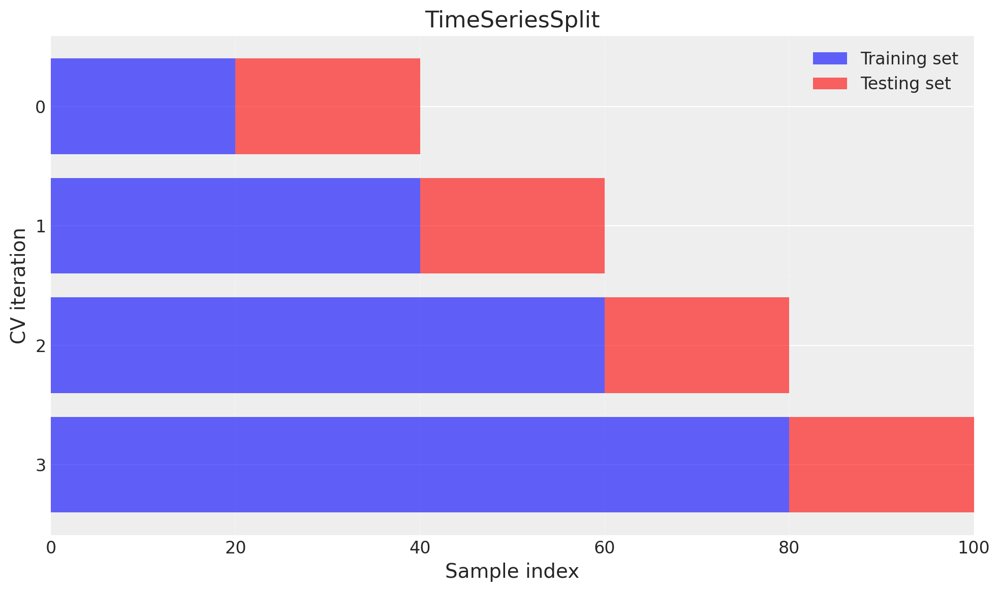

In [ ]:
# Create sample data (100 data points)
X = np.arange(100).reshape(-1, 1)

# Initialize TimeSeriesSplit with 4 splits
tscv = TimeSeriesSplit(n_splits=4, test_size=20)

# Create figure
fig, ax = plt.subplots(figsize=(10, 6))

# Colors
train_color = 'blue'
test_color = 'red'

# Get all splits first to determine their positions
splits = list(tscv.split(X))

# Plot the splits in reverse order to match the screenshot
for i, (train_index, test_index) in enumerate(reversed(splits)):
    # Calculate position (from bottom to top)
    pos = i

    # Plot the training indices
    ax.barh(y=pos, width=len(train_index), left=0, height=0.8,
            color=train_color, alpha=0.6, label='Training set' if i == 0 else "")

    # Plot the testing indices
    ax.barh(y=pos, width=len(test_index), left=train_index[-1] + 1, height=0.8,
            color=test_color, alpha=0.6, label='Testing set' if i == 0 else "")

# Add custom tick positions and labels
tick_positions = np.arange(len(splits))
tick_labels = [str(3-i) for i in range(len(splits))]  # Counting down from 3 to 0

# Set ticks and labels
ax.set_yticks(tick_positions)
ax.set_yticklabels(tick_labels)

# Customize plot
ax.set_xlabel('Sample index')
ax.set_ylabel('CV iteration')
ax.set_title('TimeSeriesSplit')

# Add legend with better position
ax.legend(loc='upper right')

# Set x-axis limit to match data size
ax.set_xlim(0, 100)

# Add grid for better readability
ax.grid(True, axis='x', linestyle='--', alpha=0.3)

# Show plot
plt.tight_layout()
plt.show()

[I 2025-03-19 10:00:28,966] A new study created in memory with name: no-name-23a36039-1cff-4668-9390-ca91ac0ab0a6


Starting MMM Analysis...

1. Training models for comparison...
  Training Linear Regression model...


[I 2025-03-19 10:00:39,406] Trial 0 finished with value: 13.994633628387717 and parameters: {'alpha_TV_spend': 0.4555658242417589, 'alpha_Digital_spend': 0.3026701722988543, 'linear_alpha': 0.36244843433906576}. Best is trial 0 with value: 13.994633628387717.
[I 2025-03-19 10:00:50,181] Trial 1 finished with value: 14.088532222507434 and parameters: {'alpha_TV_spend': 0.5020197456643718, 'alpha_Digital_spend': 0.4213570389267332, 'linear_alpha': 0.05197226935980653}. Best is trial 0 with value: 13.994633628387717.
[I 2025-03-19 10:00:58,867] Trial 2 finished with value: 13.875133069131504 and parameters: {'alpha_TV_spend': 0.4697891803029538, 'alpha_Digital_spend': 0.22573718274397075, 'linear_alpha': 0.6035544120148097}. Best is trial 2 with value: 13.875133069131504.
[I 2025-03-19 10:01:08,164] Trial 3 finished with value: 14.688365259752615 and parameters: {'alpha_TV_spend': 0.3541100579614383, 'alpha_Digital_spend': 0.1294504549027773, 'linear_alpha': 0.2928712201430155}. Best is t

  Training Linear Regression model with saturation transformation...


[I 2025-03-19 10:08:34,921] Trial 0 finished with value: 15.928969717312393 and parameters: {'alpha_TV_spend': 0.4835784622118005, 'lambda_TV_spend': 6, 'alpha_Digital_spend': 0.48294162017832, 'lambda_Digital_spend': 2, 'linear_alpha': 3.4011930657545766}. Best is trial 0 with value: 15.928969717312393.
[I 2025-03-19 10:08:45,028] Trial 1 finished with value: 13.727421256713288 and parameters: {'alpha_TV_spend': 0.5019723632476154, 'lambda_TV_spend': 10, 'alpha_Digital_spend': 0.1758437268871611, 'lambda_Digital_spend': 1, 'linear_alpha': 0.03638790571446902}. Best is trial 1 with value: 13.727421256713288.
[I 2025-03-19 10:08:54,642] Trial 2 finished with value: 12.548398821218674 and parameters: {'alpha_TV_spend': 0.7452346377034056, 'lambda_TV_spend': 7, 'alpha_Digital_spend': 0.4459476022369316, 'lambda_Digital_spend': 1, 'linear_alpha': 0.0959874455548423}. Best is trial 2 with value: 12.548398821218674.
[I 2025-03-19 10:09:03,022] Trial 3 finished with value: 12.159608100113655 

  Training Gradient Boosting model...


[I 2025-03-19 10:16:47,557] Trial 0 finished with value: 15.825839768552365 and parameters: {'alpha_TV_spend': 0.49002772139778755, 'alpha_Digital_spend': 0.1802274625046129, 'learning_rate': 0.23047673631599155, 'n_estimators': 156, 'max_depth': 4}. Best is trial 0 with value: 15.825839768552365.
[I 2025-03-19 10:16:57,023] Trial 1 finished with value: 13.051505791695366 and parameters: {'alpha_TV_spend': 0.5144174172833664, 'alpha_Digital_spend': 0.4874791278007016, 'learning_rate': 0.10267063998376436, 'n_estimators': 81, 'max_depth': 2}. Best is trial 1 with value: 13.051505791695366.
[I 2025-03-19 10:17:06,854] Trial 2 finished with value: 16.265508062075007 and parameters: {'alpha_TV_spend': 0.7418445365635535, 'alpha_Digital_spend': 0.3128969281605717, 'learning_rate': 0.14235269502726514, 'n_estimators': 300, 'max_depth': 5}. Best is trial 1 with value: 13.051505791695366.
[I 2025-03-19 10:17:17,519] Trial 3 finished with value: 17.049204384726014 and parameters: {'alpha_TV_spe

  Training Ensemble model...


[I 2025-03-19 10:25:29,771] Trial 0 finished with value: 13.713581050890934 and parameters: {'alpha_TV_spend': 0.35569719416101375, 'alpha_Digital_spend': 0.13788070059314128, 'linear_alpha': 2.8803215287732846, 'n_estimators': 237, 'max_depth': 8, 'min_samples_split': 19, 'min_samples_leaf': 19}. Best is trial 0 with value: 13.713581050890934.
[I 2025-03-19 10:25:42,153] Trial 1 finished with value: 12.738710546617597 and parameters: {'alpha_TV_spend': 0.3972862385114101, 'alpha_Digital_spend': 0.37884822994524964, 'linear_alpha': 0.20937432137573003, 'n_estimators': 270, 'max_depth': 14, 'min_samples_split': 2, 'min_samples_leaf': 8}. Best is trial 1 with value: 12.738710546617597.
[I 2025-03-19 10:25:56,212] Trial 2 finished with value: 11.87539677434846 and parameters: {'alpha_TV_spend': 0.679248515559983, 'alpha_Digital_spend': 0.46722288214323976, 'linear_alpha': 0.011792403993648325, 'n_estimators': 110, 'max_depth': 13, 'min_samples_split': 8, 'min_samples_leaf': 20}. Best is t


2. Evaluating models...
  Linear Regression Results:
    RMSE:  9.40
    R²:    0.8543
    MAPE:  0.0594
    NRMSE: 0.0921
  Linear Regression With Saturation Results:
    RMSE:  7.83
    R²:    0.8988
    MAPE:  0.0503
    NRMSE: 0.0768
  Gradient Boosting Results:
    RMSE:  11.27
    R²:    0.7905
    MAPE:  0.0696
    NRMSE: 0.1105
  Ensemble Results:
    RMSE:  7.56
    R²:    0.9057
    MAPE:  0.0504
    NRMSE: 0.0741

3. Plotting predictions vs actual...


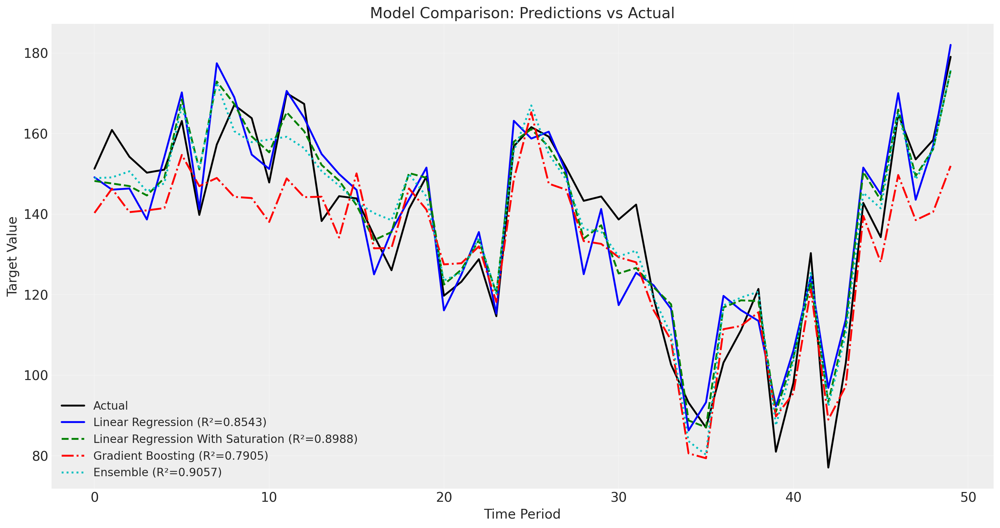


4. SHAP Analysis for all models...

  Analyzing Linear Regression...
  Plotting SHAP Feature Importance for Linear Regression...


<Figure size 1500x800 with 0 Axes>

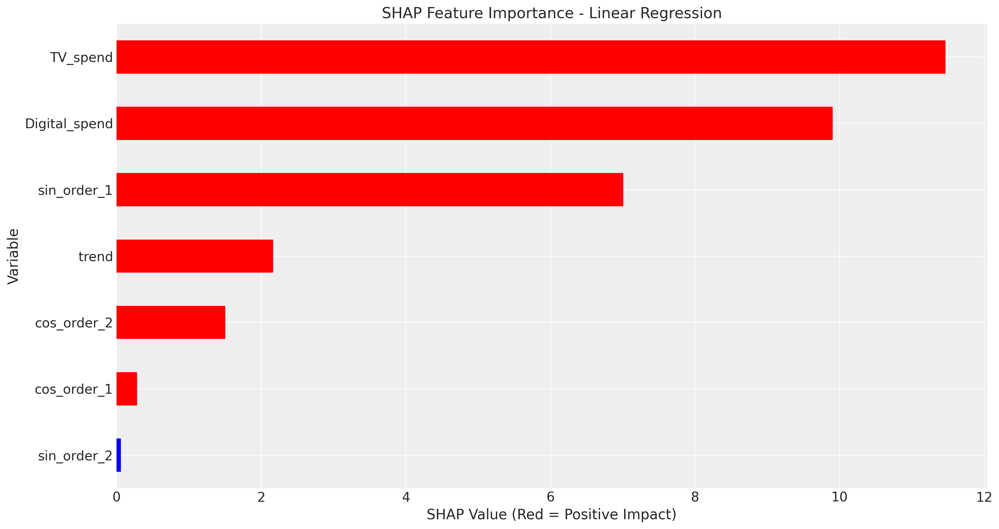


  Analyzing Linear Regression With Saturation...
  Plotting SHAP Feature Importance for Linear Regression With Saturation...


<Figure size 1500x800 with 0 Axes>

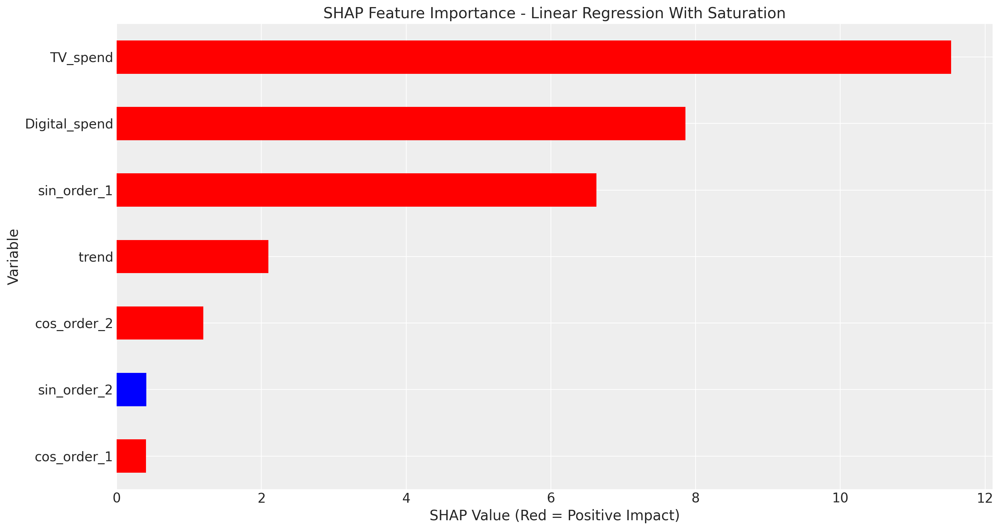


  Analyzing Gradient Boosting...
  Plotting SHAP Feature Importance for Gradient Boosting...


<Figure size 1500x800 with 0 Axes>

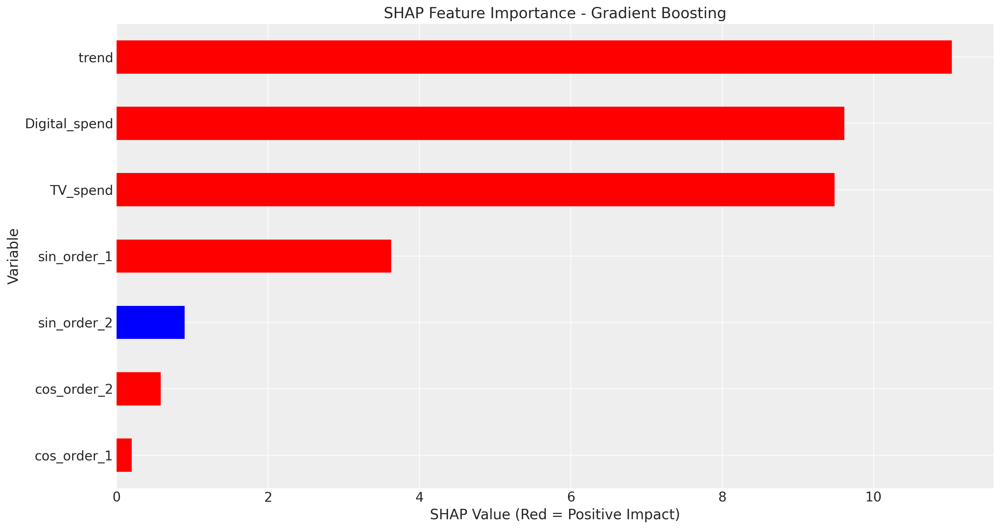


  Analyzing Ensemble...


  0%|          | 0/50 [00:00<?, ?it/s]

  Plotting SHAP Feature Importance for Ensemble...


<Figure size 1500x800 with 0 Axes>

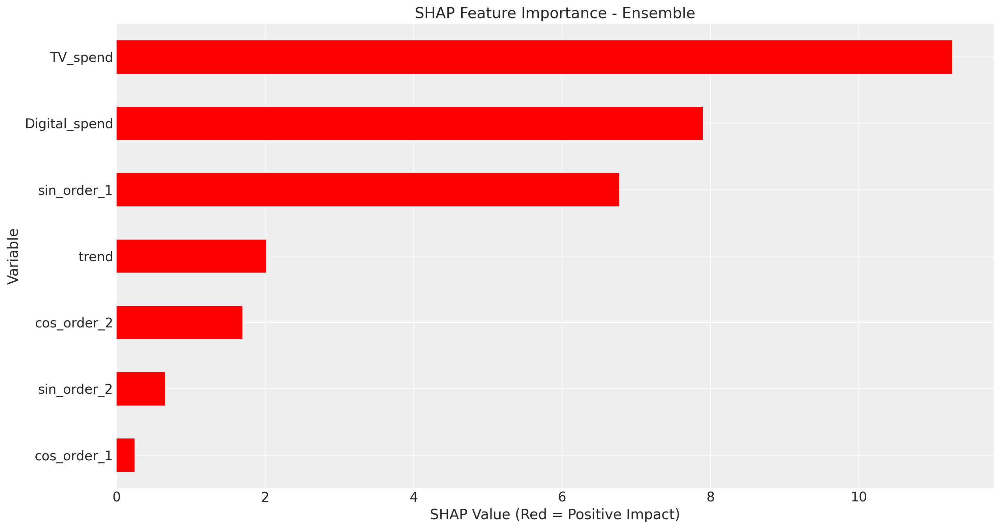


5. SHAP vs Spend Analysis for Media Channels...

  Analyzing SHAP vs Spend for Linear Regression...


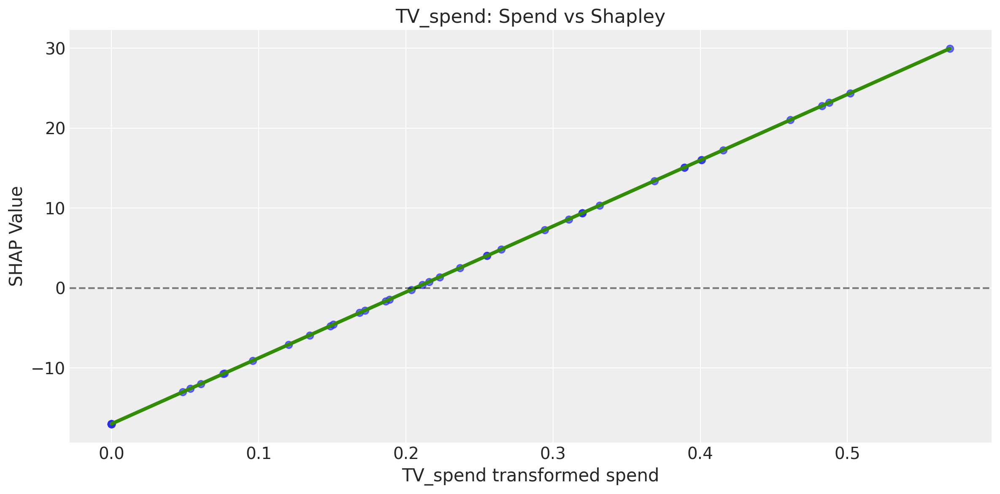

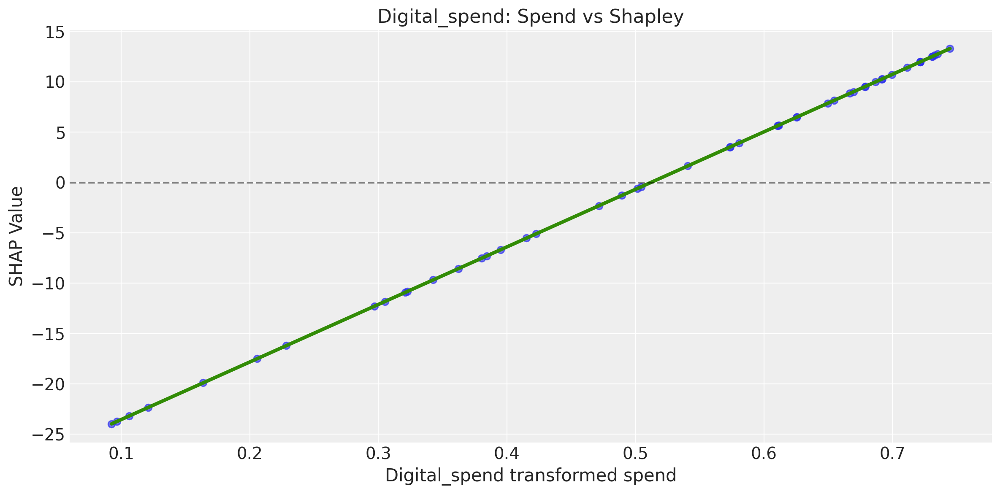


  Analyzing SHAP vs Spend for Linear Regression With Saturation...


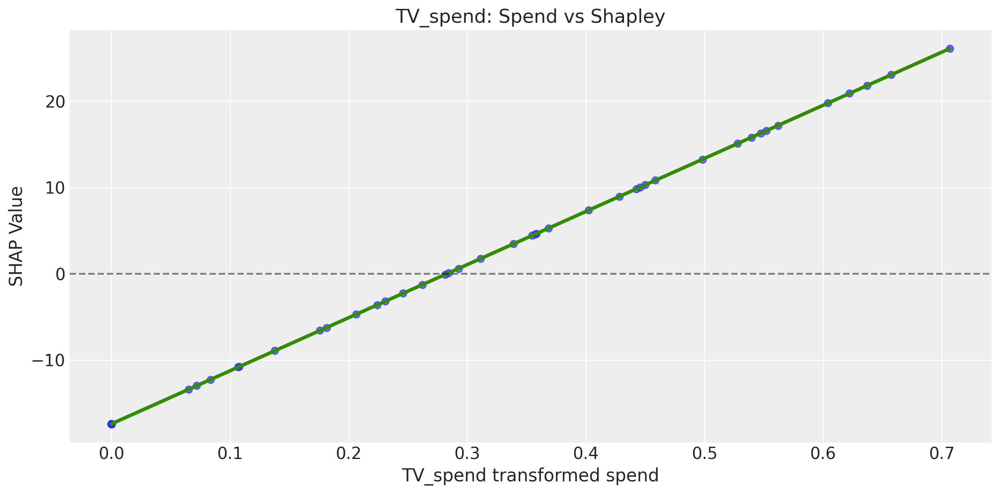

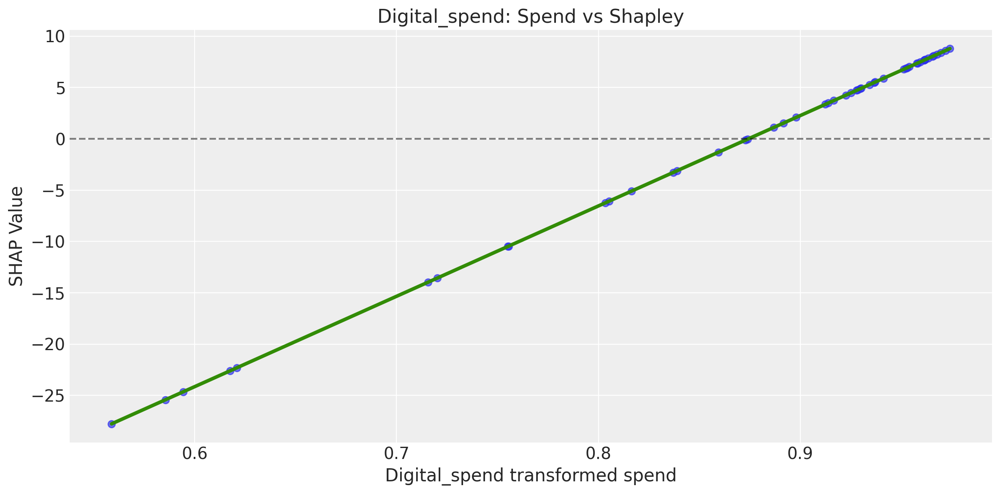


  Analyzing SHAP vs Spend for Gradient Boosting...


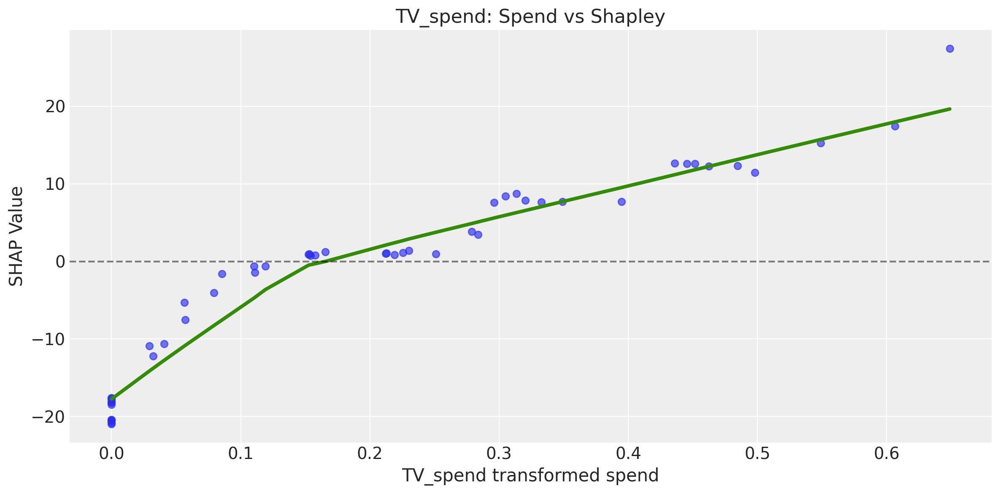

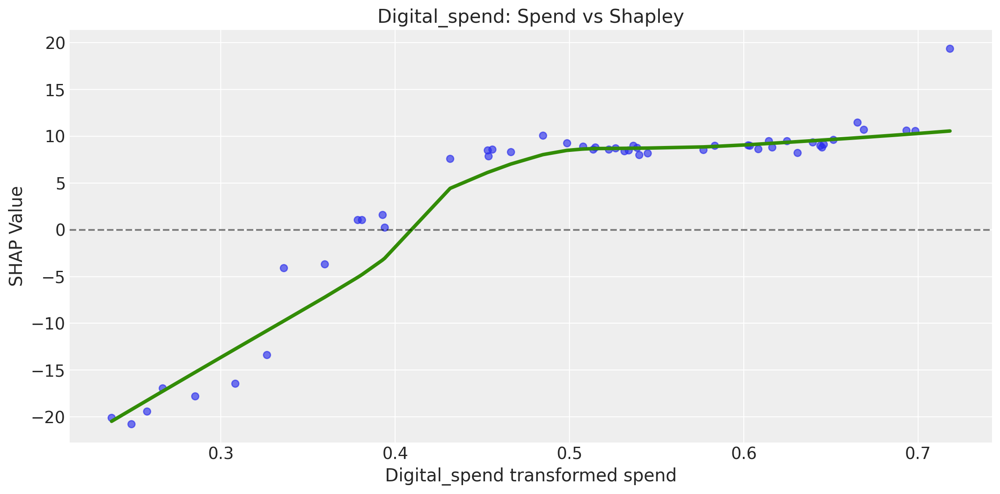


  Analyzing SHAP vs Spend for Ensemble...


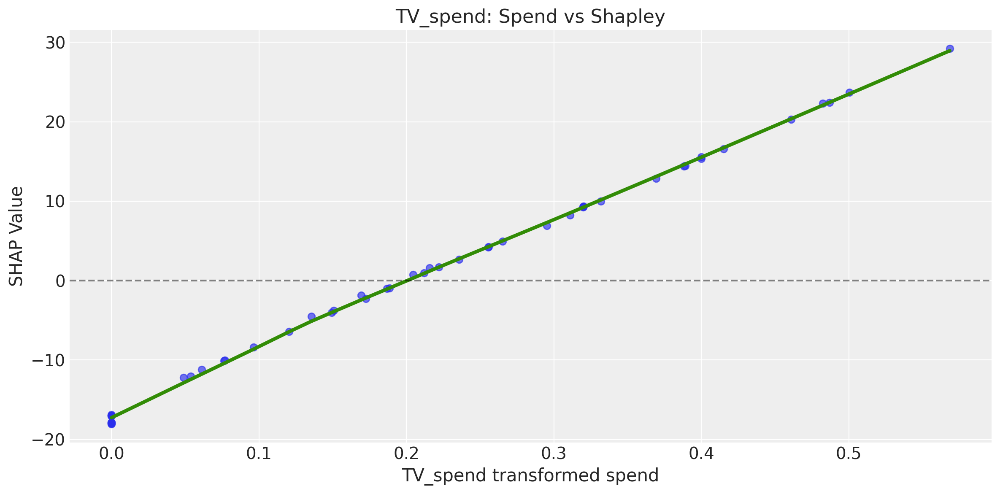

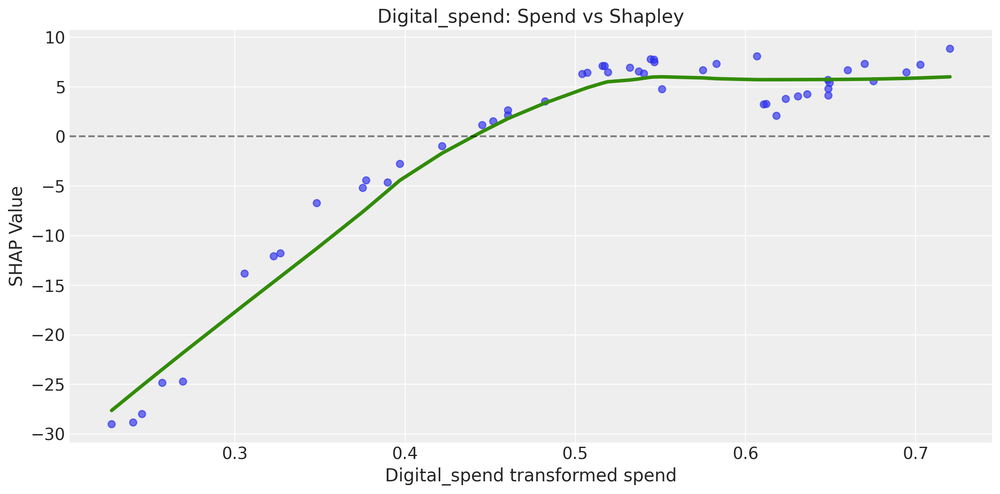


6. Comparing Adstock Parameters Across Models...
               Linear Regression  Linear Regression With Saturation  \
TV_spend                0.798059                           0.779783   
Digital_spend           0.113296                           0.365152   

               Gradient Boosting  Ensemble  
TV_spend                0.719031  0.799270  
Digital_spend           0.441351  0.413266  


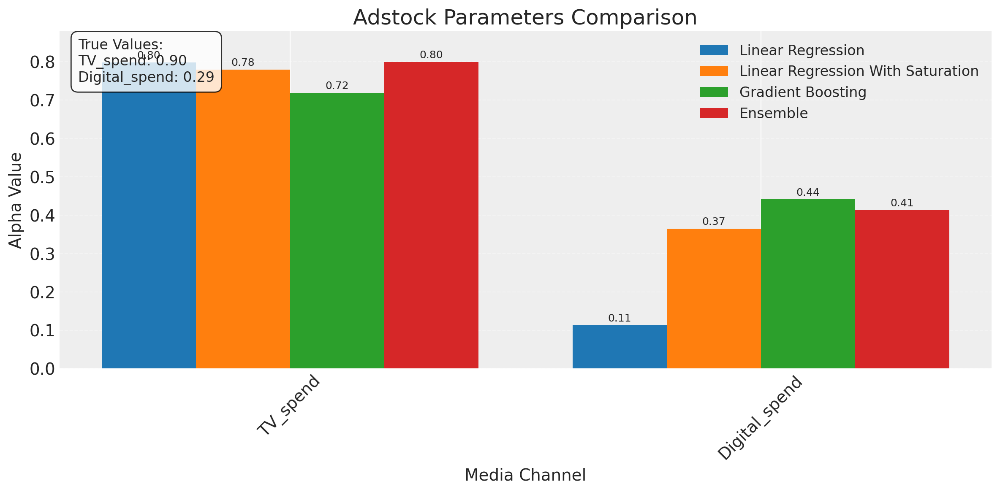


Calculating incremental ROAS for Linear Regression...
Generated baseline predictions, shape: (162,)
  Processing channel: TV_spend
    Baseline sum: 18986.62
    Zeroed-out sum: 16234.04
    Incremental contribution: 2752.58
    Total spend: 34.45
    Incremental ROAS: 79.91
  Processing channel: Digital_spend
    Baseline sum: 18986.62
    Zeroed-out sum: 14797.96
    Incremental contribution: 4188.66
    Total spend: 73.36
    Incremental ROAS: 57.10

Calculating incremental ROAS for Linear Regression With Saturation...
Generated baseline predictions, shape: (162,)
  Processing channel: TV_spend
    Baseline sum: 18986.62
    Zeroed-out sum: 16143.36
    Incremental contribution: 2843.26
    Total spend: 34.45
    Incremental ROAS: 82.54
  Processing channel: Digital_spend
    Baseline sum: 18986.62
    Zeroed-out sum: 7206.41
    Incremental contribution: 11780.21
    Total spend: 73.36
    Incremental ROAS: 160.58

Calculating incremental ROAS for Gradient Boosting...
Generated ba

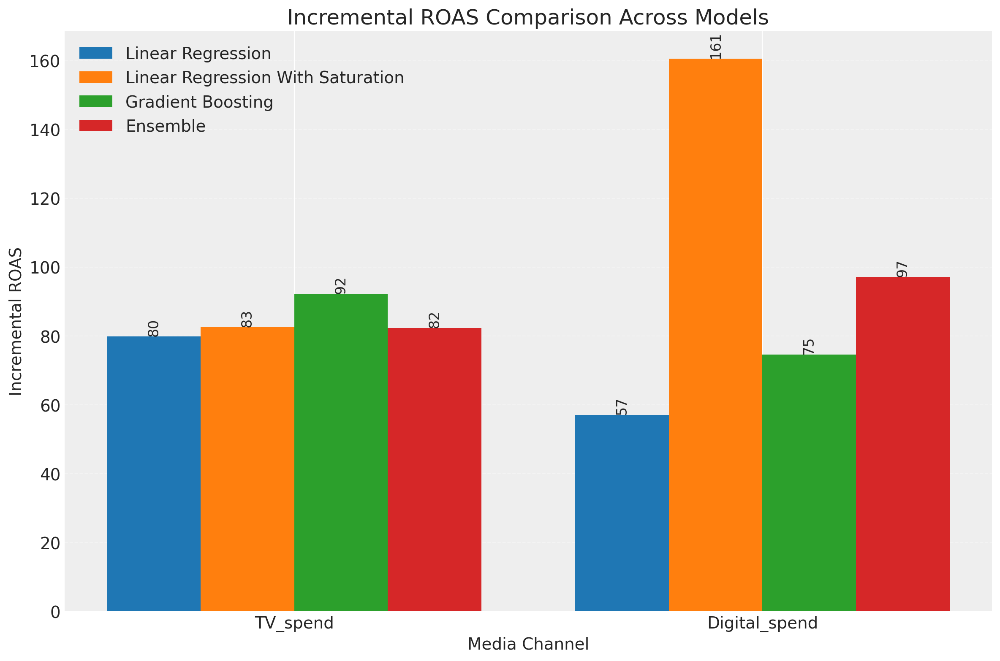


MMM Analysis Complete!


In [19]:
# Fourier features
n_order = 2
periods = dataset.date.dt.dayofyear / 365.25
fourier_features = pd.DataFrame(
    {
        f"{func}_order_{order}": getattr(np, func)(2 * np.pi * periods * order)
        for order in range(1, n_order + 1)
        for func in ("sin", "cos")
    }
)

# Create trend feature
trend = pd.DataFrame({"trend": np.arange(len(dataset.date))})

# Combine features
X = pd.concat([trend, spend_df, fourier_features], axis=1)
y = pd.Series(dataset.target.values.reshape(-1,), index=X.index)

# Define alpha ranges for media channels
alpha_ranges = {}
lambda_ranges = {}
for col in media_columns:
    if 'TV' in col.upper():
        alpha_ranges[col] = (0.3, 0.8)
        lambda_ranges[col] = (0,10)
    elif 'RADIO' in col.upper():
        alpha_ranges[col] = (0.1, 0.5)
    elif 'OOH' in col.upper():
        alpha_ranges[col] = (0.1, 0.4)
    elif 'DIGITAL' in col.upper() or 'SEARCH' in col.upper():
        alpha_ranges[col] = (0.0, 0.5)
        lambda_ranges[col] = (0,10)
    else:
        alpha_ranges[col] = (0.1, 0.7)

# Run the complete analysis
results = run_mmm_analysis(
    X=X,
    y=y,
    media_columns=media_columns,
    alpha_ranges=alpha_ranges,
    lambda_ranges=lambda_ranges,
    is_multiobjective=False,
    test_size=50,
    n_trials=50  # Increase this for better results
)

## Bayesian model

### Data preparation

In [20]:
seed: int = 40
rng: np.random.Generator = np.random.default_rng(seed=seed)

#### Train test split

In [21]:
test_size = 50


t = (dataset.date - dataset.date.min()) / (dataset.date.max() - dataset.date.min())
t = t.values
t_train = t[None:-test_size]
t_test = t[-test_size:None]

In [22]:
dataset['target_scaled'] = xr.DataArray(
    np.zeros((len(dataset.date), len(countries))),
    coords={'date': dataset.date, 'country': countries},
    dims=['date', 'country']
)

dataset['z_scaled'] = xr.DataArray(
    np.zeros((len(dataset.date), len(channels), len(countries))),
    coords={'date': dataset.date, 'channel': channels, 'country': countries},
    dims=['date', 'channel', 'country']
)


# Instantiate scalers
target_scaler = MaxAbsScaler()
channel_scaler = MaxAbsScaler()

# Fit scalers
target = dataset.target.values.reshape(-1, 1)
spend = dataset.spends.values.reshape(-1, dataset.spends.shape[-1])

target_train = target[None:-test_size]
target_test = target[-test_size:None]


spend_train = spend[None:-test_size]
spend_test = spend[-test_size:None]

target_scaler.fit(target_train)
channel_scaler.fit(spend_train)


# Then apply scaling
for i, country in enumerate(countries):

    target_scaled = target_scaler.transform(target_train.reshape(-1,1)).flatten()
    target_test_scaled = target_scaler.transform(target_test.reshape(-1,1)).flatten()
    z_scaled = channel_scaler.transform(spend_train)
    z_test_scaled = channel_scaler.transform(spend_test)


In [23]:
channel_share_array = np.zeros((len(channels), len(countries)))

# Get
for i, country in enumerate(countries):
    y = dataset.target.sel(country=country)
    spends = dataset.spends.sel(country=country)

    # Calculate channel shares
    channel_share_array[:,i] = (spends.sum(axis=0) / spends.sum().sum())*len(channels)

## Model setup with pymc 

In [24]:
def geometric_adstock(x, alpha, l_max, normalize):
    """Vectorized geometric adstock transformation."""
    cycles = [
        pt.concatenate(tensor_list=[pt.zeros(shape=x.shape)[:i], x[: x.shape[0] - i]])
        for i in range(l_max)
    ]
    x_cycle = pt.stack(cycles)
    x_cycle = pt.transpose(x=x_cycle, axes=[1, 2, 0])
    w = pt.as_tensor_variable([pt.power(alpha, i) for i in range(l_max)])
    w = pt.transpose(w)[None, ...]
    w = w / pt.sum(w, axis=2, keepdims=True) if normalize else w
    return pt.sum(pt.mul(x_cycle, w), axis=2)


def logistic_saturation(x, lam):
    """Logistic saturation transformation."""
    return (1 - pt.exp(-lam * x)) / (1 + pt.exp(-lam * x))

Sampling: [a, alpha, b_fourier, b_trend, b_z, lam, likelihood, nu, sigma]


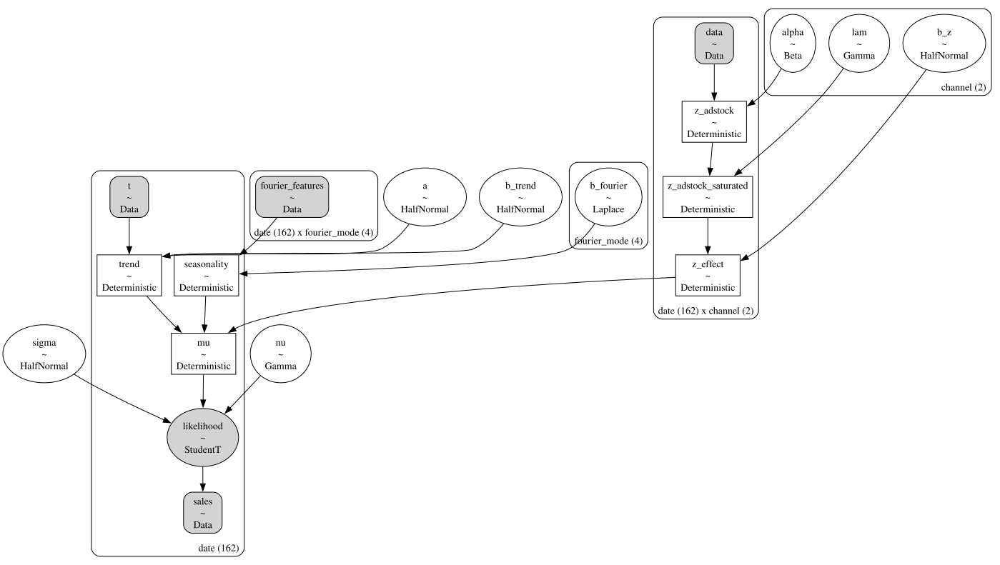

In [25]:




# Setup
n_order = 2
dates = dataset.date.values[None:-test_size]
coords = {"channel": channels, "fourier_mode": np.arange(2 * n_order)}


with pm.Model(coords=coords) as model:
    # --- coords --- #
    model.add_coord(name="date", values=dates)

    # --- data containers --- #
    data = pm.Data(
       "data",
       z_scaled,
       dims=("date", "channel"),
      # coords=dataset.date.values
    )

    fourier_feature_data = pm.Data(
        "fourier_features",
        fourier_features[None:-test_size],
        dims=("date", "fourier_mode")
    )

    t_data = pm.Data(
        "t",
        t_train,
        dims="date"
    )

    sales_data = pm.Data(
        "sales",
        target_scaled,
        dims="date"
    )

    # --- priors --- #
    ## intercept
    a = pm.HalfNormal(name="a", sigma=0.5)
    ## trend
    b_trend = pm.HalfNormal(name="b_trend", sigma=2)
    ## adstock effect
    alpha = pm.Beta(name="alpha", alpha=2, beta=2, dims="channel")
    ## saturation effect
    lam = pm.Gamma(name="lam", alpha=3, beta=1, dims="channel")
    ## seasonality
    b_fourier = pm.Laplace(name="b_fourier", mu=0, b=0.2, dims="fourier_mode")
    ## regressor
    b_z = pm.HalfNormal(name="b_z", sigma=channel_share_array.reshape(-1,1).flatten(), dims="channel")
    ## standard deviation of the normal likelihood
    sigma = pm.HalfNormal(name="sigma", sigma=0.5)
    # degrees of freedom of the t distribution
    nu = pm.Gamma(name="nu", alpha=25, beta=2)

    # --- model parametrization --- #
    trend = pm.Deterministic(name="trend", var=a + b_trend * t_data, dims="date")
    seasonality = pm.Deterministic(
        name="seasonality", var=pm.math.dot(fourier_feature_data, b_fourier), dims="date"
    )

    z_adstock = pm.Deterministic(
        name="z_adstock", var=geometric_adstock(x=data, alpha=alpha, l_max=8, normalize=True), dims=("date","channel")
    )

    z_adstock_saturated = pm.Deterministic(
        name="z_adstock_saturated",
        var=logistic_saturation(x=z_adstock, lam=lam),
        dims=("date","channel"),
    )
    z_effect = pm.Deterministic(
        name="z_effect", var=b_z * z_adstock_saturated, dims=("date","channel")
    )


    mu = pm.Deterministic(name="mu", var=trend + seasonality + z_effect.sum(axis=1), dims="date")

    # --- likelihood ---
    y = pm.StudentT(name="likelihood", nu=nu, mu=mu, sigma=sigma, observed=sales_data, dims="date")


    # --- prior samples #
    adstock_saturation_model_prior_predictive = pm.sample_prior_predictive()

pm.model_to_graphviz(model=model)

[Text(0.5, 1.0, 'Model - Prior Predictive Samples')]

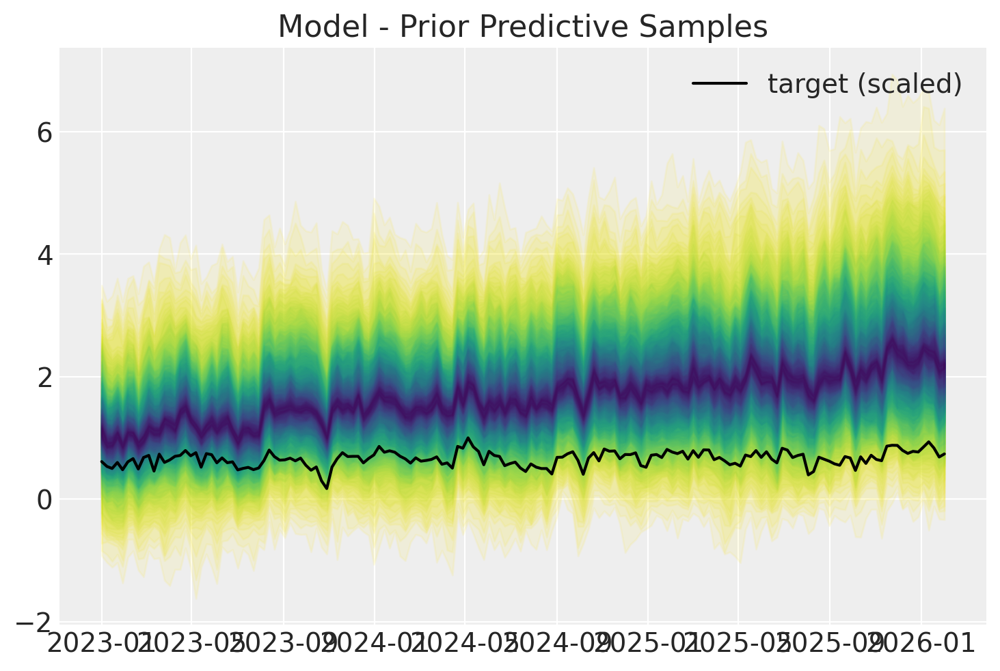

In [26]:
# useful way to color the distribution
palette = "viridis_r"
cmap = plt.get_cmap(palette)
percs = np.linspace(51, 99, 100)
colors = (percs - np.min(percs)) / (np.max(percs) - np.min(percs))


fig, ax = plt.subplots()

for i, p in enumerate(percs[::-1]):
    upper = np.percentile(adstock_saturation_model_prior_predictive.prior_predictive["likelihood"], p, axis=1)
    lower = np.percentile(
        adstock_saturation_model_prior_predictive.prior_predictive["likelihood"], 100 - p, axis=1
    )
    color_val = colors[i]
    ax.fill_between(
        x=dates,
        y1=upper.flatten(),
        y2=lower.flatten(),
        color=cmap(color_val),
        alpha=0.1,
    )

sns.lineplot(x=dates, y=target_scaled, color="black", label="target (scaled)", ax=ax)
ax.legend()
ax.set(title="Model - Prior Predictive Samples")

In [27]:
with model:
    base_model_trace = pm.sample(
        nuts_sampler="numpyro",
        draws=2_000,
        target_accept=0.95,
        chains=4,
        idata_kwargs={"log_likelihood": True},
        random_seed=rng
    )
    base_model_posterior_predictive = pm.sample_posterior_predictive(
        trace=base_model_trace,
        random_seed=rng,
        var_names=["likelihood"],

    )

    base_model_trace.extend(base_model_posterior_predictive)

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

Sampling: [likelihood]


Output()

### Model summary 

In [28]:
az.summary(
    data=base_model_trace,
    var_names=["a", "b_trend", "b_z", "alpha", "lam", "sigma", "nu"],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a,0.067,0.035,0.000,0.123,0.001,0.000,2821.0,2230.0,1.0
b_trend,0.214,0.016,0.184,0.246,0.000,0.000,7642.0,5865.0,1.0
b_z[TV],0.728,0.248,0.350,1.209,0.004,0.003,3736.0,5214.0,1.0
b_z[Digital],0.467,0.034,0.404,0.526,0.001,0.000,3041.0,3155.0,1.0
alpha[TV],0.885,0.017,0.853,0.916,0.000,0.000,6513.0,4432.0,1.0
alpha[Digital],0.262,0.036,0.195,0.329,0.001,0.000,4593.0,5032.0,1.0
lam[TV],2.510,0.895,1.007,4.132,0.014,0.010,3792.0,5424.0,1.0
lam[Digital],5.377,0.407,4.644,6.182,0.006,0.004,4733.0,5465.0,1.0
sigma,0.040,0.003,0.035,0.045,0.000,0.000,7124.0,5810.0,1.0
nu,12.993,2.478,8.641,17.837,0.027,0.019,8273.0,5621.0,1.0


Text(0.5, 0.98, 'Base Model - Trace')

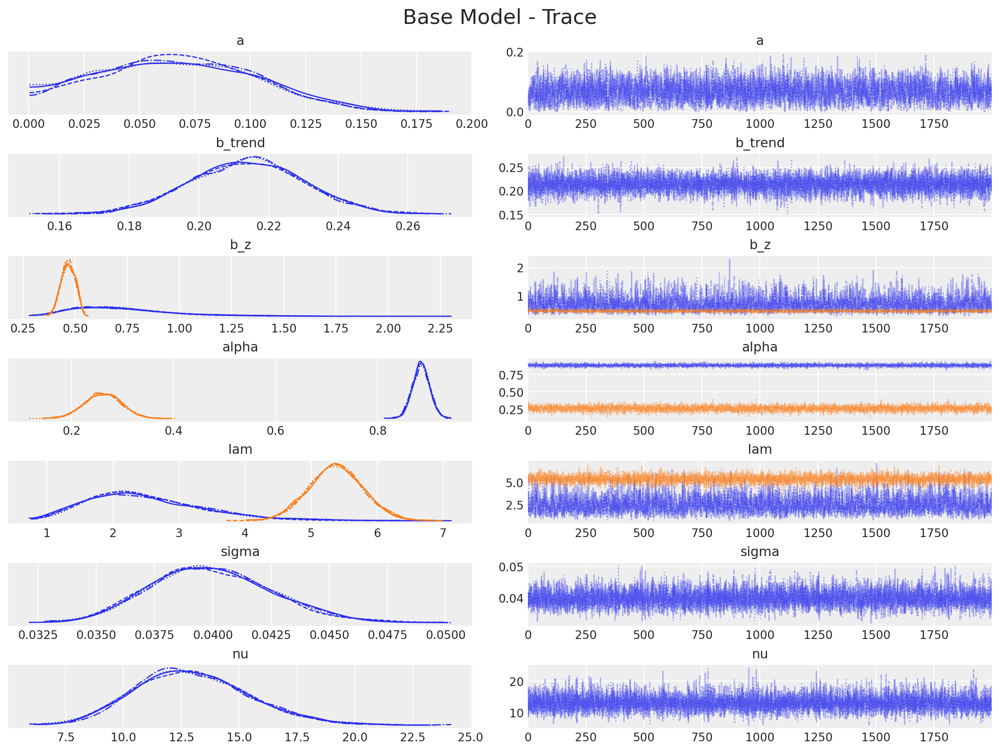

In [29]:
axes = az.plot_trace(
    data=base_model_trace,
    var_names=["a", "b_trend", "b_z", "alpha", "lam", "sigma", "nu"],
    compact=True,
    backend_kwargs={
        "figsize": (12, 9),
        "layout": "constrained"
    },
)
fig = axes[0][0].get_figure()
fig.suptitle("Base Model - Trace")

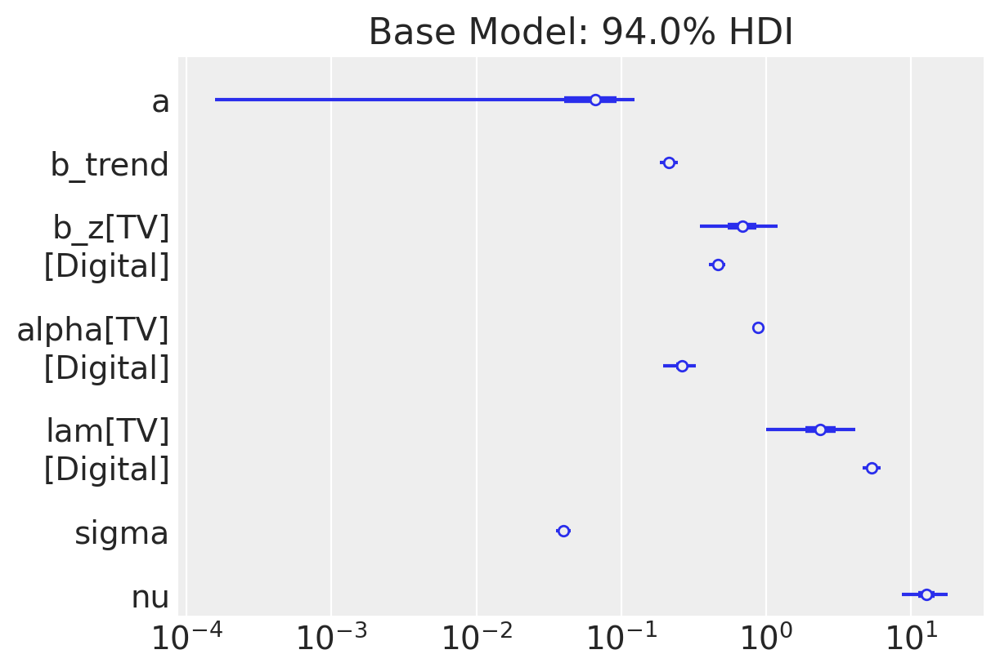

In [30]:
fig, ax = plt.subplots(figsize=(6, 4))
az.plot_forest(
    data=base_model_trace,
    var_names=["a", "b_trend", "b_z", "alpha", "lam", "sigma", "nu"],
    combined=True,
    ax=ax
)
ax.set(
    title="Base Model: 94.0% HDI",
    xscale="log"
);

### Posterior Predictive Sample

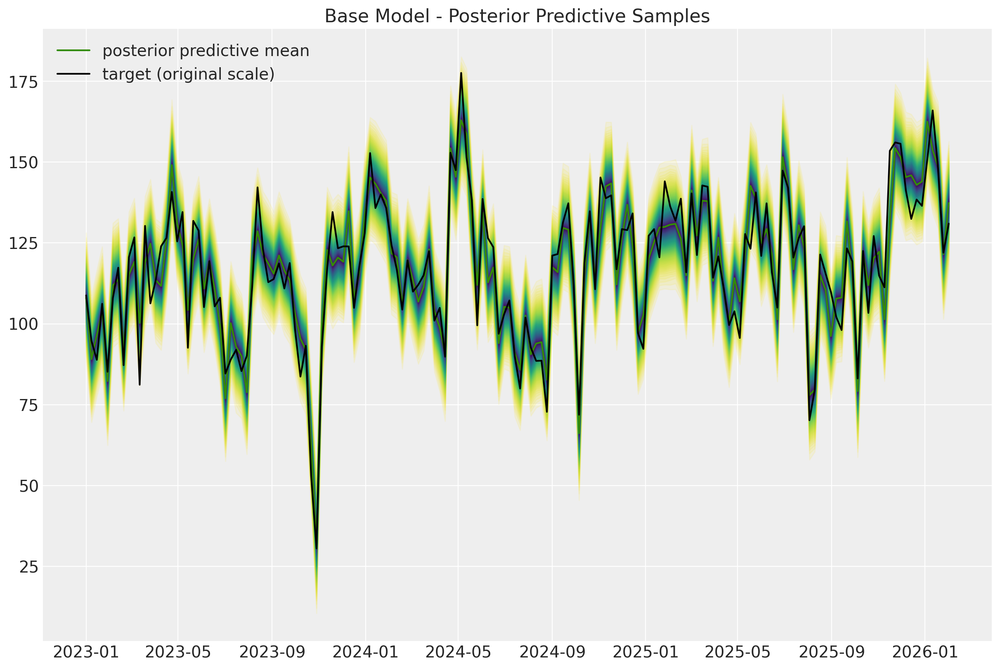

In [31]:
posterior_predictive_likelihood = az.extract(
    data=base_model_posterior_predictive,
    group="posterior_predictive",
    var_names="likelihood",
)

posterior_predictive_likelihood_inv = target_scaler.inverse_transform(
    X=posterior_predictive_likelihood
)

fig, ax = plt.subplots(figsize=(12, 8))

for i, p in enumerate(percs[::-1]):
    upper = np.percentile(posterior_predictive_likelihood_inv, p, axis=1)
    lower = np.percentile(posterior_predictive_likelihood_inv, 100 - p, axis=1)
    color_val = colors[i]
    ax.fill_between(
        x=dates,
        y1=upper,
        y2=lower,
        color=cmap(color_val),
        alpha=0.1,
    )

sns.lineplot(
    x=dates,
    y=posterior_predictive_likelihood_inv.mean(axis=1),
    color="C2",
    label="posterior predictive mean",
    ax=ax,
)
sns.lineplot(
    x=dates,
    y=target_train.flatten(),
    color="black",
    label="target (original scale)",
    ax=ax,
)
ax.legend(loc="upper left")
ax.set(title="Base Model - Posterior Predictive Samples");

### Out of sample

In [32]:
# First, update your model with the test data
with model:



    # Now update the data
    pm.set_data(new_data={"data": z_test_scaled,
                          "t": t_test,
                          "fourier_features": fourier_features[-test_size:None],
                          "sales": target_test_scaled,
                          }, coords={"date": dataset.date.values[-test_size:None]})



    base_model_trace.extend(
    # Generate posterior predictive samples
    other = pm.sample_posterior_predictive(
        trace=base_model_trace,
        predictions=True,
        var_names=["likelihood"],
        random_seed=rng,
        idata_kwargs={"coords": {"date": dataset.date.values[-test_size:None]}}
    ),
    # join="right",
    )


Sampling: [likelihood]


Output()

Available groups in base_model_trace: ['posterior', 'posterior_predictive', 'predictions', 'log_likelihood', 'sample_stats', 'observed_data', 'constant_data', 'predictions_constant_data']


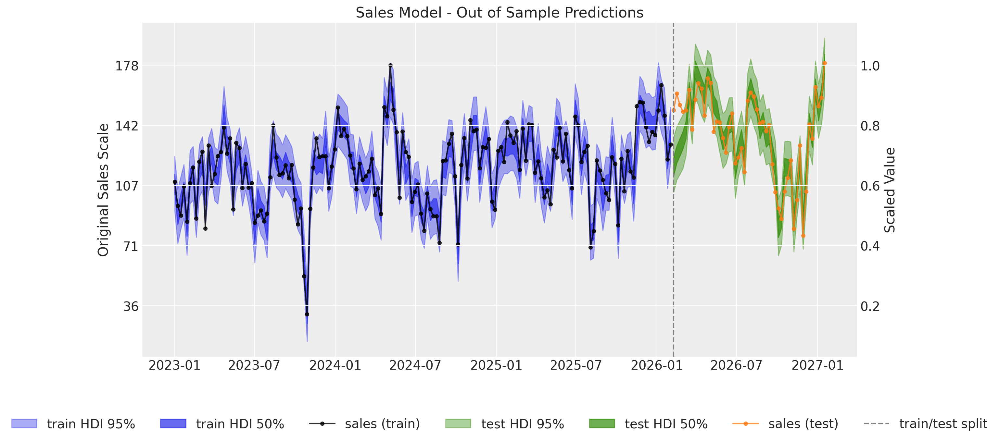

Test Metrics:
Scaled Space - MAE: 0.0392, RMSE: 0.0585
Original Space - MAE: 6.96, RMSE: 10.40, MAPE: 5.29%


In [33]:


# Create a custom y-axis formatter to show original scale values
def scaled_to_original(y, pos):
    """Convert scaled y-values to original scale for display"""
    # Reshape y to match scaler expected format
    y_reshaped = np.array([[y]])
    # Convert to original scale
    y_original = target_scaler.inverse_transform(y_reshaped)[0, 0]
    return f'{y_original:.0f}'  # Format as needed

# Use your exact plot code but with base_model_trace instead of combined
fig, ax = plt.subplots(figsize=(15, 7))

# Plot training data predictions and HDI
az.plot_hdi(
    x=dates,
    y=base_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.95,
    color="C0",
    fill_kwargs={"alpha": 0.4, "label": r"train HDI $95\%$"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    x=dates,
    y=base_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.5,
    color="C0",
    fill_kwargs={"alpha": 0.7, "label": r"train HDI $50\%$"},
    smooth=False,
    ax=ax,
)
sns.lineplot(
    x=dates,
    y=target_scaled,
    marker="o",
    color="black",
    alpha=0.8,
    markersize=4,
    markeredgecolor="black",
    label="sales (train)",
    ax=ax,
)

# Extract test predictions from base_model_trace instead of combined_posterior_predictive
test_dates = dataset.date.values[-test_size:]

# Check which groups are available in base_model_trace
available_groups = list(base_model_trace.groups())
print(f"Available groups in base_model_trace: {available_groups}")

if 'predictions' in available_groups:
    # Use posterior_predictive from base_model_trace if available
    az.plot_hdi(
        x=test_dates,
        y=base_model_trace["predictions"]["likelihood"],
        hdi_prob=0.95,
        color="C2",
        fill_kwargs={"alpha": 0.4, "label": r"test HDI $95\%$"},
        smooth=False,
        ax=ax,
    )
    az.plot_hdi(
        x=test_dates,
        y=base_model_trace["predictions"]["likelihood"],
        hdi_prob=0.5,
        color="C2",
        fill_kwargs={"alpha": 0.7, "label": r"test HDI $50\%$"},
        smooth=False,
        ax=ax,
    )

    # Calculate test prediction mean for metrics
    test_pred_mean = base_model_trace["predictions"]["likelihood"].mean(dim=["chain", "draw"]).values
else:
    print("Warning: 'predictions' not found in base_model_trace.")
    test_pred_mean = None

sns.lineplot(
    x=test_dates,
    y=target_test_scaled,
    marker="o",
    color="C1",
    alpha=0.8,
    markersize=4,
    markeredgecolor="C1",
    label="sales (test)",
    ax=ax,

)

# Optional: Add a vertical line at the train/test split
train_test_date = dataset.date.values[-test_size]
ax.axvline(x=train_test_date, color="gray", linestyle="--", label="train/test split")

# Apply the formatter to show original scale on y-axis
ax.yaxis.set_major_formatter(FuncFormatter(scaled_to_original))

# Add a secondary y-axis showing the scaled values
ax_scaled = ax.twinx()
ax_scaled.set_ylim(ax.get_ylim())
ax_scaled.set_ylabel('Scaled Value')
ax_scaled.spines['right'].set_visible(True)

ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=7)
ax.set(title="Sales Model - Out of Sample Predictions")
ax.set_ylabel("Original Sales Scale")
plt.tight_layout()
plt.show()

# Display metrics if test predictions are available
if test_pred_mean is not None and target_test_scaled is not None:
    # Calculate metrics in scaled space
    from sklearn.metrics import mean_absolute_error, mean_squared_error
    import numpy as np

    mae_scaled = mean_absolute_error(target_test_scaled, test_pred_mean)
    rmse_scaled = np.sqrt(mean_squared_error(target_test_scaled, test_pred_mean))

    # Calculate metrics in original scale
    test_pred_mean_orig = target_scaler.inverse_transform(test_pred_mean.reshape(-1, 1)).flatten()
    target_test_orig = target_scaler.inverse_transform(target_test_scaled.reshape(-1, 1)).flatten()

    mae_orig = mean_absolute_error(target_test_orig, test_pred_mean_orig)
    rmse_orig = np.sqrt(mean_squared_error(target_test_orig, test_pred_mean_orig))
    mape = np.mean(np.abs((target_test_orig - test_pred_mean_orig) / target_test_orig)) * 100

    print(f"Test Metrics:")
    print(f"Scaled Space - MAE: {mae_scaled:.4f}, RMSE: {rmse_scaled:.4f}")
    print(f"Original Space - MAE: {mae_orig:.2f}, RMSE: {rmse_orig:.2f}, MAPE: {mape:.2f}%")

Seems really good except around the train test split... 
What's the reason of this? 
Refer to the carryover effect ;)  

### Adding the carryover effect to your test set

In [34]:
l_max = 8  # This should match your adstock's l_max parameter

# Combine last l_max training observations with test data
z_combined = np.vstack([z_scaled[-l_max:], z_test_scaled])

# Combine the dates as well
combined_dates = np.concatenate([dataset.date.values[-l_max-test_size:-test_size],
                               dataset.date.values[-test_size:]])

# combined_index_scaled = np.concatenate([index_train_scaled[-l_max:None],
#                                index_test_scaled])


# Combined t values
t_combined = np.concatenate([t_train[-l_max:], t_test])

# Combined fourier features
fourier_combined = np.vstack([fourier_features[-l_max-test_size:-test_size],
                            fourier_features[-test_size:]])

if target_test_scaled is not None:
    target_combined = np.concatenate([target_scaled[-l_max:], target_test_scaled])
else:
    target_combined = np.concatenate([target_scaled[-l_max:],
                                     np.full(test_size, np.nan)])

# Update model with the combined data
with model:
    pm.set_data(
        new_data={
            "data": z_combined,
            "t": t_combined,
           #  "index_scaled_data": combined_index_scaled,
            "fourier_features": fourier_combined
        },
        coords={"date": combined_dates}
    )

    # Generate posterior predictive samples
    combined_posterior_predictive = pm.sample_posterior_predictive(
        trace=base_model_trace,
        var_names=["likelihood"],
        random_seed=rng,
        predictions=True,
        idata_kwargs={"coords": {"date": combined_dates}}
    )

Sampling: [likelihood]


Output()

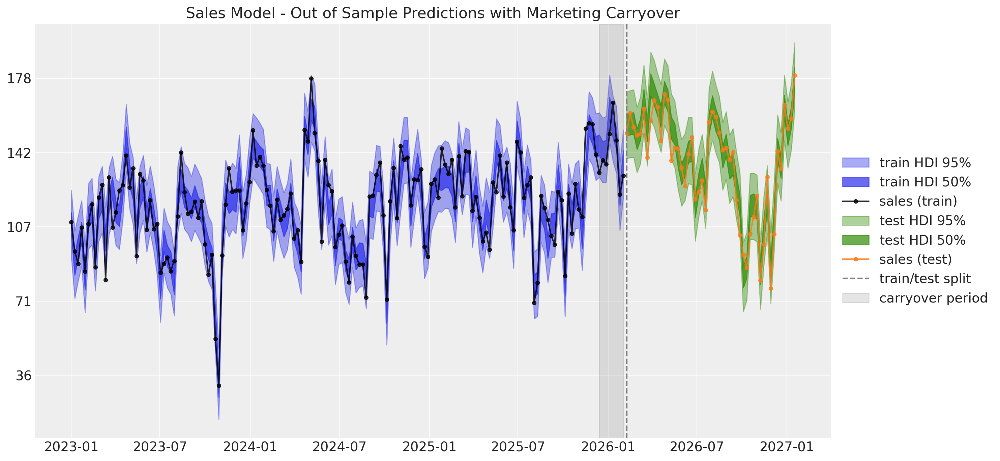

Test Metrics (with carryover effects):
Scaled Space - MAE: 0.0283, RMSE: 0.0375
Original Space - MAE: 5.02, RMSE: 6.66, MAPE: 4.04%


In [ ]:

def scaled_to_original(y, pos):
    """Convert scaled y-values to original scale for display"""
    # Reshape y to match scaler expected format
    y_reshaped = np.array([[y]])
    # Convert to original scale
    y_original = target_scaler.inverse_transform(y_reshaped)[0, 0]
    return f'{y_original:.0f}'  # Format as needed

# Create the plot with exactly the same layout
fig, ax = plt.subplots(figsize=(15, 7))

# Plot training data predictions and HDI
az.plot_hdi(
    x=dates,
    y=base_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.95,
    color="C0",
    fill_kwargs={"alpha": 0.4, "label": r"train HDI $95\%$"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    x=dates,
    y=base_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.5,
    color="C0",
    fill_kwargs={"alpha": 0.7, "label": r"train HDI $50\%$"},
    smooth=False,
    ax=ax,
)
sns.lineplot(
    x=dates,
    y=target_scaled,
    marker="o",
    color="black",
    alpha=0.8,
    markersize=4,
    markeredgecolor="black",
    label="sales (train)",
    ax=ax,
)

# Extract only the test part (skip carryover observations)
test_dates = dataset.date.values[-test_size:]
test_predictions = combined_posterior_predictive["predictions"]["likelihood"].isel(date=slice(l_max, None))

az.plot_hdi(
    x=test_dates,
    y=test_predictions,
    hdi_prob=0.95,
    color="C2",
    fill_kwargs={"alpha": 0.4, "label": r"test HDI $95\%$"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    x=test_dates,
    y=test_predictions,
    hdi_prob=0.5,
    color="C2",
    fill_kwargs={"alpha": 0.7, "label": r"test HDI $50\%$"},
    smooth=False,
    ax=ax,
)
sns.lineplot(
    x=test_dates,
    y=target_test_scaled,
    marker="o",
    color="C1",
    alpha=0.8,
    markersize=4,
    markeredgecolor="C1",
    label="sales (test)",
    ax=ax,
)

# Optional: Add a vertical line at the train/test split
train_test_date = dataset.date.values[-test_size]
ax.axvline(x=train_test_date, color="gray", linestyle="--", label="train/test split")

# Optional: To show carryover period explicitly
carryover_dates = dataset.date.values[-l_max-test_size:-test_size]
ax.axvspan(carryover_dates[0], carryover_dates[-1], alpha=0.2, color='gray', label='carryover period')

# Apply the formatter to show original scale on y-axis
ax.yaxis.set_major_formatter(FuncFormatter(scaled_to_original))

ax.legend(loc="center left", bbox_to_anchor=(1, 0.5))
ax.set_title("Sales Model - Out of Sample Predictions with Marketing Carryover")

plt.tight_layout()
plt.show()

# Display metrics if you have test data
if target_test_scaled is not None:
    # Calculate predictions mean
    test_pred_mean = test_predictions.mean(dim=["chain", "draw"]).values

    # Calculate metrics in scaled space
    from sklearn.metrics import mean_absolute_error, mean_squared_error
    import numpy as np

    mae_scaled = mean_absolute_error(target_test_scaled, test_pred_mean)
    rmse_scaled = np.sqrt(mean_squared_error(target_test_scaled, test_pred_mean))

    # Calculate metrics in original scale
    test_pred_mean_orig = target_scaler.inverse_transform(test_pred_mean.reshape(-1, 1)).flatten()
    target_test_orig = target_scaler.inverse_transform(target_test_scaled.reshape(-1, 1)).flatten()

    mae_orig = mean_absolute_error(target_test_orig, test_pred_mean_orig)
    rmse_orig = np.sqrt(mean_squared_error(target_test_orig, test_pred_mean_orig))
    mape = np.mean(np.abs((target_test_orig - test_pred_mean_orig) / target_test_orig)) * 100

    print(f"Test Metrics (with carryover effects):")
    print(f"Scaled Space - MAE: {mae_scaled:.4f}, RMSE: {rmse_scaled:.4f}")
    print(f"Original Space - MAE: {mae_orig:.2f}, RMSE: {rmse_orig:.2f}, MAPE: {mape:.2f}%")

### Model parameters 

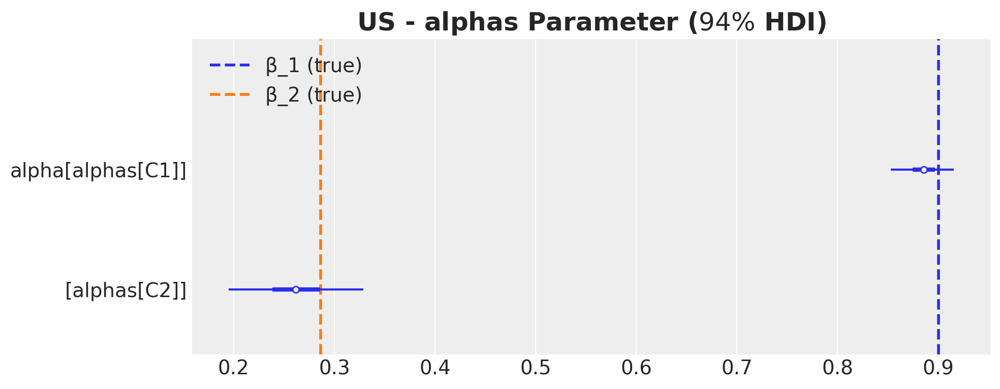

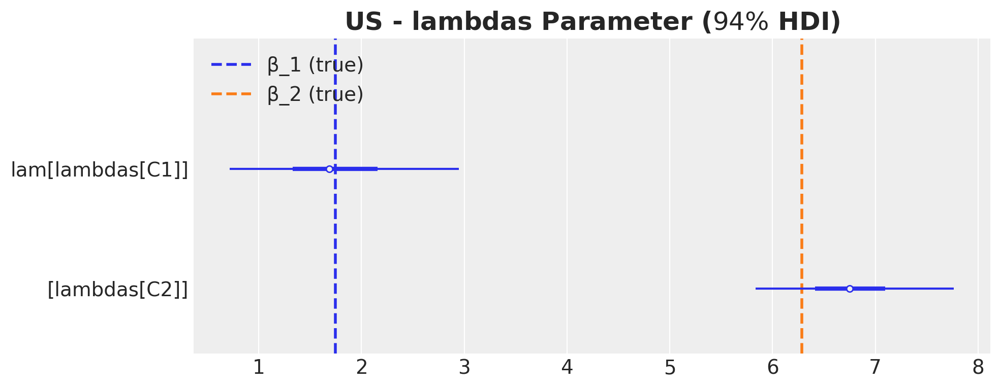

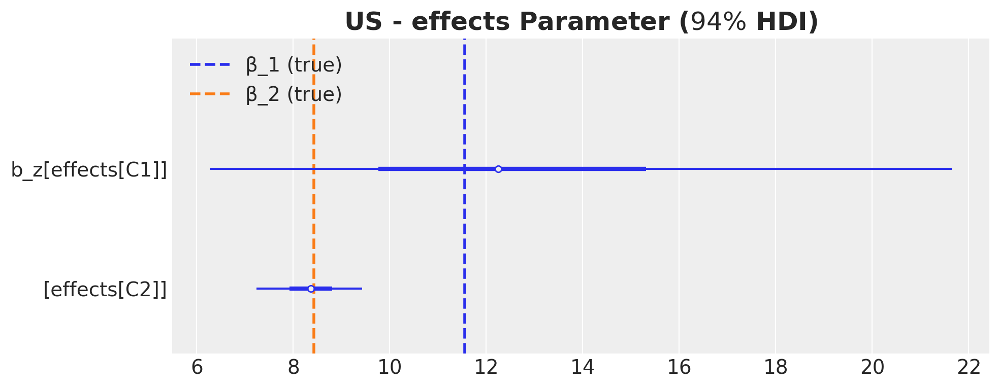

In [36]:
# Initialize single scalers for all countries
channel_scaler = MaxAbsScaler()
target_scaler = MaxAbsScaler()

# Fit scalers on all data
all_spends = dataset.spends.values.reshape(-1, len(channels))  # Flatten across countries and dates
all_targets = dataset.target.values.reshape(-1, 1)  # Flatten across countries and dates

channel_scaler.fit(all_spends)
target_scaler.fit(all_targets)

# Now recover parameters using these global scalers
recovered_params = {}
for country in countries:
    # Scale posteriors using the global scalers
    alphas = base_model_trace.posterior["alpha"]
    lams = base_model_trace.posterior["lam"] / channel_scaler.scale_
    betas = (base_model_trace.posterior["b_z"] *
             target_scaler.scale_) / 10  # Divide by amplitude

    recovered_params[country] = {
        'alphas': alphas,
        'lambdas': lams,
        'effects': betas
    }

# Plot function remains the same
def plot_param_comparison(param_name, recovered_params, country_params, countries, channels):
    fig, axes = plt.subplots(len(countries), 1, figsize=(10, 4*len(countries)))

    for i, country in enumerate(countries):
        ax = axes[i] if len(countries) > 1 else axes
        data = recovered_params[country][param_name]
        param_data = []
        param_names = []

        for j, channel in enumerate(channels):
            param_data.append(data[:,:,j])
            param_names.append(f"{param_name}[C{j+1}]")
            true_val = country_params[country][param_name][channel]
            ax.axvline(true_val, color=f"C{j}", linestyle="--", linewidth=2,
                      label=f"β_{j+1} (true)")

        combined_data = xr.concat(param_data, dim='channel')
        combined_data = combined_data.assign_coords(channel=param_names)

        az.plot_forest(data=combined_data, combined=True, hdi_prob=0.94, ax=ax)
        ax.legend(loc="upper left")
        ax.set_title(label=f"{country} - {param_name} Parameter ($94\\%$ HDI)",
                    fontsize=18, fontweight="bold")

    plt.tight_layout()

# Plot each parameter
for param in ['alphas', 'lambdas', 'effects']:
    plot_param_comparison(param, recovered_params, country_params, countries, channels)

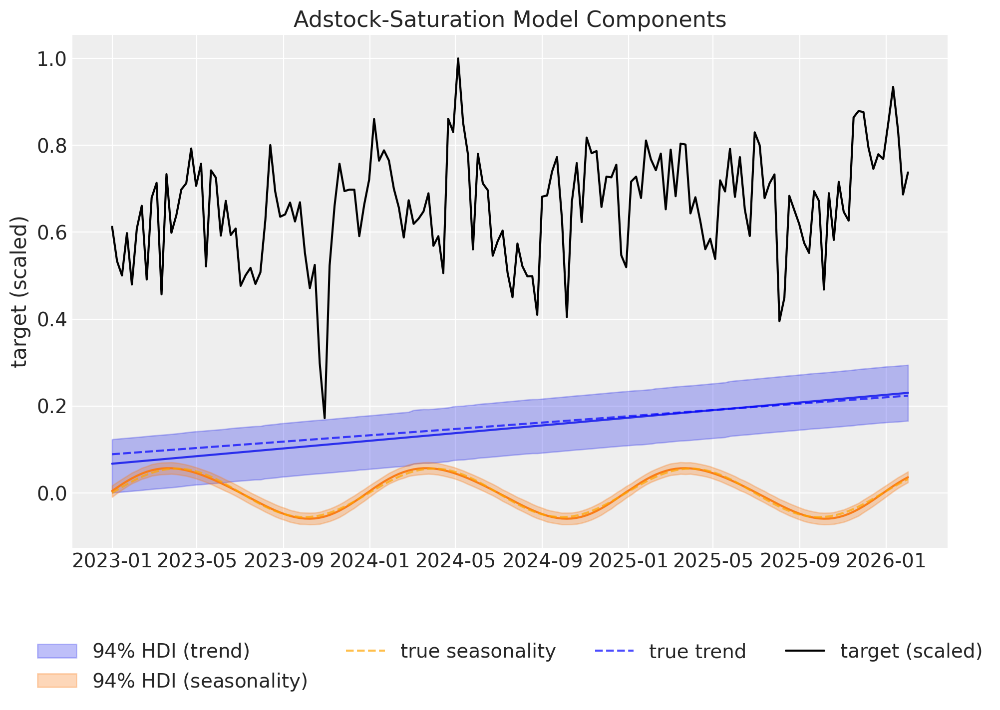

In [37]:
# compute HDI for all the model parameters
model_hdi = az.hdi(ary=base_model_trace)

fig, ax = plt.subplots(figsize=(10,7))

for i, var_effect in enumerate(["trend", "seasonality"]):
    ax.fill_between(
        x=dates,
        y1=model_hdi[var_effect][:, 0],
        y2=model_hdi[var_effect][:, 1],
        color=f"C{i}",
        alpha=0.3,
        label=f"$94\%$ HDI ({var_effect})",
    )
    sns.lineplot(
        x=dates,
        y=base_model_trace.posterior[var_effect]
        .stack(sample=("chain", "draw"))
        .mean(axis=1),
        color=f"C{i}",
    )

true_seasonality = target_scaler.transform(
    dataset.seasonality.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten()

# Plot the true seasonality
sns.lineplot(
    x=dates,
    y=true_seasonality,  # Now properly flattened to 1D
    color="orange",
    alpha=0.7,
    linestyle="--",
    label="true seasonality",
    ax=ax
)


true_trend_and_intercept = target_scaler.transform(
    dataset.trend.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten() + target_scaler.transform(
    dataset.base_sales.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten()

# Plot the true trend
sns.lineplot(
    x=dates,
    y=true_trend_and_intercept,  # Now properly flattened to 1D
    color="blue",
    alpha=0.7,
    linestyle="--",
    label="true trend",
    ax=ax
)

sns.lineplot(
    x=dates, y=target_scaled, color="black", alpha=1.0, label="target (scaled)", ax=ax
)

ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)



ax.set(
    title="Adstock-Saturation Model Components",
    ylabel="target (scaled)",
);

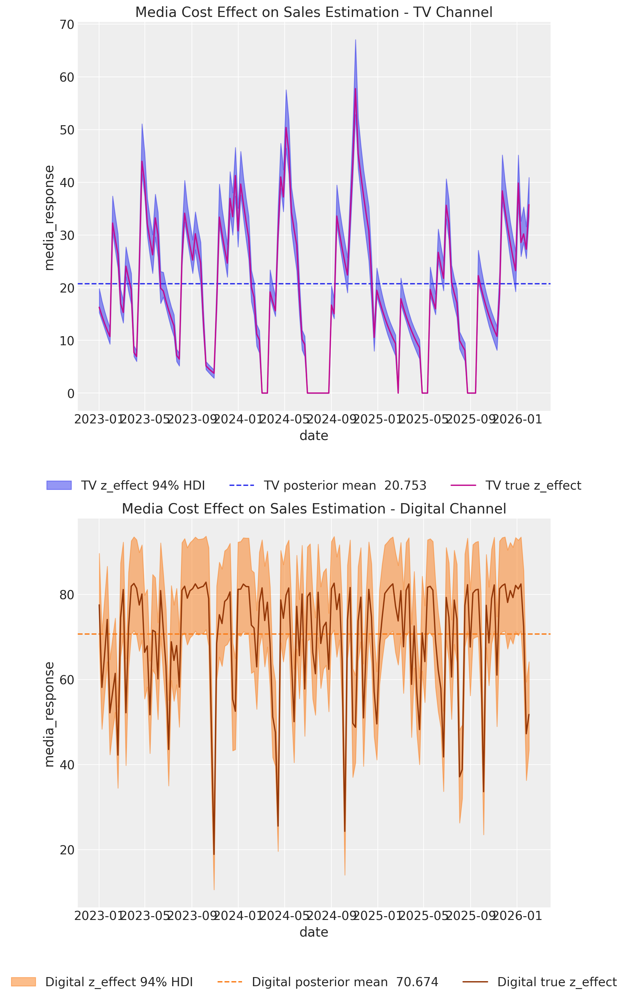

In [38]:
# For multiple channels, we need to handle each channel separately
z_effect_posterior_samples = []

# Loop through each channel
for channel_idx in range(base_model_trace.posterior["z_effect"].sizes["channel"]):
    # Extract data for this channel
    channel_data = base_model_trace.posterior["z_effect"].isel(channel=channel_idx)

    # Apply transformation for this channel
    channel_samples = xr.apply_ufunc(
        lambda x: target_scaler.inverse_transform(X=x.reshape(1, -1)),
        channel_data,
        input_core_dims=[["date"]],
        output_core_dims=[["date"]],
        vectorize=True,
    )

    z_effect_posterior_samples.append(channel_samples)

# Combine the results back into a single DataArray with channel dimension
z_effect_posterior_samples = xr.concat(z_effect_posterior_samples, dim="channel")

# Calculate HDI as before
z_effect_hdi = az.hdi(ary=z_effect_posterior_samples)["z_effect"]

# Plot for each channel
fig, axes = plt.subplots(nrows=len(dataset.channel), figsize=(10, 8*len(dataset.channel)))
if len(dataset.channel) == 1:
    axes = [axes]  # Make it iterable if there's only one subplot

for i, (ax, channel) in enumerate(zip(axes, dataset.channel.values)):
    ax.fill_between(
        x=dataset.date[:-test_size],
        y1=z_effect_hdi.sel(channel=channel)[:, 0],
        y2=z_effect_hdi.sel(channel=channel)[:, 1],
        color=f"C{i}",
        alpha=0.5,
        label=f"{channel} z_effect 94% HDI",
    )
    ax.axhline(
        y=z_effect_posterior_samples.sel(channel=channel).mean(),
        color=f"C{i}",
        linestyle="--",
        label=f"{channel} posterior mean {z_effect_posterior_samples.sel(channel=channel).mean().values: 0.3f}",
    )

    # Plot the original data for this channel
    sns.lineplot(
        x="date",
        y="media_response",
        color=f"C{i+3}",
        data=(dataset.media_response.sel(channel=channel)*10).to_dataframe().reset_index()[:-test_size],
        label=f"{channel} true z_effect",
        ax=ax
    )

    ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=7)
    ax.set(title=f"Media Cost Effect on Sales Estimation - {channel} Channel")

plt.tight_layout()

Perfect! The model succeeded in capturing the true trend, seasonality and media parameters!

# Adding a non linear pattern 

## Let's reuse our data generation class

In [39]:
dataset, global_params, country_params, dynamics_dict = generator.generate_dataset_with_dynamics(n_dates=n_dates,
    countries=countries,
    channels=channels,
    apply_dynamic_effects=True
    )

## Visualization

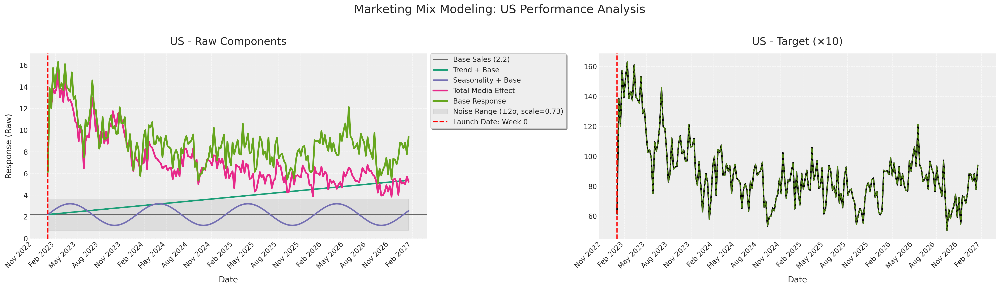

In [103]:
components_basic = {
    'base_sales': True,
    'trend': True,
    'seasonality': True,
    'individual_channels': False,
    'total_media': True,
    'base_response': True,
    'noise_line': False,
    'noise_range': True,
    'target': True,
    'scaled_base': True,
    'promo_effects': False
}
fig = visualizer.plot_contributions(dataset, country_params, countries, components_basic)

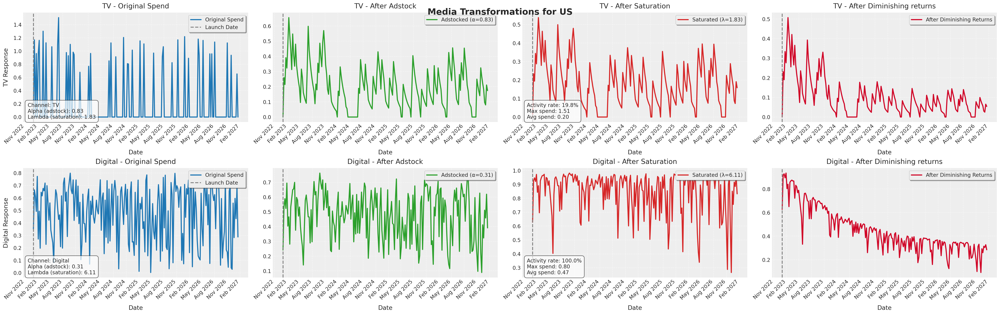

In [41]:
fig_2 = visualizer.plot_media_transformations(dataset, country_params, countries, dynamics_dict=dynamics_dict)

In [ ]:
# Compute ROAS on training set
roas_results = visualizer.calculate_simple_roas(
    dataset=dataset,
    countries=countries,
    channels=channels,
    time_constraint=dataset.sel(date=dataset.coords['date'].values[:-test_size]).date.values
)

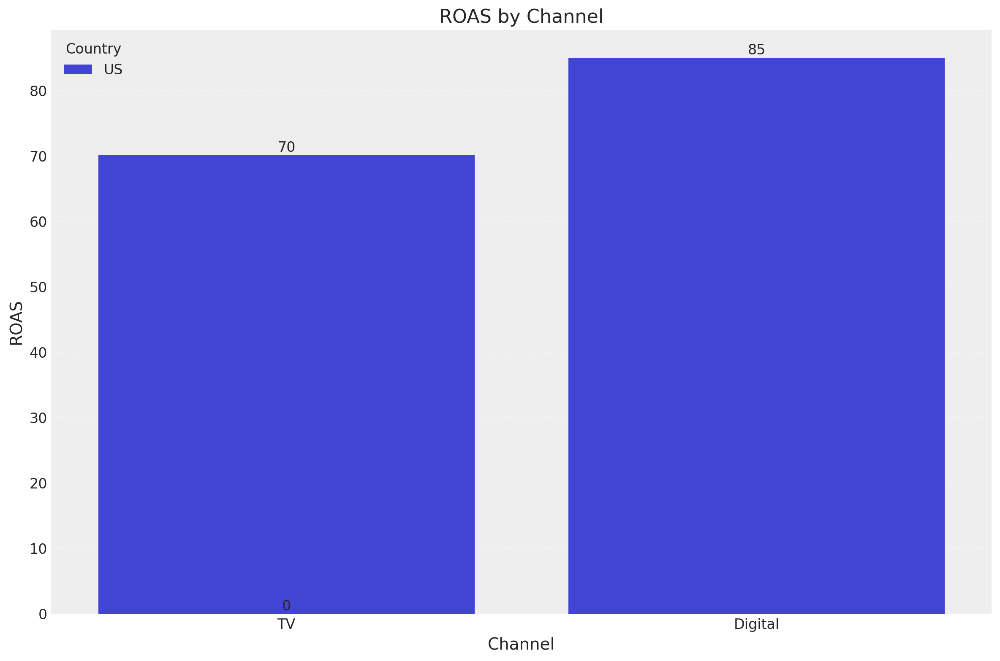

In [79]:
# Visualize results
fig = visualize_roas(
    roas_results,
    plot_type='bar'
)

## Compare performance from traditional models

[I 2025-03-20 20:13:18,601] A new study created in memory with name: no-name-b3727b0a-2785-4cff-ba2f-2957ac90396a


Starting MMM Analysis...

1. Training models for comparison...
  Training Linear Regression model...


[I 2025-03-20 20:14:03,709] Trial 0 finished with value: 15.595273562507241 and parameters: {'alpha_TV_spend': 0.41057441854856525, 'alpha_Digital_spend': 0.23993878726678775, 'linear_alpha': 0.02474686678460171}. Best is trial 0 with value: 15.595273562507241.
[I 2025-03-20 20:14:25,558] Trial 1 finished with value: 15.835659527116459 and parameters: {'alpha_TV_spend': 0.41153741858522735, 'alpha_Digital_spend': 0.4607398581317078, 'linear_alpha': 0.26360526715054994}. Best is trial 0 with value: 15.595273562507241.
[I 2025-03-20 20:14:42,398] Trial 2 finished with value: 15.676145600174568 and parameters: {'alpha_TV_spend': 0.42114984895900864, 'alpha_Digital_spend': 0.4141652236443404, 'linear_alpha': 0.15616027507535046}. Best is trial 0 with value: 15.595273562507241.
[I 2025-03-20 20:14:58,963] Trial 3 finished with value: 15.5938429794749 and parameters: {'alpha_TV_spend': 0.4175507700501932, 'alpha_Digital_spend': 0.08340025293790049, 'linear_alpha': 0.022625743859224827}. Best

  Training Linear Regression model with saturation transformation...


[I 2025-03-20 20:21:54,297] Trial 0 finished with value: 13.69023179578382 and parameters: {'alpha_TV_spend': 0.6684565958170285, 'lambda_TV_spend': 1, 'alpha_Digital_spend': 0.404326418036468, 'lambda_Digital_spend': 1, 'linear_alpha': 0.014738901716406775}. Best is trial 0 with value: 13.69023179578382.
[I 2025-03-20 20:22:10,397] Trial 1 finished with value: 15.841030472469086 and parameters: {'alpha_TV_spend': 0.7329049843472923, 'lambda_TV_spend': 7, 'alpha_Digital_spend': 0.03101027121663824, 'lambda_Digital_spend': 0, 'linear_alpha': 0.0819778696703829}. Best is trial 0 with value: 13.69023179578382.
[I 2025-03-20 20:22:29,589] Trial 2 finished with value: 16.491325997296677 and parameters: {'alpha_TV_spend': 0.6438588256360629, 'lambda_TV_spend': 10, 'alpha_Digital_spend': 0.3822166911896627, 'lambda_Digital_spend': 9, 'linear_alpha': 0.3599152659990744}. Best is trial 0 with value: 13.69023179578382.
[I 2025-03-20 20:22:46,623] Trial 3 finished with value: 17.52990283139264 an

  Training Gradient Boosting model...


[I 2025-03-20 20:30:06,624] Trial 0 finished with value: 12.893070140638718 and parameters: {'alpha_TV_spend': 0.35307433173726205, 'alpha_Digital_spend': 0.216660843722233, 'learning_rate': 0.0427226033450243, 'n_estimators': 144, 'max_depth': 3}. Best is trial 0 with value: 12.893070140638718.
[I 2025-03-20 20:30:20,633] Trial 1 finished with value: 12.886589710913952 and parameters: {'alpha_TV_spend': 0.35013965172365086, 'alpha_Digital_spend': 0.4558231472270442, 'learning_rate': 0.06507700393501636, 'n_estimators': 167, 'max_depth': 3}. Best is trial 1 with value: 12.886589710913952.
[I 2025-03-20 20:30:36,546] Trial 2 finished with value: 11.634779587468243 and parameters: {'alpha_TV_spend': 0.3274169461065685, 'alpha_Digital_spend': 0.10421958375386908, 'learning_rate': 0.04309584637319935, 'n_estimators': 127, 'max_depth': 2}. Best is trial 2 with value: 11.634779587468243.
[I 2025-03-20 20:30:50,548] Trial 3 finished with value: 12.195376803456734 and parameters: {'alpha_TV_sp

  Training Ensemble model...


[I 2025-03-20 20:37:35,447] Trial 0 finished with value: 14.45521517723267 and parameters: {'alpha_TV_spend': 0.3634917122108343, 'alpha_Digital_spend': 0.45402848595242523, 'linear_alpha': 0.0667661147382586, 'n_estimators': 181, 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 10}. Best is trial 0 with value: 14.45521517723267.
[I 2025-03-20 20:37:49,906] Trial 1 finished with value: 16.57437994935184 and parameters: {'alpha_TV_spend': 0.396190760742309, 'alpha_Digital_spend': 0.16021641454091395, 'linear_alpha': 5.6562790032411145, 'n_estimators': 58, 'max_depth': 14, 'min_samples_split': 12, 'min_samples_leaf': 4}. Best is trial 0 with value: 14.45521517723267.
[I 2025-03-20 20:38:05,166] Trial 2 finished with value: 13.029379581423925 and parameters: {'alpha_TV_spend': 0.5201822815501469, 'alpha_Digital_spend': 0.25167050389307416, 'linear_alpha': 0.09713761658838989, 'n_estimators': 284, 'max_depth': 14, 'min_samples_split': 14, 'min_samples_leaf': 3}. Best is trial 2 


2. Evaluating models...
  Linear Regression Results:
    RMSE:  17.84
    R²:    -0.7592
    MAPE:  0.1867
    NRMSE: 0.2522
  Linear Regression With Saturation Results:
    RMSE:  19.39
    R²:    -1.0780
    MAPE:  0.2079
    NRMSE: 0.2741
  Gradient Boosting Results:
    RMSE:  9.44
    R²:    0.5073
    MAPE:  0.0942
    NRMSE: 0.1335
  Ensemble Results:
    RMSE:  13.17
    R²:    0.0414
    MAPE:  0.1277
    NRMSE: 0.1862

3. Plotting predictions vs actual...


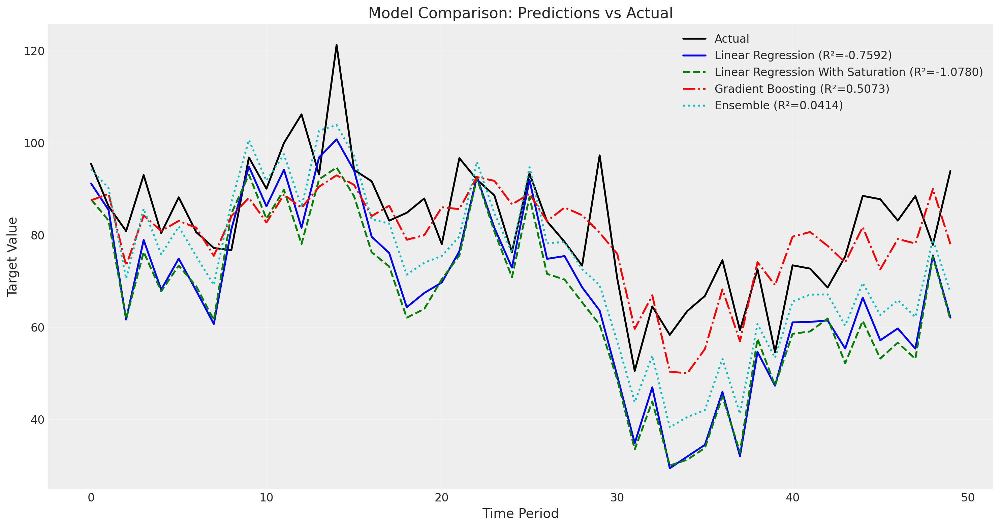


4. SHAP Analysis for all models...

  Analyzing Linear Regression...
  Plotting SHAP Feature Importance for Linear Regression...


<Figure size 1500x800 with 0 Axes>

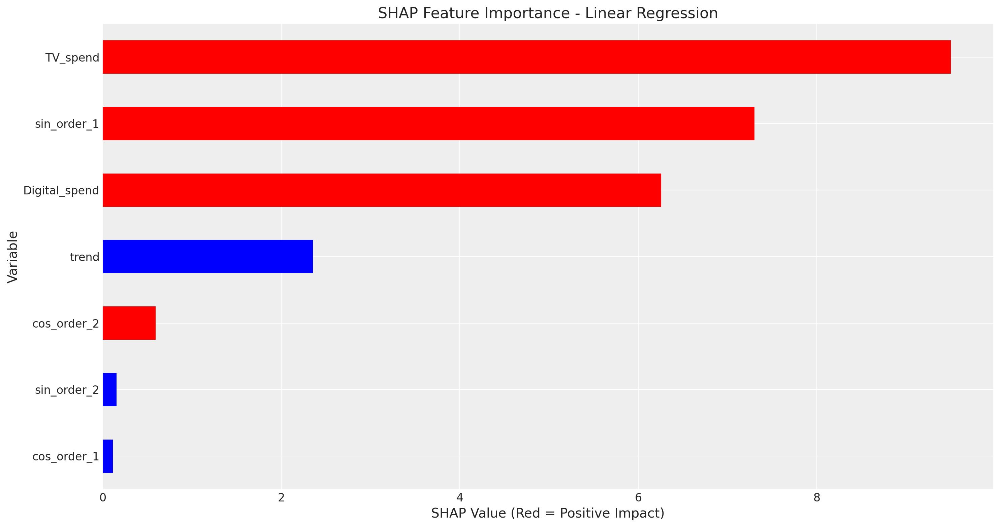


  Analyzing Linear Regression With Saturation...
  Plotting SHAP Feature Importance for Linear Regression With Saturation...


<Figure size 1500x800 with 0 Axes>

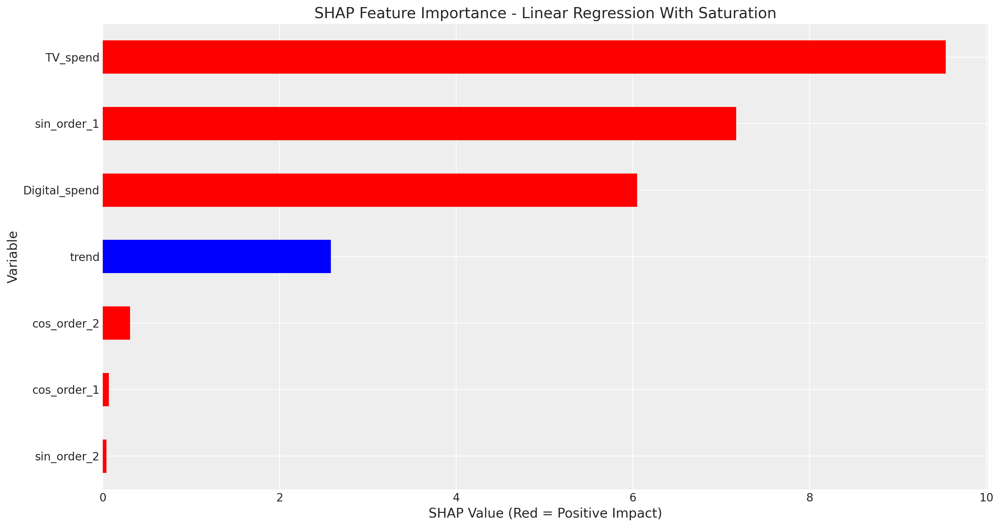


  Analyzing Gradient Boosting...
  Plotting SHAP Feature Importance for Gradient Boosting...


<Figure size 1500x800 with 0 Axes>

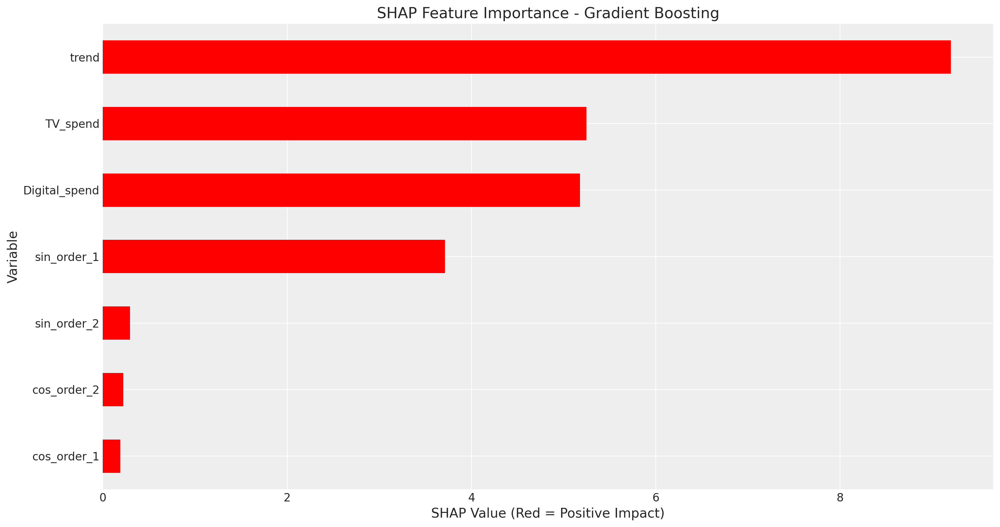


  Analyzing Ensemble...


  0%|          | 0/50 [00:00<?, ?it/s]

  Plotting SHAP Feature Importance for Ensemble...


<Figure size 1500x800 with 0 Axes>

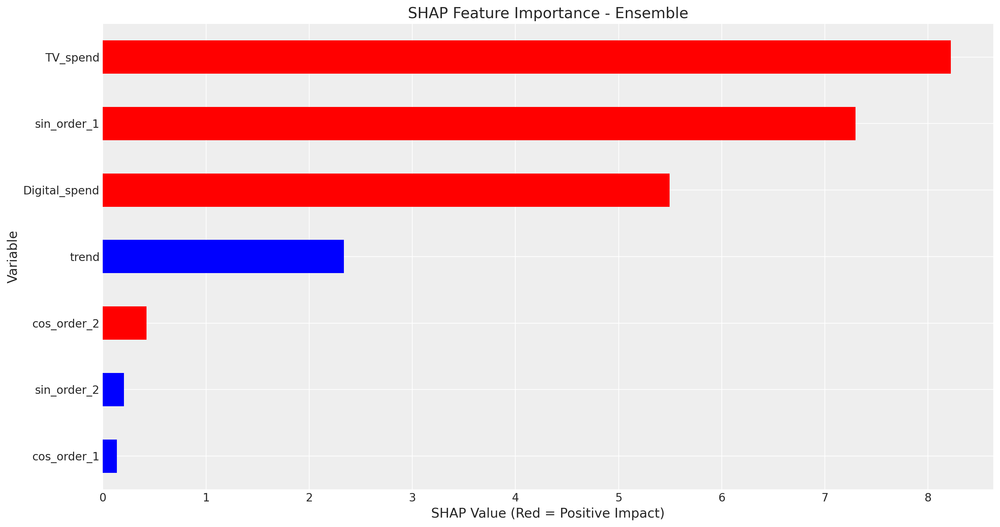


5. SHAP vs Spend Analysis for Media Channels...

  Analyzing SHAP vs Spend for Linear Regression...


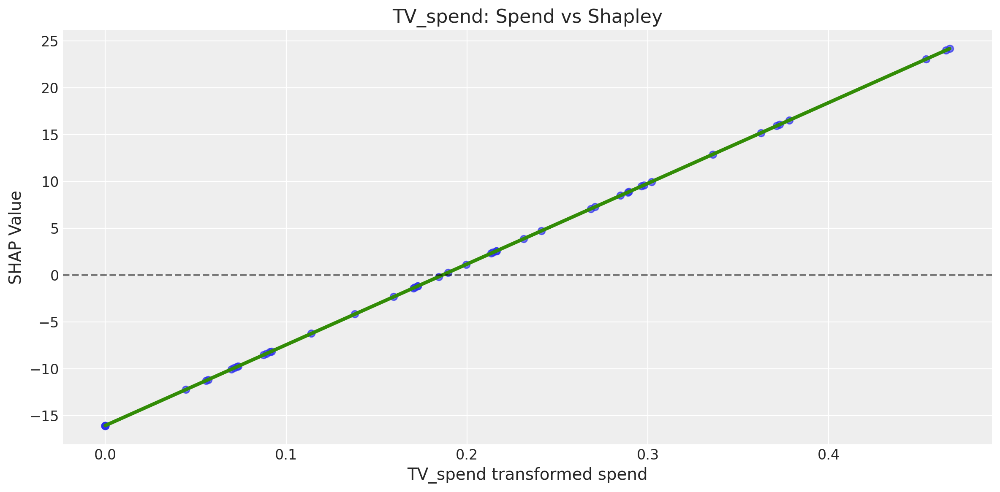

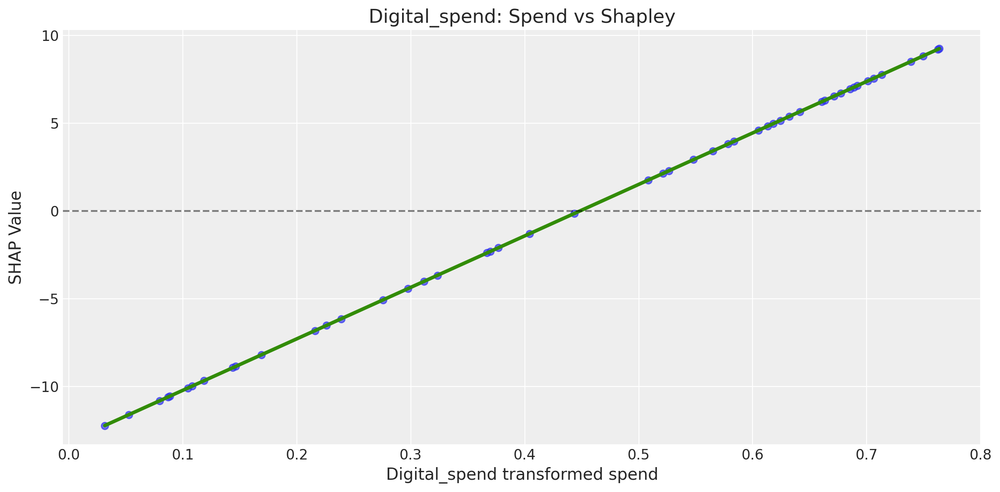


  Analyzing SHAP vs Spend for Linear Regression With Saturation...


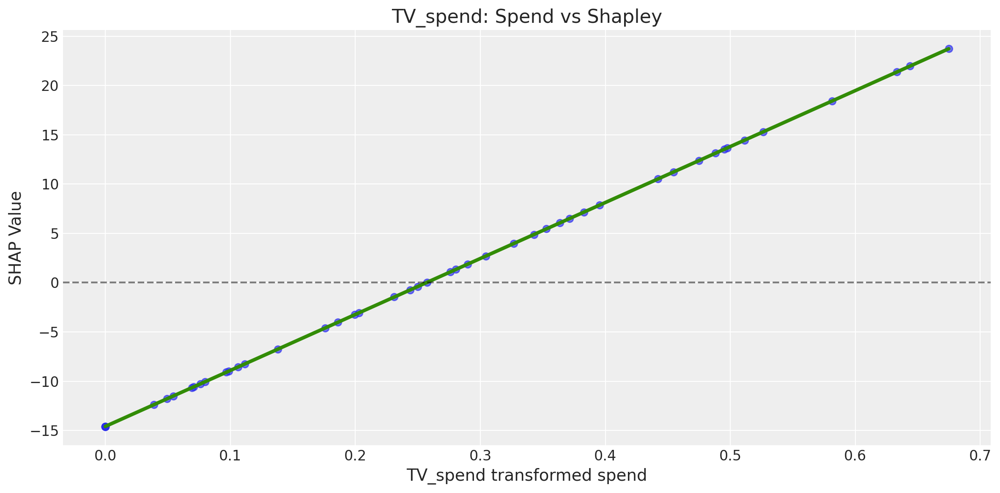

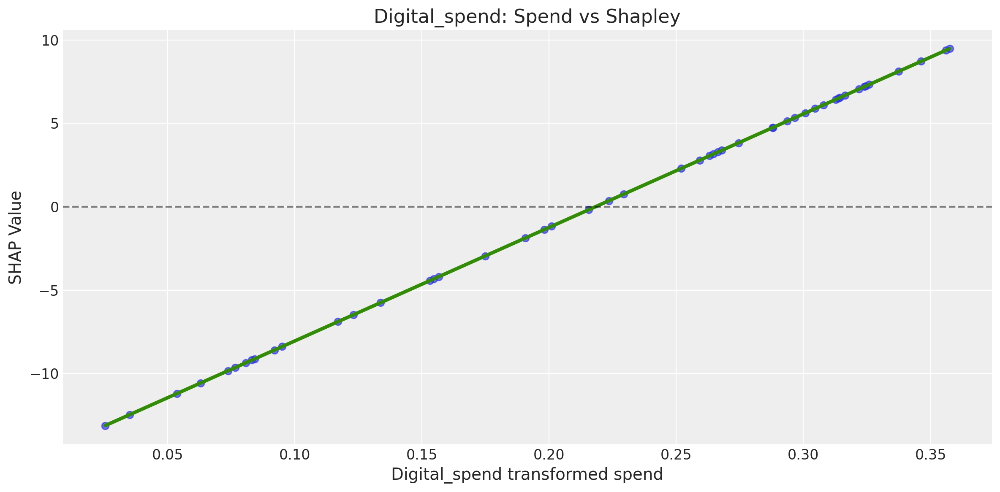


  Analyzing SHAP vs Spend for Gradient Boosting...


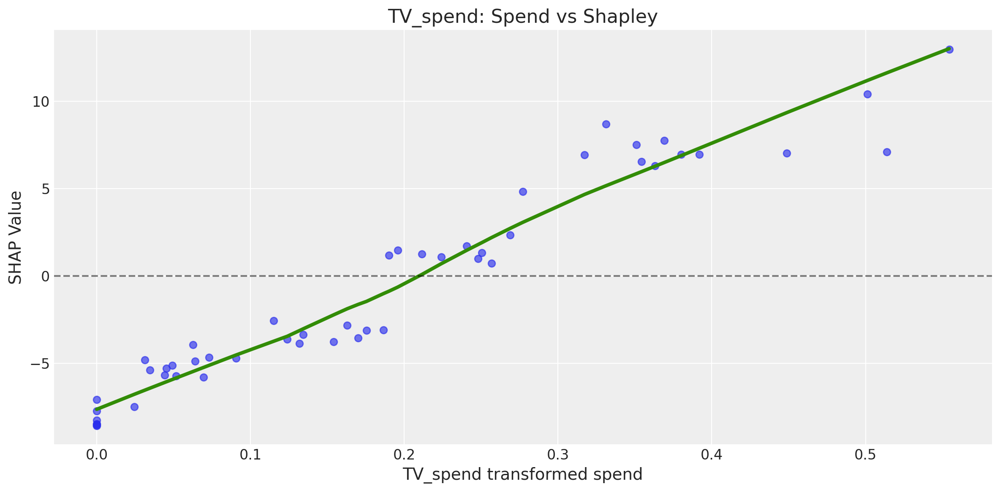

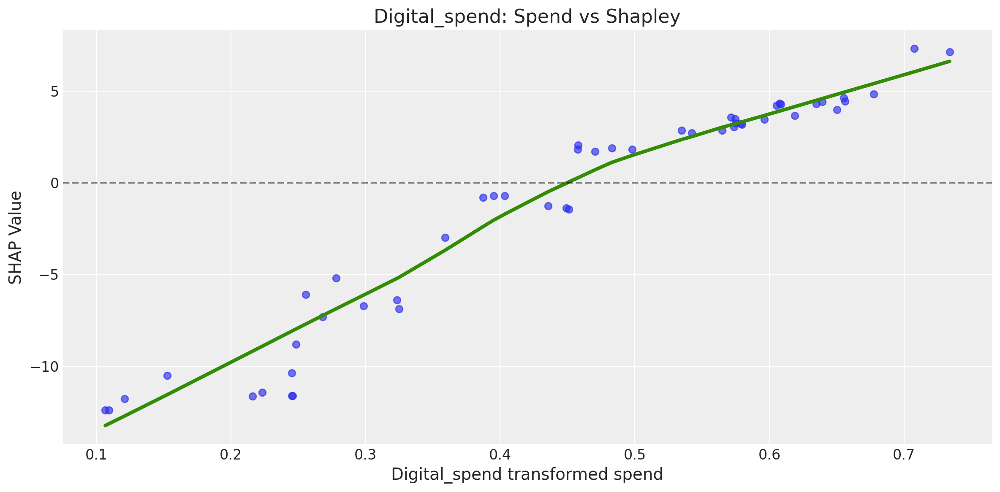


  Analyzing SHAP vs Spend for Ensemble...


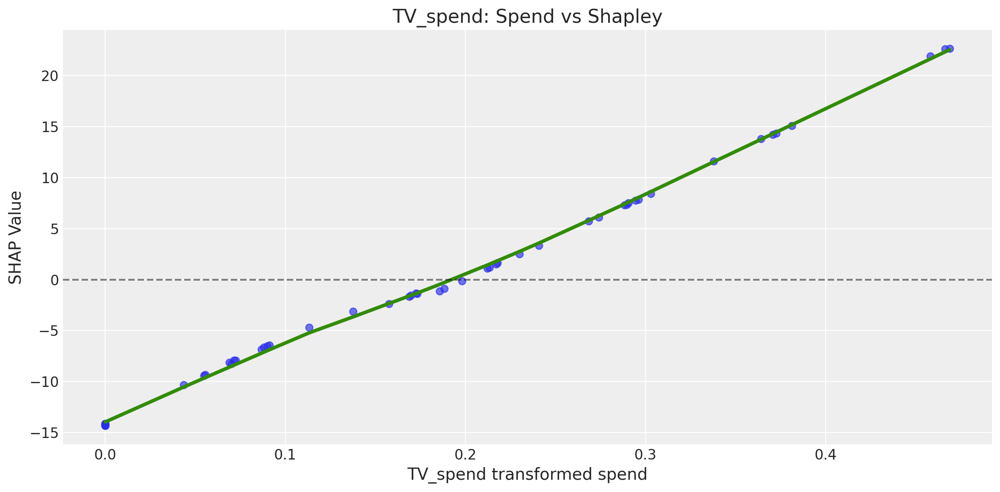

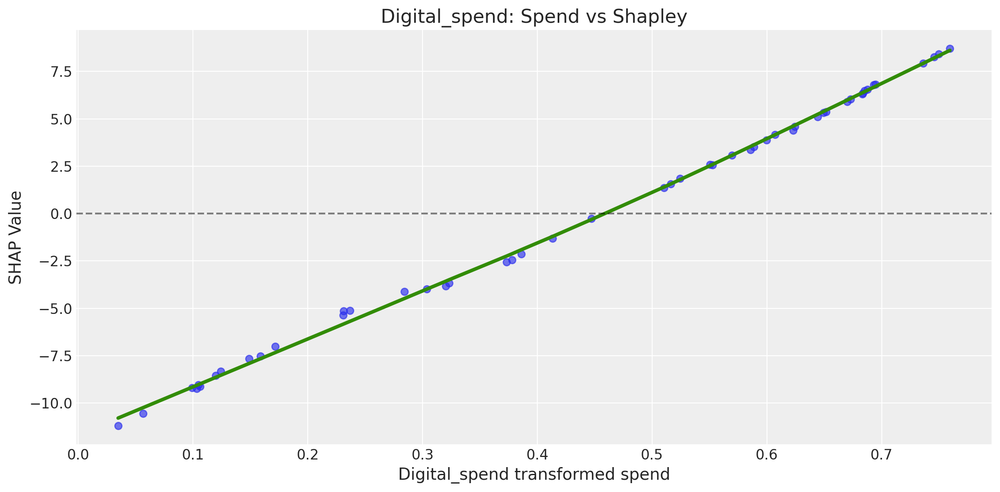


6. Comparing Adstock Parameters Across Models...
               Linear Regression  Linear Regression With Saturation  \
TV_spend                0.798700                           0.714263   
Digital_spend           0.061163                           0.180863   

               Gradient Boosting  Ensemble  
TV_spend                0.706881  0.794815  
Digital_spend           0.361377  0.092152  


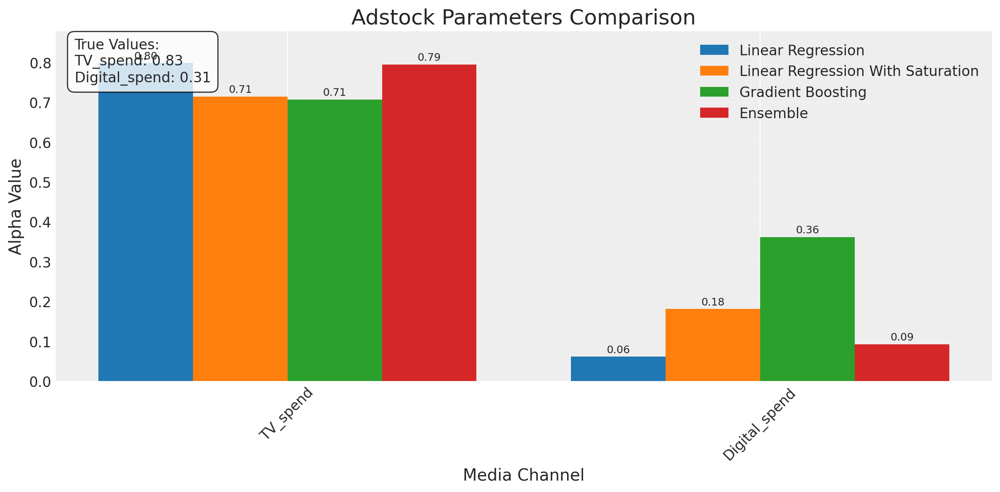


Calculating incremental ROAS for Linear Regression...
Generated baseline predictions, shape: (162,)
  Processing channel: TV_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 11859.17
    Incremental contribution: 2850.33
    Total spend: 33.72
    Incremental ROAS: 84.52
  Processing channel: Digital_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 12418.72
    Incremental contribution: 2290.78
    Total spend: 78.15
    Incremental ROAS: 29.31

Calculating incremental ROAS for Linear Regression With Saturation...
Generated baseline predictions, shape: (162,)
  Processing channel: TV_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 12128.67
    Incremental contribution: 2580.83
    Total spend: 33.72
    Incremental ROAS: 76.53
  Processing channel: Digital_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 12119.75
    Incremental contribution: 2589.75
    Total spend: 78.15
    Incremental ROAS: 33.14

Calculating incremental ROAS for Gradient Boosting...
Generated bas

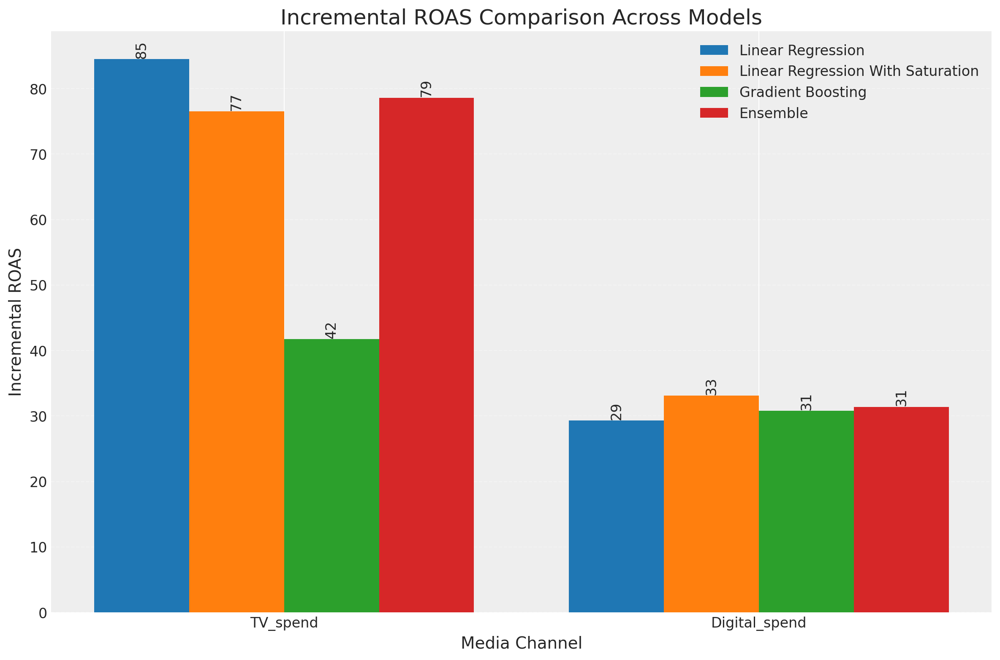


MMM Analysis Complete!


In [ ]:
# Media features
media_columns = ["TV_spend", "Digital_spend"]
spend_df = pd.DataFrame(dataset.sel(country="US").spends, columns=media_columns)

# Trend features

trend = pd.DataFrame({"trend": np.arange(len(dataset.date))})

# Your existing code for Fourier features
n_order = 2
periods = dataset.date.dt.dayofyear / 365.25
fourier_features = pd.DataFrame(
    {
        f"{func}_order_{order}": getattr(np, func)(2 * np.pi * periods * order)
        for order in range(1, n_order + 1)
        for func in ("sin", "cos")
    }
)

# Combine features
X = pd.concat([trend, spend_df, fourier_features], axis=1)
y = pd.Series(dataset.target.values.reshape(-1,), index=X.index)

# Define alpha ranges for media channels
alpha_ranges = {}
lambda_ranges = {}
for col in media_columns:
    if 'TV' in col.upper():
        alpha_ranges[col] = (0.3, 0.8)
        lambda_ranges[col] = (0,10)
    elif 'RADIO' in col.upper():
        alpha_ranges[col] = (0.1, 0.5)
    elif 'OOH' in col.upper():
        alpha_ranges[col] = (0.1, 0.4)
    elif 'DIGITAL' in col.upper() or 'SEARCH' in col.upper():
        alpha_ranges[col] = (0.0, 0.5)
        lambda_ranges[col] = (0,10)
    else:
        alpha_ranges[col] = (0.1, 0.7)

# Run the complete analysis
results = run_mmm_analysis(
    X=X,
    y=y,
    media_columns=media_columns,
    alpha_ranges=alpha_ranges,
    lambda_ranges=lambda_ranges,
    is_multiobjective=False,
    test_size=50,
    n_trials=30  # You might want to increase this for better results
)


[I 2025-03-21 09:49:06,591] A new study created in memory with name: no-name-c90d227a-5f0a-4c57-935e-65bdd2f976ae


Starting MMM Analysis...

1. Training selected models for comparison...
  Training Gradient Boosting model...


[I 2025-03-21 09:49:19,767] Trial 0 finished with value: 13.903187619817533 and parameters: {'alpha_TV_spend': 0.5634840862842547, 'alpha_Digital_spend': 0.09763576353318759, 'learning_rate': 0.2738526358084985, 'n_estimators': 69, 'max_depth': 6}. Best is trial 0 with value: 13.903187619817533.
[I 2025-03-21 09:49:34,410] Trial 1 finished with value: 16.252324851472856 and parameters: {'alpha_TV_spend': 0.3064698185858509, 'alpha_Digital_spend': 0.17143248298532476, 'learning_rate': 0.010574399113679798, 'n_estimators': 87, 'max_depth': 3}. Best is trial 0 with value: 13.903187619817533.
[I 2025-03-21 09:49:45,808] Trial 2 finished with value: 14.144170697240014 and parameters: {'alpha_TV_spend': 0.5864875721650349, 'alpha_Digital_spend': 0.0488150413565695, 'learning_rate': 0.17157154170979386, 'n_estimators': 154, 'max_depth': 6}. Best is trial 0 with value: 13.903187619817533.
[I 2025-03-21 09:49:56,557] Trial 3 finished with value: 15.098449551086384 and parameters: {'alpha_TV_spe


2. Evaluating models...
  Gradient Boosting Results:
    RMSE:  8.67
    R²:    0.5842
    MAPE:  0.0862
    NRMSE: 0.1226

3. Plotting predictions vs actual...


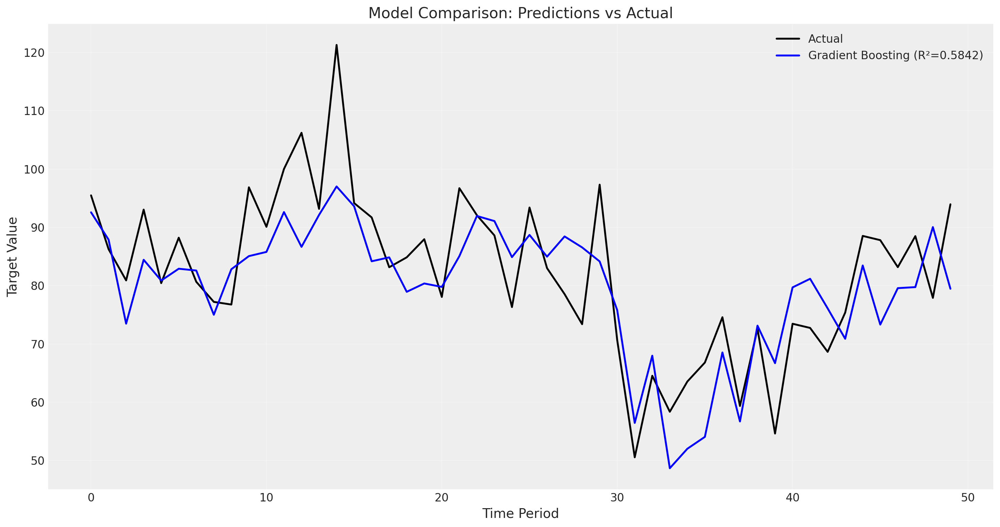


4. SHAP Analysis for all models...

  Analyzing Gradient Boosting...
  Plotting SHAP Feature Importance for Gradient Boosting...


<Figure size 1500x800 with 0 Axes>

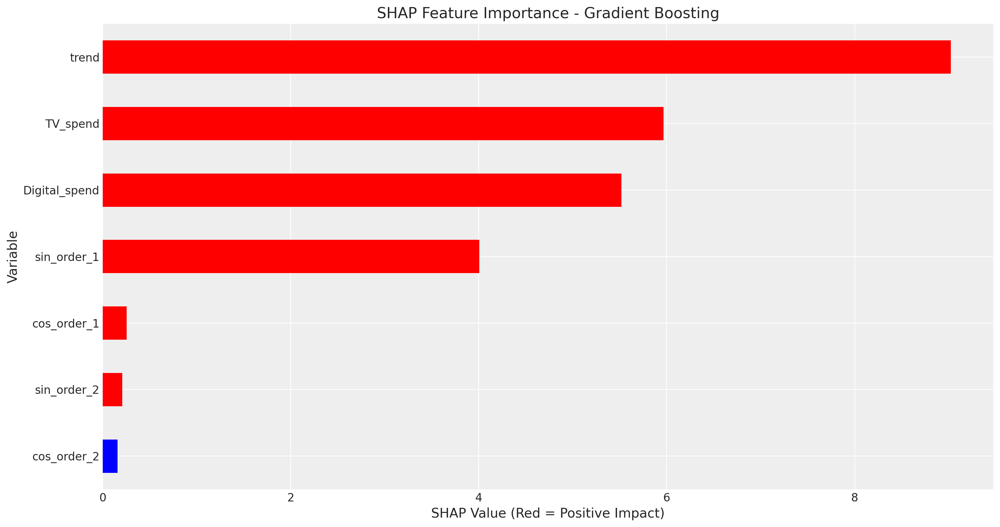


5. SHAP vs Spend Analysis for Media Channels...

  Analyzing SHAP vs Spend for Gradient Boosting...


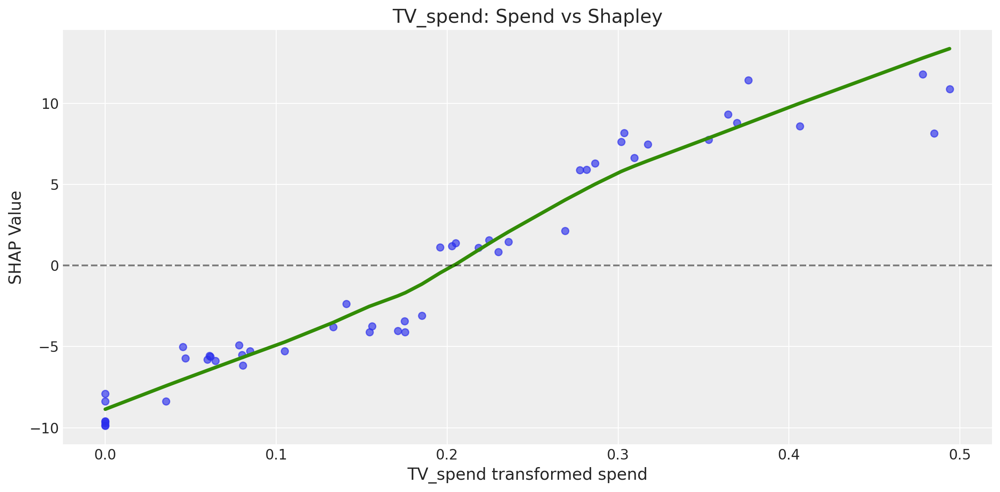

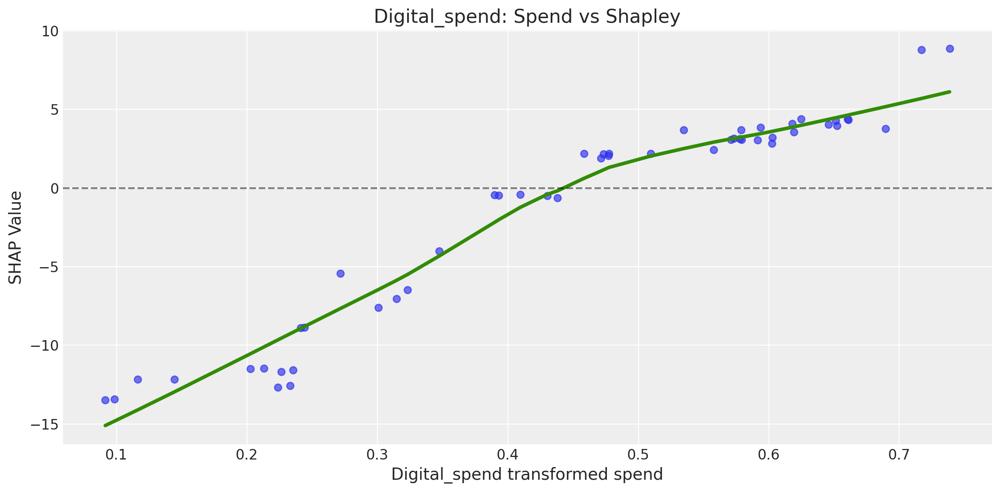


6. Comparing Adstock Parameters Across Models...
               Gradient Boosting
TV_spend                0.761769
Digital_spend           0.318965


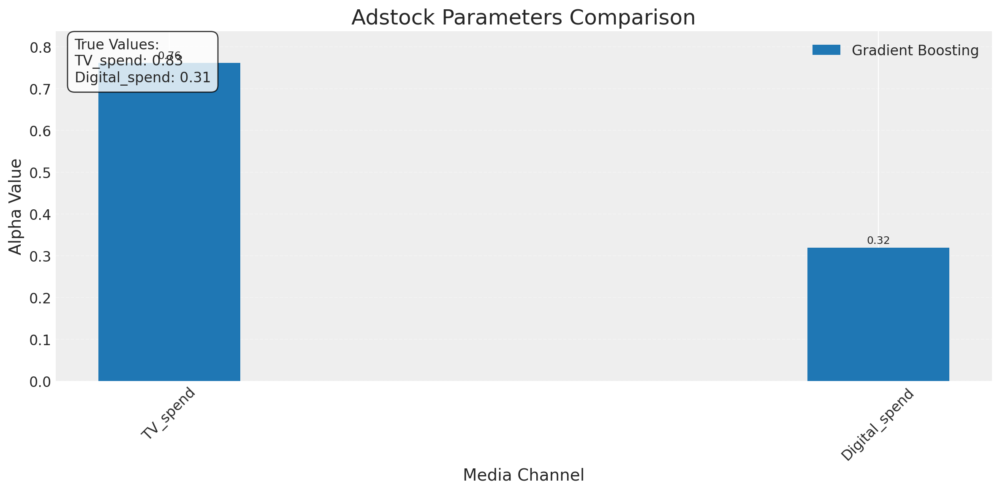


Calculating incremental ROAS for Gradient Boosting...
Generated baseline predictions, shape: (162,)
  Processing channel: TV_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 13025.43
    Incremental contribution: 1684.07
    Total spend: 33.72
    Incremental ROAS: 49.94
  Processing channel: Digital_spend
    Baseline sum: 14709.50
    Zeroed-out sum: 12341.22
    Incremental contribution: 2368.28
    Total spend: 78.15
    Incremental ROAS: 30.30

Visualizing ROAS comparison across models...

ROAS Comparison Table:
Model          Gradient Boosting
Channel                         
Digital_spend              30.30
TV_spend                   49.94


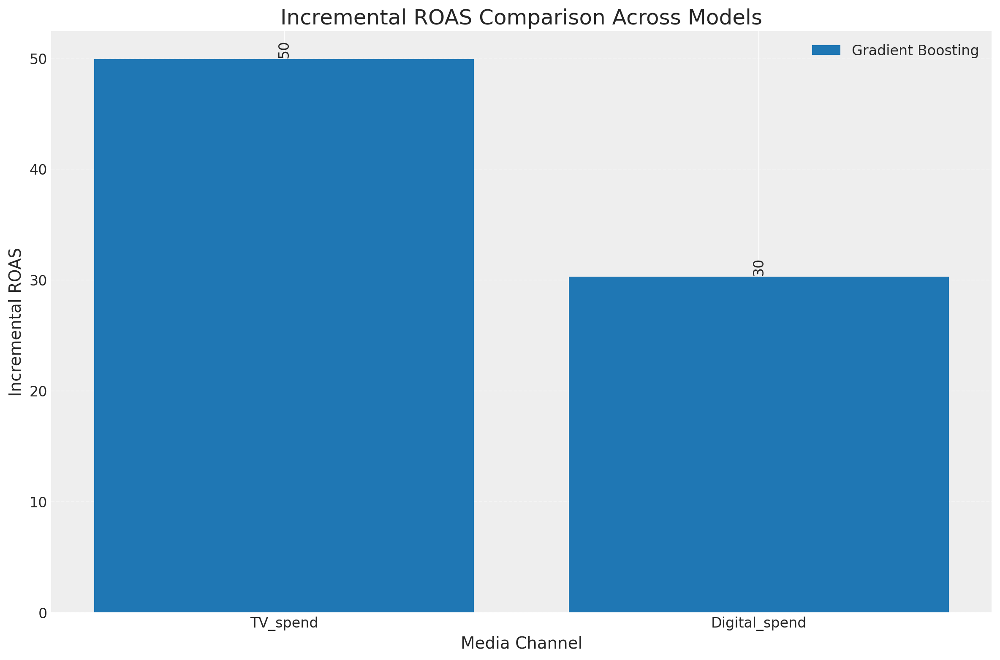


MMM Analysis Complete!


In [ ]:
# Run the analysis only for GBM and boosting the optuna's proces with more trials
results = run_mmm_analysis(
    X=X,
    y=y,
    media_columns=media_columns,
    alpha_ranges=alpha_ranges,
    lambda_ranges=lambda_ranges,
    is_multiobjective=False,
    test_size=50,
    n_trials=100,
    models_to_include=['gb']
)


### SHAP values over time

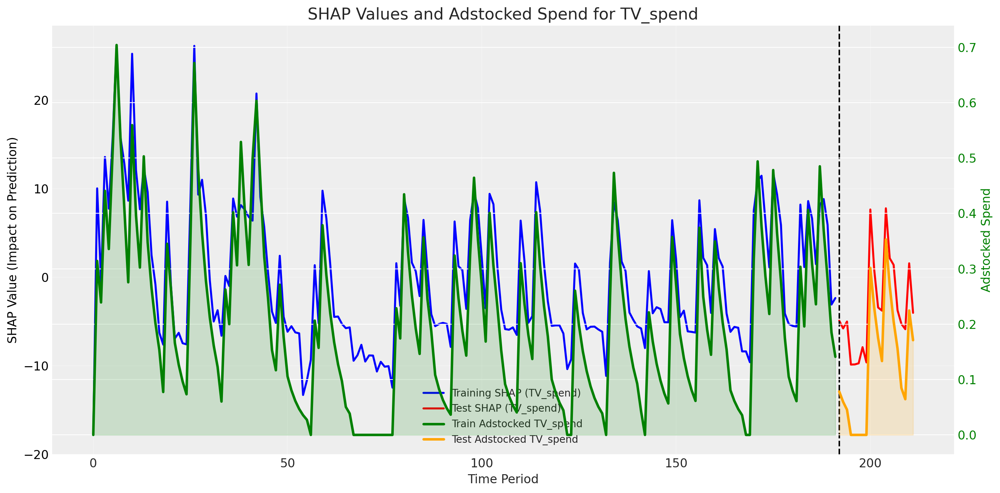

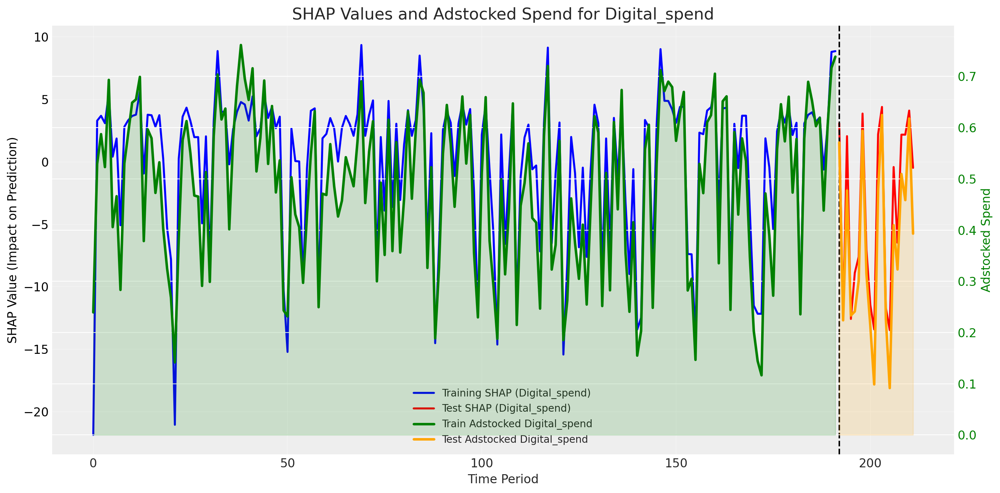

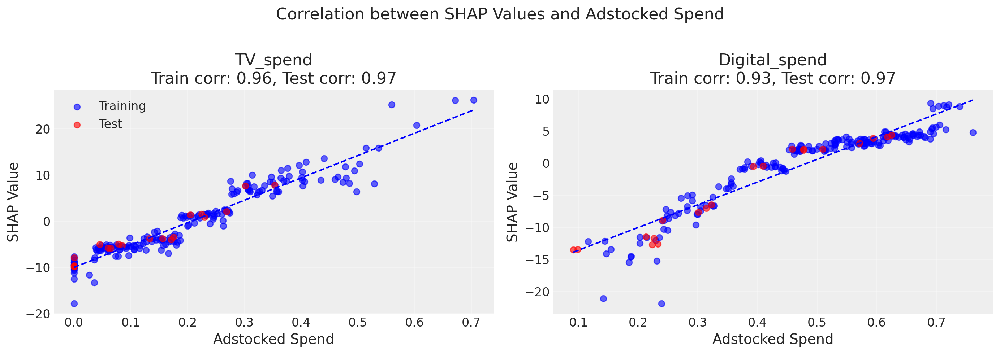

In [ ]:

# Parameters based on your provided context
train_indices = list(range(len(X) - test_size))
test_indices = list(range(len(X) - test_size, len(X)))

# Get the GBM model from results
model_gb = results["models"]["Gradient Boosting"]

# Check if model exists and has the necessary attributes
if model_gb is None:
    print("GBM model not found or not properly trained")
else:
    # Get the transformed data with adstocked values
    X_full_adstocked = model_gb.X_full_adstocked

    # Create SHAP explainer
    explainer = shap.TreeExplainer(model_gb.model)

    # Get SHAP values for both train and test sets
    train_shap_values = explainer.shap_values(X_full_adstocked.iloc[train_indices])
    test_shap_values = explainer.shap_values(X_full_adstocked.iloc[test_indices])

    # Convert to DataFrames
    train_shap_df = pd.DataFrame(train_shap_values, columns=X_full_adstocked.columns)
    test_shap_df = pd.DataFrame(test_shap_values, columns=X_full_adstocked.columns)

    # Check if date column exists
    date_column = 'date' if 'date' in X.columns else None

    # Add dates if available
    if date_column and date_column in X.columns:
        train_dates = X[date_column].iloc[train_indices].values
        test_dates = X[date_column].iloc[test_indices].values
        train_shap_df['date'] = train_dates
        test_shap_df['date'] = test_dates
        x_train = train_dates
        x_test = test_dates
    else:
        # Use index as x-axis
        x_train = np.arange(len(train_indices))
        x_test = np.arange(len(train_indices), len(train_indices) + len(test_indices))
        train_shap_df['period'] = x_train
        test_shap_df['period'] = x_test

    # Get media columns from alpha_ranges keys
    media_columns = list(alpha_ranges.keys())

    # Plot SHAP values over time for each media channel - ENHANCED SINGLE PLOT
    for i, channel in enumerate(media_columns):
        if channel in X_full_adstocked.columns:
            # Create a single plot with two y-axes
            fig, ax1 = plt.subplots(figsize=(14, 7))

            # Plot SHAP values on primary y-axis
            line1 = ax1.plot(x_train, train_shap_df[channel], 'b-', linewidth=2,
                           label=f'Training SHAP ({channel})')
            line2 = ax1.plot(x_test, test_shap_df[channel], 'r-', linewidth=2,
                           label=f'Test SHAP ({channel})')

            # Add train/test split line
            if date_column and date_column in X.columns:
                split_date = X[date_column].iloc[train_indices[-1]]
                ax1.axvline(x=split_date, color='k', linestyle='--', label='Train/Test Split')
                ax1.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
                plt.xticks(rotation=45)
            else:
                ax1.axvline(x=len(train_indices), color='k', linestyle='--', label='Train/Test Split')

            # Configure primary y-axis
            ax1.set_xlabel('Time Period' if not date_column else 'Date', fontsize=12)
            ax1.set_ylabel('SHAP Value (Impact on Prediction)', fontsize=12, color='black')
            ax1.tick_params(axis='y', labelcolor='black')

            # Create second y-axis for adstocked spend
            ax2 = ax1.twinx()

            # Get adstocked spend values
            adstock_spend_train = X_full_adstocked[channel].iloc[train_indices].values
            adstock_spend_test = X_full_adstocked[channel].iloc[test_indices].values

            # Plot adstocked spend with thicker, more visible line
            line3 = ax2.plot(x_train, adstock_spend_train, color='green', linewidth=2.5,
                           linestyle='-', label=f'Train Adstocked {channel}')
            line4 = ax2.plot(x_test, adstock_spend_test, color='orange', linewidth=2.5,
                           linestyle='-', label=f'Test Adstocked {channel}')

            # Highlight adstocked spend with shading
            ax2.fill_between(x_train, 0, adstock_spend_train, color='green', alpha=0.15)
            ax2.fill_between(x_test, 0, adstock_spend_test, color='orange', alpha=0.15)

            # Configure secondary y-axis
            ax2.set_ylabel('Adstocked Spend', fontsize=12, color='green')
            ax2.tick_params(axis='y', labelcolor='green')

            # Combine legends
            lines = line1 + line2 + line3 + line4
            labels = [l.get_label() for l in lines]
            ax1.legend(lines, labels, loc='best', fontsize=10)

            # Add title and grid
            plt.title(f'SHAP Values and Adstocked Spend for {channel}', fontsize=16)
            ax1.grid(True, alpha=0.3)

            plt.tight_layout()
            plt.show()

    # Filter media columns to only include those in the SHAP values DataFrame
    valid_media_columns = [col for col in media_columns if col in train_shap_df.columns]

    # Create correlation scatter plots of SHAP values vs adstocked spend
    n_cols = min(2, len(valid_media_columns))
    n_rows = (len(valid_media_columns) + n_cols - 1) // n_cols

    plt.figure(figsize=(14, 5 * n_rows))
    plt.suptitle('Correlation between SHAP Values and Adstocked Spend', fontsize=16, y=0.98)

    for i, channel in enumerate(valid_media_columns):
        plt.subplot(n_rows, n_cols, i+1)

        # Get data for training set
        x_vals = X_full_adstocked[channel].iloc[train_indices].values
        y_vals = train_shap_df[channel].values

        # Calculate correlation for training set
        train_corr = np.corrcoef(x_vals, y_vals)[0, 1]

        # Create scatter plot for training set
        plt.scatter(x_vals, y_vals, alpha=0.6, color='blue', label='Training')

        # Get data for test set
        x_vals_test = X_full_adstocked[channel].iloc[test_indices].values
        y_vals_test = test_shap_df[channel].values

        # Calculate correlation for test set
        test_corr = np.corrcoef(x_vals_test, y_vals_test)[0, 1]

        # Add test set points
        plt.scatter(x_vals_test, y_vals_test, alpha=0.6, color='red', label='Test')

        # Add best fit line for training data
        if len(x_vals) > 1:
            m, b = np.polyfit(x_vals, y_vals, 1)
            x_line = np.linspace(min(min(x_vals), min(x_vals_test)),
                                max(max(x_vals), max(x_vals_test)), 100)
            plt.plot(x_line, m * x_line + b, '--', color='blue')

        # Add title and correlation values
        plt.title(f'{channel}\nTrain corr: {train_corr:.2f}, Test corr: {test_corr:.2f}')
        plt.xlabel('Adstocked Spend')
        plt.ylabel('SHAP Value')
        plt.grid(True, alpha=0.3)

        if i == 0:
            plt.legend()

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

## Bayesian model with diminishing effects

### Index Scaling

In [44]:
index_scaler = StandardScaler()

full_range = np.arange(0, len(dataset.date)).reshape(-1, 1)
full_index_scaled = index_scaler.fit_transform(full_range)

# Split into train and test afterward
index_train_scaled = full_index_scaled[:len(dataset.date)-test_size]
index_test_scaled = full_index_scaled[len(dataset.date)-test_size:]

# Save the scale for other calculations
index_std = index_scaler.scale_.item()

### Data scaling

In [45]:
dataset['target_scaled'] = xr.DataArray(
    np.zeros((len(dataset.date), len(countries))),
    coords={'date': dataset.date, 'country': countries},
    dims=['date', 'country']
)

dataset['z_scaled'] = xr.DataArray(
    np.zeros((len(dataset.date), len(channels), len(countries))),
    coords={'date': dataset.date, 'channel': channels, 'country': countries},
    dims=['date', 'channel', 'country']
)


# Instantiate scalers
target_scaler = MaxAbsScaler()
channel_scaler = MaxAbsScaler()

# Fit scalers
target = dataset.target.values.reshape(-1, 1)
spend = dataset.spends.values.reshape(-1, dataset.spends.shape[-1])

target_train = target[None:-test_size]
target_test = target[-test_size:None]


spend_train = spend[None:-test_size]
spend_test = spend[-test_size:None]

target_scaler.fit(target_train)
channel_scaler.fit(spend_train)


# Then apply scaling
for i, country in enumerate(countries):

    target_scaled = target_scaler.transform(target_train.reshape(-1,1)).flatten()
    target_test_scaled = target_scaler.transform(target_test.reshape(-1,1)).flatten()
    z_scaled = channel_scaler.transform(spend_train)
    z_test_scaled = channel_scaler.transform(spend_test)


In [46]:
channel_share_array = np.zeros((len(channels), len(countries)))

# Get
for i, country in enumerate(countries):
    y = dataset.target.sel(country=country)
    spends = dataset.spends.sel(country=country)

    # Calculate channel shares
    channel_share_array[:,i] = (spends.sum(axis=0) / spends.sum().sum())*len(channels)

### Model specification with time varying parameter

In [47]:
approx_hsgp_hyperparams(
        full_index_scaled,
        0,
        lengthscale_range=[0.34,1.7],
        cov_func="expquad")


(27, array([3.1556356]))

/Users/damien/.pyenv/versions/3.10.6/envs/lewagon/lib/python3.10/site-packages/pymc/model/core.py:988: FutureWarning: Coords are now always mutable. Specifying `mutable` will raise an error in a future release
  warnings.warn(
Sampling: [a, alpha, amplitude_trend, b_fourier, b_trend, b_z, lam, likelihood, ls_trend, nu, sigma, trend_coeffs]


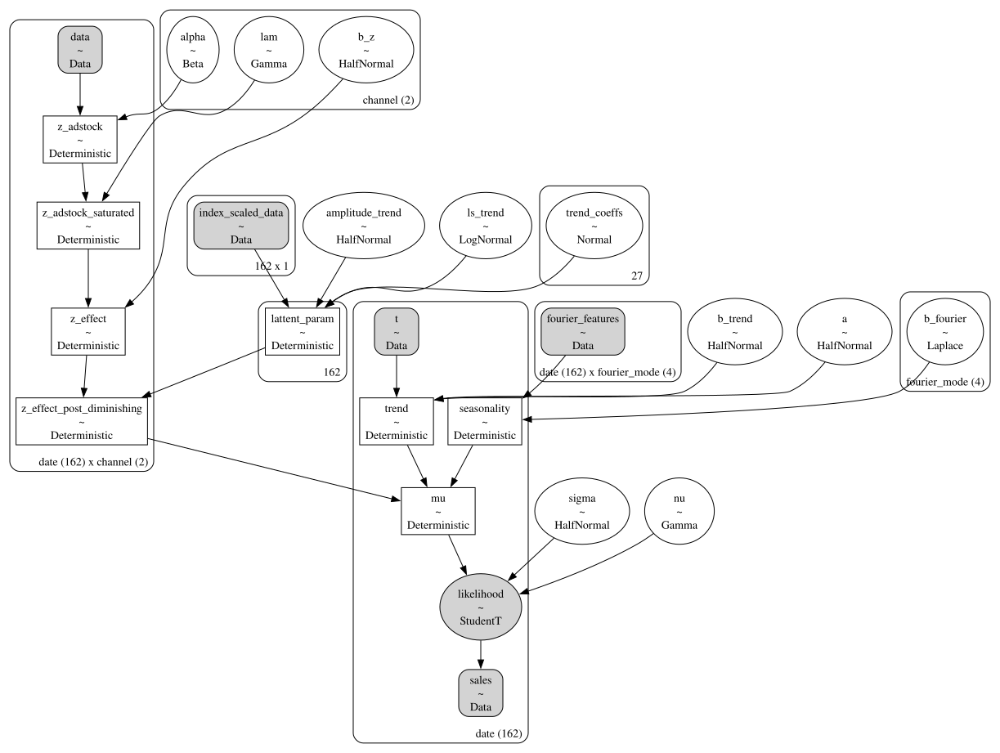

In [ ]:
n_order = 2
dates = dataset.date.values[None:-test_size]
coords = {"channel": channels, "fourier_mode": np.arange(2 * n_order)}


with pm.Model(coords=coords) as tvp_model:
    # --- coords --- #
    tvp_model.add_coord(name="date", values=dates, mutable=True)

    # --- data containers --- #
    index_scaled_data = pm.Data(
        name="index_scaled_data",
        value=index_train_scaled,
    )

    data = pm.Data(
       "data",
       z_scaled,
       dims=("date", "channel"),
      # coords=dataset.date.values
    )

    fourier_feature_data = pm.Data(
        "fourier_features",
        fourier_features[None:-test_size],
        dims=("date", "fourier_mode")
    )

    t_data = pm.Data(
        "t",
        t_train,
        dims="date"
    )

    sales_data = pm.Data(
        "sales",
        target_scaled,
        dims="date"
    )

    # --- priors --- #
    ## intercept
    a = pm.HalfNormal(name="a", sigma=0.1)
    ## trend
    b_trend = pm.HalfNormal(name="b_trend", sigma=2)
    ## adstock effect
    alpha = pm.Beta(name="alpha", alpha=2, beta=2, dims="channel")
    ## saturation effect
    lam = pm.Gamma(name="lam", alpha=2, beta=1, dims="channel")
    ## seasonality
    b_fourier = pm.Laplace(name="b_fourier", mu=0, b=0.2, dims="fourier_mode")
    ## regressor
    b_z = pm.HalfNormal(name="b_z", sigma=np.array(channel_share_array).reshape(-1,1).flatten(), dims="channel")
    ## standard deviation of the normal likelihood
    sigma = pm.HalfNormal(name="sigma", sigma=0.5)
    ## gaussian random walk standard deviation
    amplitude_trend = pm.HalfNormal(name="amplitude_trend", sigma=2)

    ls_trend = pm.LogNormal(name="ls_trend", mu=np.log(1), sigma=1)

    # degrees of freedom of the t distribution
    nu = pm.Gamma(name="nu", alpha=25, beta=2)

    # --- model parametrization --- #
    trend = pm.Deterministic(name="trend", var=a + b_trend * t_data, dims="date")
    seasonality = pm.Deterministic(
        name="seasonality", var=pm.math.dot(fourier_feature_data, b_fourier), dims="date"
    )



    # Use ExpQuad for smoother decay transitions
    cov_trend = amplitude_trend * pm.gp.cov.ExpQuad(input_dim=1, ls=ls_trend)

    # Increase m and c for better approximation quality
    # The documentation recommends higher m values for capturing small-scale variations and higher c values for better handling of boundaries
    gp_trend = pm.gp.HSGP(m=[27], c=3.15, cov_func=cov_trend)

    # Use prior_linearized instead of prior
    phi_trend, sqrt_psd_trend = gp_trend.prior_linearized(index_scaled_data)
    trend_coeffs = pm.Normal("trend_coeffs", size=27)
    lattent_param = pm.Deterministic("lattent_param", phi_trend @ (trend_coeffs * sqrt_psd_trend))

    z_adstock = pm.Deterministic(
        name="z_adstock", var=geometric_adstock(x=data, alpha=alpha, l_max=8, normalize=True), dims=("date","channel")
    )

    z_adstock_saturated = pm.Deterministic(
        name="z_adstock_saturated",
        var=logistic_saturation(x=z_adstock, lam=lam),
        dims=("date","channel"),
    )

    z_effect = pm.Deterministic(
        name="z_effect", var=b_z * z_adstock_saturated, dims=("date","channel")
    )

    z_effect_post_diminishing = pm.Deterministic(
        name="z_effect_post_diminishing", var=lattent_param[:, None] * z_effect, dims=("date", "channel")
    )

    mu = pm.Deterministic(name="mu", var=trend + seasonality + z_effect_post_diminishing.sum(axis=1), dims="date")

    # --- likelihood ---
    y = pm.StudentT(name="likelihood", nu=nu, mu=mu, sigma=sigma, observed=sales_data, dims="date")


    # --- prior samples #
    adstock_saturation_diminshing_model_prior_predictive = pm.sample_prior_predictive()

pm.model_to_graphviz(model=tvp_model)

### Prior Predictive Samples

[Text(0.5, 1.0, 'Model - Prior Predictive Samples')]

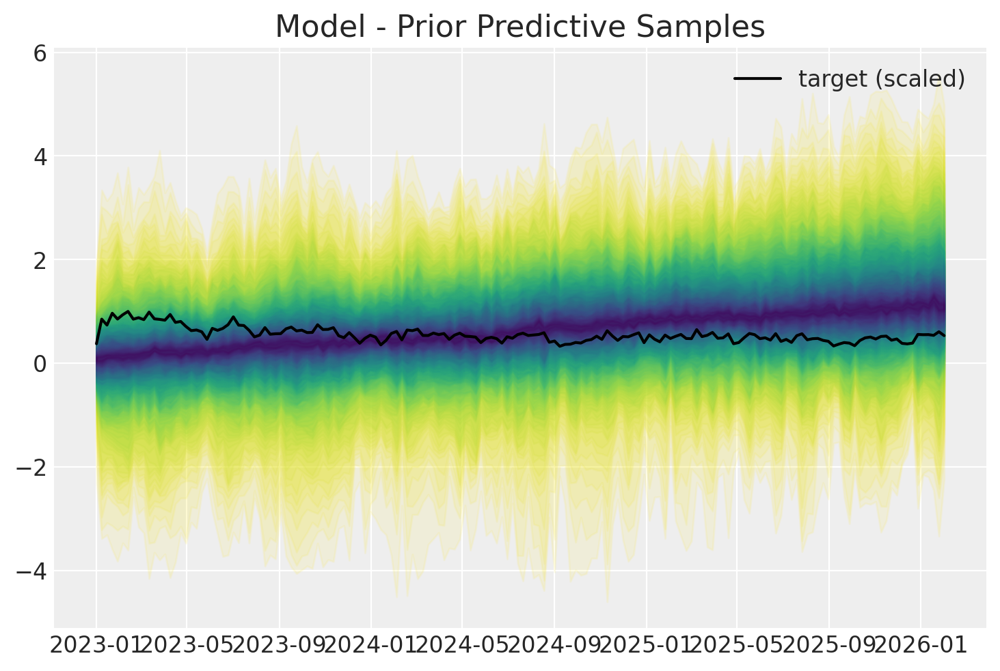

In [49]:
# useful way to color the distribution
palette = "viridis_r"
cmap = plt.get_cmap(palette)
percs = np.linspace(51, 99, 100)
colors = (percs - np.min(percs)) / (np.max(percs) - np.min(percs))


fig, ax = plt.subplots()

for i, p in enumerate(percs[::-1]):
    upper = np.percentile(adstock_saturation_diminshing_model_prior_predictive.prior_predictive["likelihood"], p, axis=1)
    lower = np.percentile(
        adstock_saturation_diminshing_model_prior_predictive.prior_predictive["likelihood"], 100 - p, axis=1
    )
    color_val = colors[i]
    ax.fill_between(
        x=dates,
        y1=upper.flatten(),
        y2=lower.flatten(),
        color=cmap(color_val),
        alpha=0.1,
    )

sns.lineplot(x=dates, y=target_scaled, color="black", label="target (scaled)", ax=ax)
ax.legend()
ax.set(title="Model - Prior Predictive Samples")

### In Sample

In [50]:
with tvp_model:
    diminishing_model_trace = pm.sample(
        nuts_sampler="numpyro",
        draws=2_000,
        target_accept=0.90,
        chains=4,
        idata_kwargs={"log_likelihood": True},
        random_seed=rng
    )
    diminishing_model_posterior_predictive = pm.sample_posterior_predictive(
        trace=diminishing_model_trace,
        random_seed=rng,
        var_names=["likelihood", "lattent_param"],

    )

    diminishing_model_trace.extend(diminishing_model_posterior_predictive)

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

Sampling: [likelihood]


Output()

### Posterior predictive check 

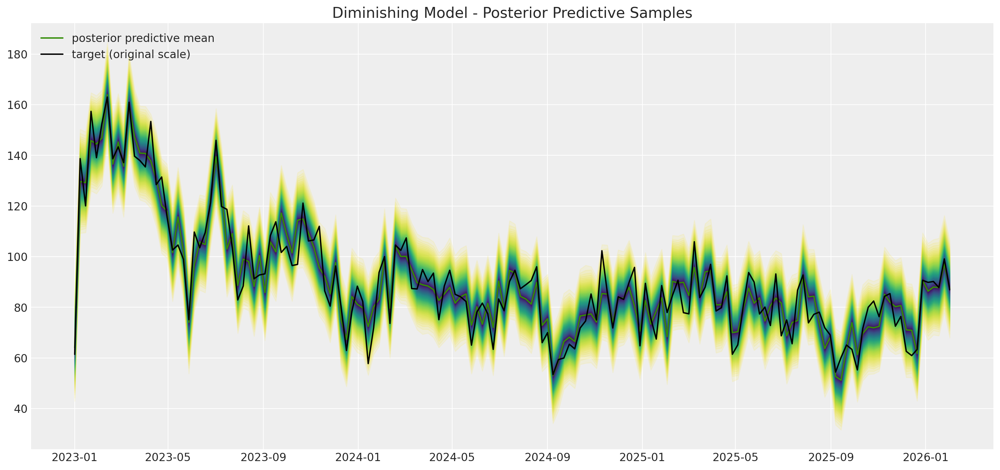

In [51]:
# Use your exact plot code but with base_model_trace instead of combined



posterior_predictive_likelihood = az.extract(
    data=diminishing_model_posterior_predictive,
    group="posterior_predictive",
    var_names="likelihood",
)

posterior_predictive_likelihood_inv = target_scaler.inverse_transform(
    X=posterior_predictive_likelihood
)

fig, ax = plt.subplots(figsize=(15, 7))

for i, p in enumerate(percs[::-1]):
    upper = np.percentile(posterior_predictive_likelihood_inv, p, axis=1)
    lower = np.percentile(posterior_predictive_likelihood_inv, 100 - p, axis=1)
    color_val = colors[i]
    ax.fill_between(
        x=dates,
        y1=upper,
        y2=lower,
        color=cmap(color_val),
        alpha=0.1,
    )

sns.lineplot(
    x=dates,
    y=posterior_predictive_likelihood_inv.mean(axis=1),
    color="C2",
    label="posterior predictive mean",
    ax=ax,
)
sns.lineplot(
    x=dates,
    y=target_train.flatten(),
    color="black",
    label="target (original scale)",
    ax=ax,
)
ax.legend(loc="upper left")
ax.set(title="Diminishing Model - Posterior Predictive Samples");

### Out of sample with carryover 

In [52]:
l_max = 8  # This should match your adstock's l_max parameter

# Combine last l_max training observations with test data
z_combined = np.vstack([z_scaled[-l_max:], z_test_scaled])

# Combine the dates as well
combined_dates = np.concatenate([dataset.date.values[-l_max-test_size:-test_size],
                               dataset.date.values[-test_size:]])

combined_index_scaled = np.concatenate([index_train_scaled[-l_max:None],
                               index_test_scaled])


# Combined t values
t_combined = np.concatenate([t_train[-l_max:], t_test])

# Combined fourier features
fourier_combined = np.vstack([fourier_features[-l_max-test_size:-test_size],
                            fourier_features[-test_size:]])

if target_test_scaled is not None:
    target_combined = np.concatenate([target_scaled[-l_max:], target_test_scaled])
else:
    target_combined = np.concatenate([target_scaled[-l_max:],
                                     np.full(test_size, np.nan)])

# Update model with the combined data
with tvp_model:
    pm.set_data(
        new_data={
            "data": z_combined,
            "t": t_combined,
            "index_scaled_data": combined_index_scaled,
            "fourier_features": fourier_combined
        },
        coords={"date": combined_dates}
    )

    # Generate posterior predictive samples
    combined_posterior_predictive = pm.sample_posterior_predictive(
        trace=diminishing_model_trace,
        var_names=["likelihood","lattent_param"],
        random_seed=rng,
        predictions=True,
        idata_kwargs={"coords": {"date": combined_dates}}
    )

Sampling: [likelihood]


Output()

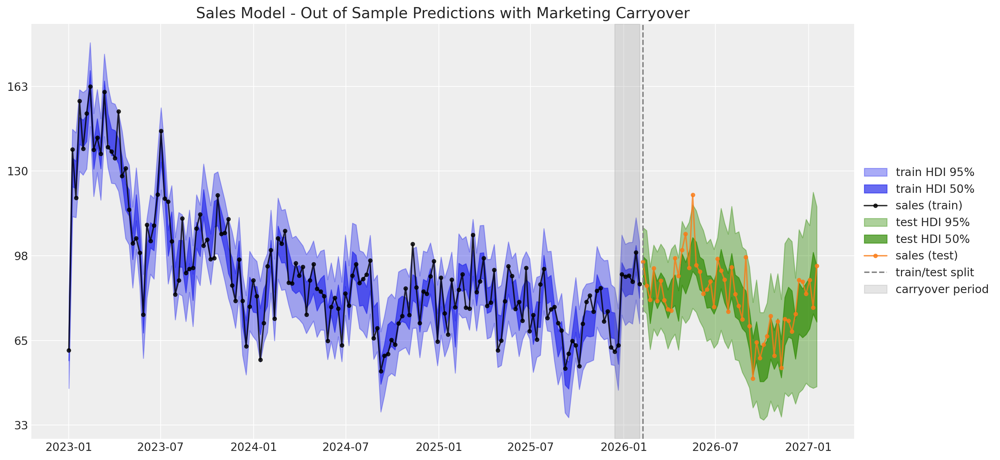

Test Metrics (with carryover effects):
Scaled Space - MAE: 0.0372, RMSE: 0.0493
Original Space - MAE: 6.07, RMSE: 8.04, MAPE: 7.22%


In [53]:
# Use your exact plot code but with base_model_trace instead of combined
fig, ax = plt.subplots(figsize=(15, 7))


# Plot training data predictions and HDI
az.plot_hdi(
    x=dates,
    y=diminishing_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.95,
    color="C0",
    fill_kwargs={"alpha": 0.4, "label": r"train HDI $95\%$"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    x=dates,
    y=diminishing_model_posterior_predictive["posterior_predictive"]["likelihood"],
    hdi_prob=0.5,
    color="C0",
    fill_kwargs={"alpha": 0.7, "label": r"train HDI $50\%$"},
    smooth=False,
    ax=ax,
)
sns.lineplot(
    x=dates,
    y=target_scaled,
    marker="o",
    color="black",
    alpha=0.8,
    markersize=4,
    markeredgecolor="black",
    label="sales (train)",
    ax=ax,
)

# Extract only the test part (skip carryover observations)
test_dates = dataset.date.values[-test_size:]
test_predictions = combined_posterior_predictive["predictions"]["likelihood"].isel(date=slice(l_max, None))

az.plot_hdi(
    x=test_dates,
    y=test_predictions,
    hdi_prob=0.95,
    color="C2",
    fill_kwargs={"alpha": 0.4, "label": r"test HDI $95\%$"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    x=test_dates,
    y=test_predictions,
    hdi_prob=0.5,
    color="C2",
    fill_kwargs={"alpha": 0.7, "label": r"test HDI $50\%$"},
    smooth=False,
    ax=ax,
)
sns.lineplot(
    x=test_dates,
    y=target_test_scaled,
    marker="o",
    color="C1",
    alpha=0.8,
    markersize=4,
    markeredgecolor="C1",
    label="sales (test)",
    ax=ax,
)

# Optional: Add a vertical line at the train/test split
train_test_date = dataset.date.values[-test_size]
ax.axvline(x=train_test_date, color="gray", linestyle="--", label="train/test split")

# Optional: To show carryover period explicitly
carryover_dates = dataset.date.values[-l_max-test_size:-test_size]
ax.axvspan(carryover_dates[0], carryover_dates[-1], alpha=0.2, color='gray', label='carryover period')

# Apply the formatter to show original scale on y-axis
ax.yaxis.set_major_formatter(FuncFormatter(scaled_to_original))

ax.legend(loc="center left", bbox_to_anchor=(1, 0.5))
ax.set_title("Sales Model - Out of Sample Predictions with Marketing Carryover")

plt.tight_layout()
plt.show()

# Display metrics if you have test data
if target_test_scaled is not None:
    # Calculate predictions mean
    test_pred_mean = test_predictions.mean(dim=["chain", "draw"]).values

    # Calculate metrics in scaled space
    from sklearn.metrics import mean_absolute_error, mean_squared_error
    import numpy as np

    mae_scaled = mean_absolute_error(target_test_scaled, test_pred_mean)
    rmse_scaled = np.sqrt(mean_squared_error(target_test_scaled, test_pred_mean))

    # Calculate metrics in original scale
    test_pred_mean_orig = target_scaler.inverse_transform(test_pred_mean.reshape(-1, 1)).flatten()
    target_test_orig = target_scaler.inverse_transform(target_test_scaled.reshape(-1, 1)).flatten()

    mae_orig = mean_absolute_error(target_test_orig, test_pred_mean_orig)
    rmse_orig = np.sqrt(mean_squared_error(target_test_orig, test_pred_mean_orig))
    mape = np.mean(np.abs((target_test_orig - test_pred_mean_orig) / target_test_orig)) * 100

    print(f"Test Metrics (with carryover effects):")
    print(f"Scaled Space - MAE: {mae_scaled:.4f}, RMSE: {rmse_scaled:.4f}")
    print(f"Original Space - MAE: {mae_orig:.2f}, RMSE: {rmse_orig:.2f}, MAPE: {mape:.2f}%")

### Model parameters

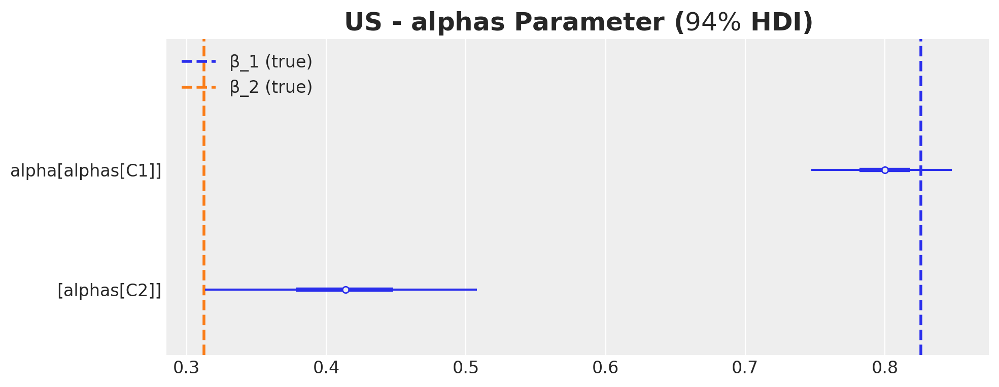

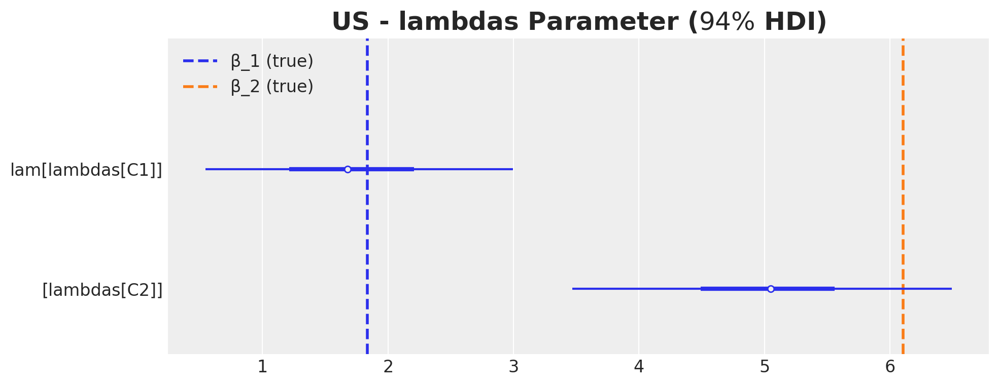

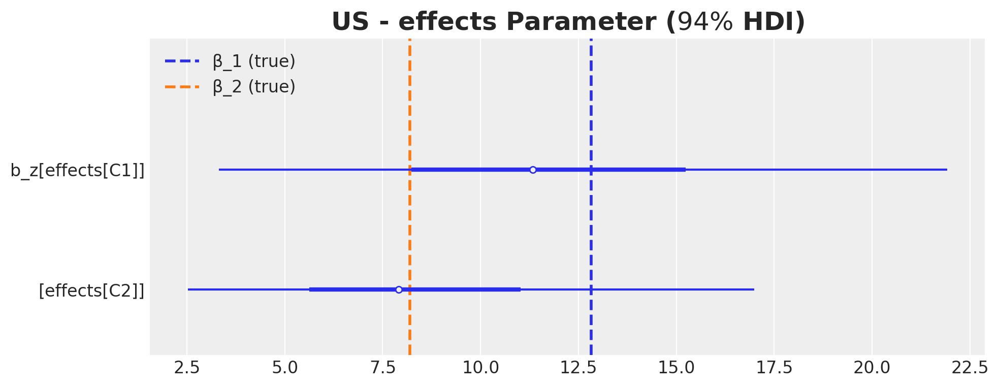

In [54]:
# Initialize single scalers for all countries
channel_scaler = MaxAbsScaler()
target_scaler = MaxAbsScaler()

# Fit scalers on all data
all_spends = dataset.spends.values.reshape(-1, len(channels))  # Flatten across countries and dates
all_targets = dataset.target.values.reshape(-1, 1)  # Flatten across countries and dates

channel_scaler.fit(all_spends)
target_scaler.fit(all_targets)

# Now recover parameters using these global scalers
recovered_params = {}
for country in countries:
    # Scale posteriors using the global scalers
    alphas = diminishing_model_trace.posterior["alpha"]
    lams = diminishing_model_trace.posterior["lam"] / channel_scaler.scale_
    betas = (diminishing_model_trace.posterior["b_z"] *
             target_scaler.scale_) / 10  # Divide by amplitude

    recovered_params[country] = {
        'alphas': alphas,
        'lambdas': lams,
        'effects': betas
    }

# Plot function remains the same
def plot_param_comparison(param_name, recovered_params, country_params, countries, channels):
    fig, axes = plt.subplots(len(countries), 1, figsize=(10, 4*len(countries)))

    for i, country in enumerate(countries):
        ax = axes[i] if len(countries) > 1 else axes
        data = recovered_params[country][param_name]
        param_data = []
        param_names = []

        for j, channel in enumerate(channels):
            param_data.append(data[:,:,j])
            param_names.append(f"{param_name}[C{j+1}]")
            true_val = country_params[country][param_name][channel]
            ax.axvline(true_val, color=f"C{j}", linestyle="--", linewidth=2,
                      label=f"β_{j+1} (true)")

        combined_data = xr.concat(param_data, dim='channel')
        combined_data = combined_data.assign_coords(channel=param_names)

        az.plot_forest(data=combined_data, combined=True, hdi_prob=0.94, ax=ax)
        ax.legend(loc="upper left")
        ax.set_title(label=f"{country} - {param_name} Parameter ($94\\%$ HDI)",
                    fontsize=18, fontweight="bold")

    plt.tight_layout()

# Plot each parameter
for param in ['alphas', 'lambdas', 'effects']:
    plot_param_comparison(param, recovered_params, country_params, countries, channels)

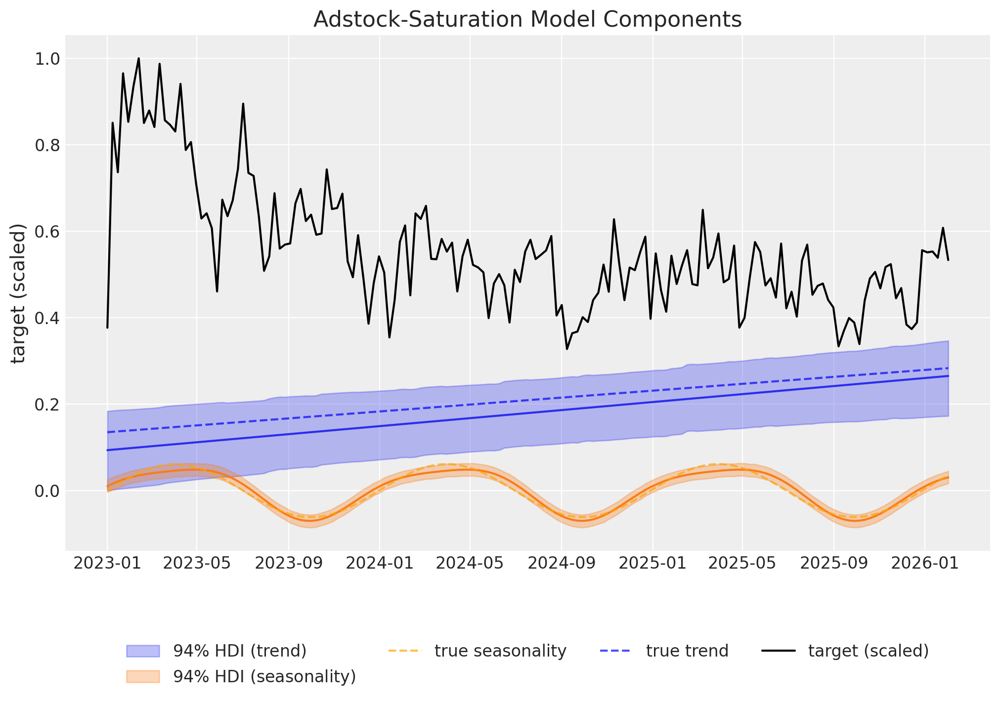

In [55]:
# compute HDI for all the model parameters
model_hdi = az.hdi(ary=diminishing_model_trace)

fig, ax = plt.subplots(figsize=(10,7))

for i, var_effect in enumerate(["trend", "seasonality"]):
    ax.fill_between(
        x=dates,
        y1=model_hdi[var_effect][:, 0],
        y2=model_hdi[var_effect][:, 1],
        color=f"C{i}",
        alpha=0.3,
        label=f"$94\%$ HDI ({var_effect})",
    )
    sns.lineplot(
        x=dates,
        y=diminishing_model_trace.posterior[var_effect]
        .stack(sample=("chain", "draw"))
        .mean(axis=1),
        color=f"C{i}",
    )

true_seasonality = target_scaler.transform(
    dataset.seasonality.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten()

# Plot the true seasonality
sns.lineplot(
    x=dates,
    y=true_seasonality,  # Now properly flattened to 1D
    color="orange",
    alpha=0.7,
    linestyle="--",
    label="true seasonality",
    ax=ax
)


true_trend_and_intercept = target_scaler.transform(
    dataset.trend.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten() + target_scaler.transform(
    dataset.base_sales.sel(country=country)[:-test_size].values.reshape(-1, 1)*10
).flatten()

# Plot the true trend
sns.lineplot(
    x=dates,
    y=true_trend_and_intercept,  # Now properly flattened to 1D
    color="blue",
    alpha=0.7,
    linestyle="--",
    label="true trend",
    ax=ax
)

sns.lineplot(
    x=dates, y=target_scaled, color="black", alpha=1.0, label="target (scaled)", ax=ax
)

ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)



ax.set(
    title="Adstock-Saturation Model Components",
    ylabel="target (scaled)",
);

#### Focus on the time varying parameter

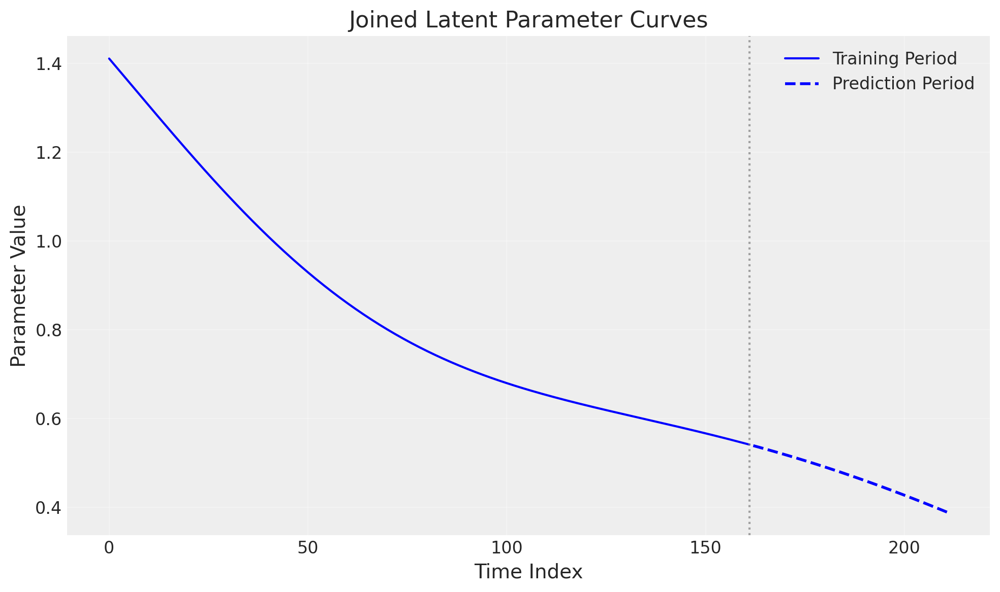

In [56]:
# Get the data from both curves
curve1 = diminishing_model_trace.posterior_predictive["lattent_param"].mean(dim=["chain", "draw"])
curve2 = combined_posterior_predictive.predictions["lattent_param"].mean(dim=["chain", "draw"]).isel(lattent_param_dim_2=slice(l_max, None))

# Create a figure with appropriate size
plt.figure(figsize=(10, 6))

# Plot the first curve
x1 = np.arange(len(curve1))
plt.plot(x1, curve1, 'b-', label='Training Period')

# Plot the extension (second curve)
# Make sure to offset the x values to continue from where curve1 ends
x2 = np.arange(len(curve1), len(curve1) + len(curve2))
plt.plot(x2, curve2, 'b-', linewidth=2, linestyle='--', label='Prediction Period')

# Add a vertical line to show the boundary between training and prediction
plt.axvline(x=len(curve1)-1, color='gray', linestyle=':', alpha=0.7)

# Add labels and title
plt.xlabel('Time Index')
plt.ylabel('Parameter Value')
plt.title('Joined Latent Parameter Curves')
plt.legend()
plt.grid(True, alpha=0.3)

# Show the plot
plt.tight_layout()
plt.show()

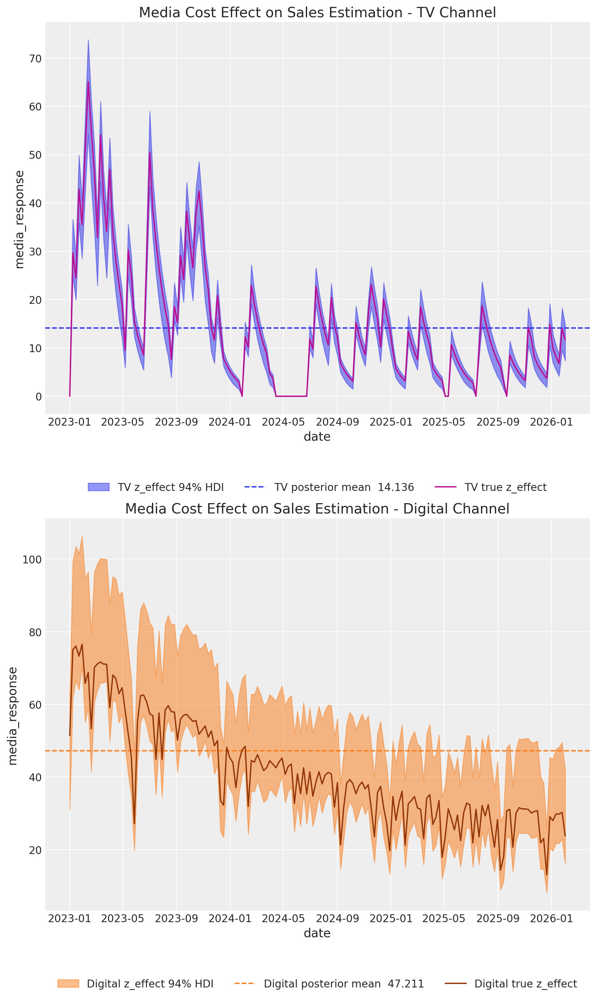

In [57]:
# For multiple channels, we need to handle each channel separately
z_effect_posterior_samples = []

# Loop through each channel
for channel_idx in range(diminishing_model_trace.posterior["z_effect_post_diminishing"].sizes["channel"]):
    # Extract data for this channel
    channel_data = diminishing_model_trace.posterior["z_effect_post_diminishing"].isel(channel=channel_idx)

    # Apply transformation for this channel
    channel_samples = xr.apply_ufunc(
        lambda x: target_scaler.inverse_transform(X=x.reshape(1, -1)),
        channel_data,
        input_core_dims=[["date"]],
        output_core_dims=[["date"]],
        vectorize=True,
    )

    z_effect_posterior_samples.append(channel_samples)

# Combine the results back into a single DataArray with channel dimension
z_effect_posterior_samples = xr.concat(z_effect_posterior_samples, dim="channel")

# Calculate HDI as before
z_effect_hdi = az.hdi(ary=z_effect_posterior_samples)["z_effect_post_diminishing"]

# Plot for each channel
fig, axes = plt.subplots(nrows=len(dataset.channel), figsize=(10, 8*len(dataset.channel)))
if len(dataset.channel) == 1:
    axes = [axes]  # Make it iterable if there's only one subplot

for i, (ax, channel) in enumerate(zip(axes, dataset.channel.values)):
    ax.fill_between(
        x=dataset.date[:-test_size],
        y1=z_effect_hdi.sel(channel=channel)[:, 0],
        y2=z_effect_hdi.sel(channel=channel)[:, 1],
        color=f"C{i}",
        alpha=0.5,
        label=f"{channel} z_effect 94% HDI",
    )
    ax.axhline(
        y=z_effect_posterior_samples.sel(channel=channel).mean(),
        color=f"C{i}",
        linestyle="--",
        label=f"{channel} posterior mean {z_effect_posterior_samples.sel(channel=channel).mean().values: 0.3f}",
    )

    # Plot the original data for this channel
    sns.lineplot(
        x="date",
        y="media_response",
        color=f"C{i+3}",
        data=(dataset.media_response.sel(channel=channel)*10).to_dataframe().reset_index()[:-test_size],
        label=f"{channel} true z_effect",
        ax=ax
    )

    ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=7)
    ax.set(title=f"Media Cost Effect on Sales Estimation - {channel} Channel")

plt.tight_layout()

#### ROAS estimate

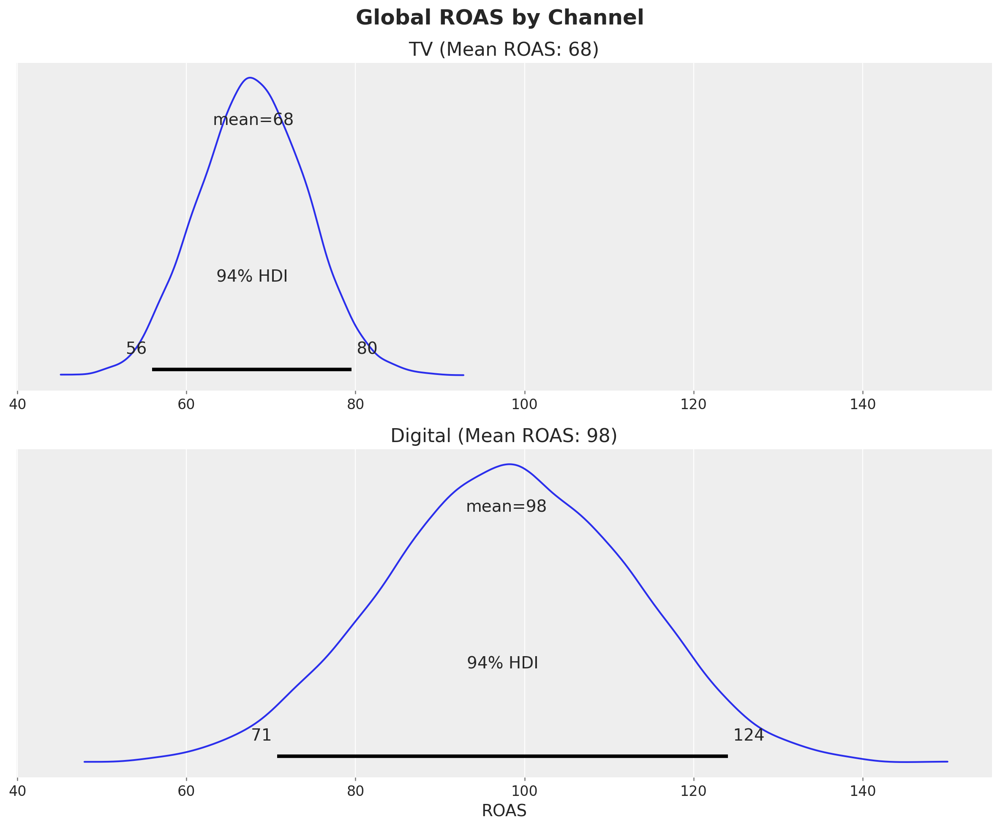

In [ ]:
roas_posterior_samples = {}

# Loop through each channel
for channel in dataset.channel.values:
    # Get media effect samples for this channel
    channel_effect_samples = z_effect_posterior_samples.sel(channel=channel)

    # Get media spending for this channel (excluding test data)
    channel_spending = dataset.spends.sel(channel=channel)[0,:][:-test_size].sum().values

    # Calculate ROAS: total effect / total spend
    # Sum across dates for each draw
    total_effect = channel_effect_samples.sum(dim="date")

    # ROAS = total effect / total spend
    roas_posterior_samples[channel] = total_effect / channel_spending


# Plot the ROAS distributions
num_channels = len(dataset.channel)
fig, axes = plt.subplots(
    nrows=num_channels,
    ncols=1,
    figsize=(12, 5*num_channels),
    sharex=True,
    sharey=False,
    layout="constrained"
)

# Handle single channel case
if num_channels == 1:
    axes = [axes]

# Plot ROAS for each channel
for i, (ax, channel) in enumerate(zip(axes, dataset.channel.values)):
    # Plot posterior distribution of ROAS
    az.plot_posterior(
        roas_posterior_samples[channel],
        # ref_val=ref_roas[channel],  # Uncomment if you have reference values
        ax=ax
    )

    # Set title for subplot
    ax.set(title=f"{channel}")

    # Add mean ROAS value to title
    mean_roas = roas_posterior_samples[channel].mean().values
    ax.set_title(f"{channel} (Mean ROAS: {mean_roas:.0f})")

    # For the last subplot, add x-label
    if i == num_channels - 1:
        ax.set(xlabel="ROAS")

# Add overall title
fig.suptitle("Global ROAS by Channel", fontsize=18, fontweight="bold")

plt.tight_layout()
plt.show()